In [1]:
#Capstone III
#Preprocessing and Modelling 
#Ofri Oren

In [1]:
#imports

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Show plots inline
%matplotlib inline

import datetime as dt
import os
import io 

#!pip install opencv-python
#!pip install tensorflow


#Import neural network tools
#!pip install keras tensorflow
from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten,  MaxPooling2D, Dropout, BatchNormalization
from keras.callbacks import ModelCheckpoint

# Import the necessary modules from scikit-image for image transformation, and exposure adjustment
from skimage.transform import resize, rotate 
from skimage.exposure import equalize_adapthist

#Image imports
import imageio.v3 as imageio
from scipy import ndimage as ndi
from skimage import filters, exposure, transform, morphology, restoration, util, segmentation, measure, feature
from PIL import Image
from skimage.draw import polygon
from matplotlib.patches import Polygon


Loaded image volume shape: (102, 640, 640, 3)


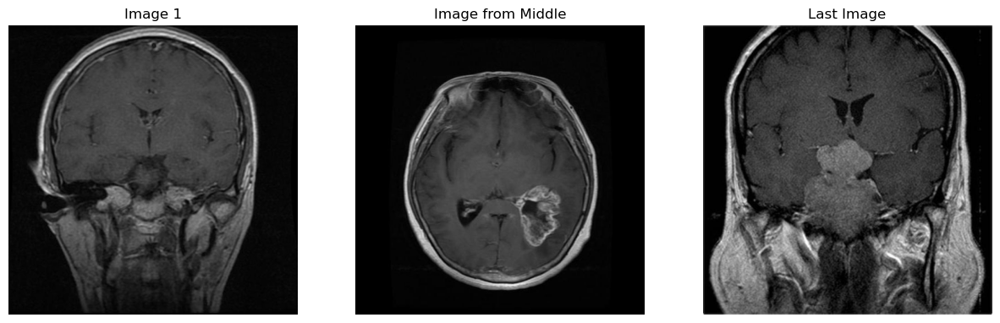

In [2]:
#Here I'm reopening the images from the EDA and looking at them again.

# Path to the folder containing the images
folder_path_images = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/train/images"

# Initialize a list to store image data
volume_train_images = []

# Iterate through the files in the folder
for filename in sorted(os.listdir(folder_path_images)):  # Sort to maintain order
    if filename.endswith(('.jpg', '.jpeg', '.png', '.bmp')):  # Check for valid image files
        filepath_image = os.path.join(folder_path_images, filename)
        try:
            # Open the image using PIL
            img = Image.open(filepath_image).convert('RGB')  # Ensure all images are RGB
            img_array = np.array(img)  # Convert the image to a NumPy array
            volume_train_images.append(img_array)  # Append the image to the list
        except Exception as e:
            print(f"Error loading image {filepath_image}: {e}")

# Convert the list of images into a NumPy array (volume)
try:
    volume_train_images = np.stack(volume_train_images)
    print(f"Loaded image volume shape: {volume_train_images.shape}")  # Expected shape: (number_of_images, height, width, channels)
except ValueError as e:
    print(f"Error stacking images into volume: {e}")

# Display a few images to confirm successful loading
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 3, figsize=(15, 5))
if len(volume_train_images) >= 3:
    axes[0].imshow(volume_train_images[0])
    axes[0].set_title('Image 1')
    axes[1].imshow(volume_train_images[len(volume_train_images) // 2])
    axes[1].set_title('Image from Middle')
    axes[2].imshow(volume_train_images[-1])
    axes[2].set_title('Last Image')
    for ax in axes:
        ax.axis('off')
    plt.show()
else:
    print("Not enough images to display.")

Displaying meningioma47_jpg.rf.ef504a28fd196407fa72365c6c69e93c.jpg with polygons


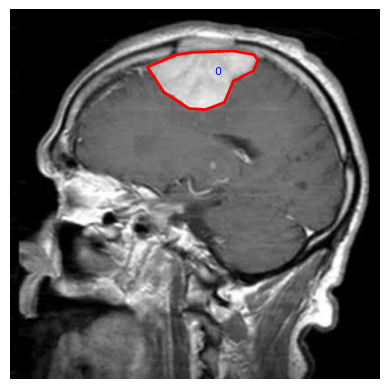

In [3]:
#I have to open the label data which appears to have information about a polygon around the tumor. I just used the same
#process from EDA to make sure everything is still aligned and correct.

def load_polygon_from_file(file_path):
    """Parse a label file to extract polygon points and labels."""
    with open(file_path, 'r') as f:
        lines = f.readlines()
        polygon_points = []
        labels = []
        for line in lines:
            values = line.strip().split(' ')
            coords = list(map(float, values[1:]))
            points = [(coords[i], coords[i + 1]) for i in range(0, len(coords), 2)]
            polygon_points.append(points)
            labels.append(values[0])  # Assuming first value is the label
    return polygon_points, labels


def scale_polygons_to_image(polygons, img_width, img_height):
    """Scale polygons to the image dimensions."""
    scaled_polygons = []
    for poly in polygons:
        scaled_poly = [(x * img_width, y * img_height) for x, y in poly]
        scaled_polygons.append(scaled_poly)
    return scaled_polygons


def plot_polygon_on_image(image_path, polygons, labels=None):
    """Plot polygons on an image."""
    img = Image.open(image_path)
    img_width, img_height = img.size
    plt.imshow(img)
    for i, points in enumerate(polygons):
        polygon = Polygon(points, edgecolor='r', fill=None, linewidth=2)
        plt.gca().add_patch(polygon)
        if labels:
            centroid = np.mean(points, axis=0)
            plt.text(centroid[0], centroid[1], labels[i], color='blue', fontsize=8)
    plt.axis('off')
    plt.show()


# Paths
labels_folder = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/train/labels"
images_folder = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/train/images"

# Iterate through label files
for label_file in os.listdir(labels_folder):
    if label_file.endswith('.txt'):
        # Load polygons and labels
        label_path = os.path.join(labels_folder, label_file)
        polygons, labels = load_polygon_from_file(label_path)
        
        # Find the corresponding image file
        image_file = label_file.replace('.txt', '.jpg')  # Adjust extension as needed
        image_path = os.path.join(images_folder, image_file)
        
        if os.path.exists(image_path):
            # Load image dimensions
            img = Image.open(image_path)
            img_width, img_height = img.size
            
            # Scale polygons to match image dimensions
            scaled_polygons = scale_polygons_to_image(polygons, img_width, img_height)
            
            # Plot polygons on the image
            print(f"Displaying {image_file} with polygons")
            plot_polygon_on_image(image_path, scaled_polygons, labels)
            break  # Display only the first image for examination
        else:
            print(f"Image not found for label file: {label_file}")

In [4]:
#Now I'm going through the label files to create masks from the polygons and to see the shape of the training data.

import os
import numpy as np
from PIL import Image, ImageDraw
import tensorflow as tf

# Paths
labels_folder = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/train/labels"
images_folder = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/train/images"

# Initialize arrays for images and masks
volume_images = []
volume_masks = []

def create_mask_from_polygons(polygons, img_width, img_height):
    """Create a binary mask from polygon coordinates."""
    mask = Image.new('L', (img_width, img_height), 0)  # Create a blank black image
    draw = ImageDraw.Draw(mask)
    for polygon in polygons:
        draw.polygon(polygon, outline=1, fill=1)  # Draw polygons on the mask
    return np.array(mask)

# Iterate through label files
for label_file in sorted(os.listdir(labels_folder)):
    if label_file.endswith('.txt'):  # Check for label files
        # Load polygons and labels
        label_path = os.path.join(labels_folder, label_file)
        polygons, _ = load_polygon_from_file(label_path)
        
        # Find the corresponding image file
        image_file = label_file.replace('.txt', '.jpg')  # Adjust extension as needed
        image_path = os.path.join(images_folder, image_file)
        
        if os.path.exists(image_path):
            # Load the image
            img = Image.open(image_path)
            img_width, img_height = img.size
            img_array = np.array(img)
            
            # Create a mask from the polygons
            mask_array = create_mask_from_polygons(polygons, img_width, img_height)
            
            # Add image and mask to volumes
            volume_images.append(img_array)
            volume_masks.append(mask_array)
        else:
            print(f"Image not found for label file: {label_file}")

# Convert to NumPy arrays
volume_images = np.stack(volume_images)  # Shape: (num_images, height, width, channels)
volume_masks = np.stack(volume_masks)    # Shape: (num_images, height, width)

# Normalize images and masks
volume_images = volume_images / 255.0  # Scale images to [0, 1]
volume_masks = volume_masks.astype('float32')  # Ensure masks are float32

print(f"Image volume shape: {volume_images.shape}")
print(f"Mask volume shape: {volume_masks.shape}")

print("Training dataset prepared.")


Image volume shape: (102, 640, 640, 3)
Mask volume shape: (102, 640, 640)
Training dataset prepared.


Loaded polygons for Te-pi_0259_jpg.rf.54fc8552354c1d581a64963b72fb6e31.txt: [[(0.44140625, 0.583984375), (0.4296875, 0.609375), (0.427734375, 0.6484375), (0.439453125, 0.662109375), (0.46484375, 0.669921875), (0.52734375, 0.6640625), (0.5390625, 0.650390625), (0.533203125, 0.56640625), (0.5390625, 0.515625), (0.525390625, 0.50390625), (0.478515625, 0.501953125), (0.455078125, 0.490234375), (0.443359375, 0.498046875), (0.431640625, 0.529296875), (0.44140625, 0.583984375)]]
Drawing polygon: [(282, 373), (275, 390), (273, 415), (281, 423), (297, 428), (337, 425), (345, 416), (341, 362), (345, 330), (336, 322), (306, 321), (291, 313), (283, 318), (276, 338), (282, 373)]


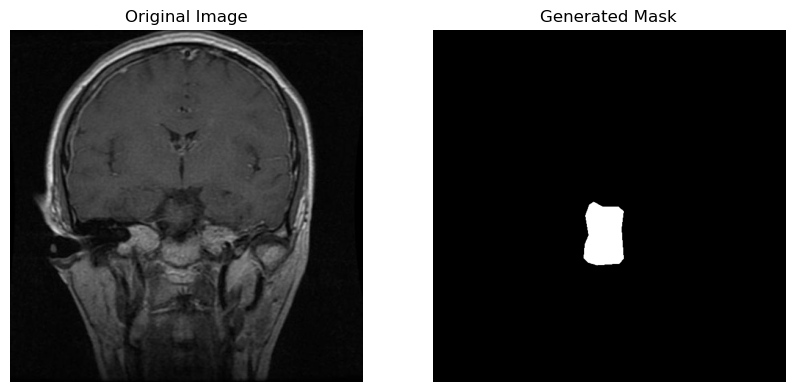

Loaded polygons for Te-pi_0260_jpg.rf.2d91745abd8433b5b043dfbe0f99b35a.txt: [[(0.55078125, 0.572265625), (0.556640625, 0.58203125), (0.580078125, 0.58203125), (0.603515625, 0.5625), (0.611328125, 0.513671875), (0.595703125, 0.490234375), (0.55859375, 0.482421875), (0.541015625, 0.4921875), (0.55078125, 0.517578125), (0.55078125, 0.572265625)]]
Drawing polygon: [(352, 366), (356, 372), (371, 372), (386, 360), (391, 328), (381, 313), (357, 308), (346, 315), (352, 331), (352, 366)]


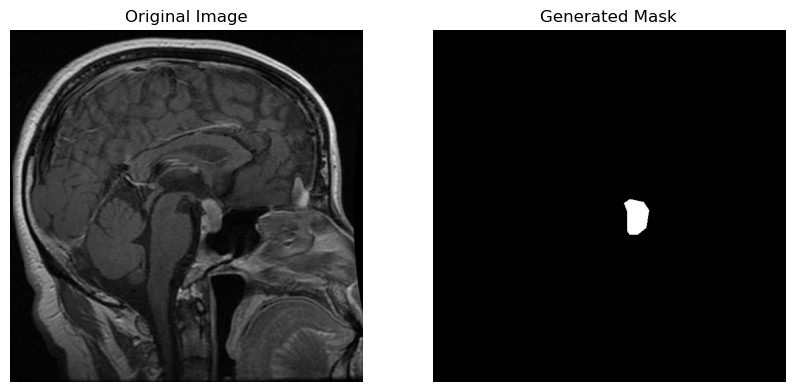

Loaded polygons for Tr-piTr_0000_jpg.rf.a5fdc4ac03409741b9de345b7f578ad0.txt: [[(0.447265625, 0.51171875), (0.451171875, 0.517578125), (0.541015625, 0.521484375), (0.5703125, 0.537109375), (0.5625, 0.421875), (0.541015625, 0.408203125), (0.513671875, 0.40625), (0.451171875, 0.421875), (0.455078125, 0.462890625), (0.447265625, 0.51171875)]]
Drawing polygon: [(286, 327), (288, 331), (346, 333), (365, 343), (360, 270), (346, 261), (328, 260), (288, 270), (291, 296), (286, 327)]


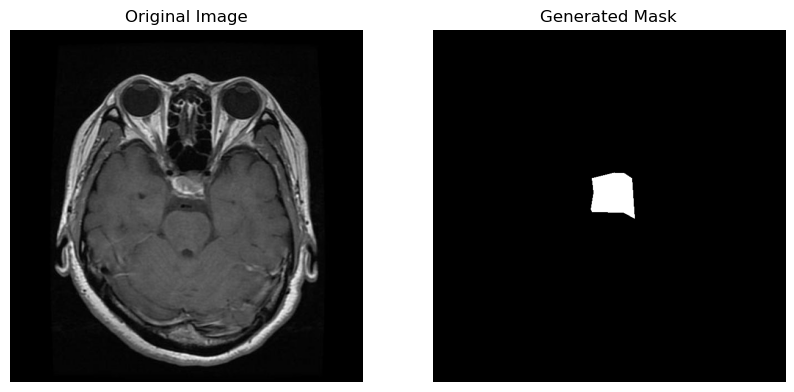

Loaded polygons for Tr-piTr_0002_jpg.rf.6900ad613d1d2278c472b19558290a9e.txt: [[(0.443359375, 0.619140625), (0.431640625, 0.6328125), (0.41796875, 0.685546875), (0.44140625, 0.669921875), (0.45703125, 0.669921875), (0.546875, 0.701171875), (0.537109375, 0.638671875), (0.5390625, 0.5703125), (0.509765625, 0.552734375), (0.48828125, 0.55078125), (0.46484375, 0.55859375), (0.451171875, 0.57421875), (0.443359375, 0.619140625)]]
Drawing polygon: [(283, 396), (276, 405), (267, 438), (282, 428), (292, 428), (350, 448), (343, 408), (345, 365), (326, 353), (312, 352), (297, 357), (288, 367), (283, 396)]


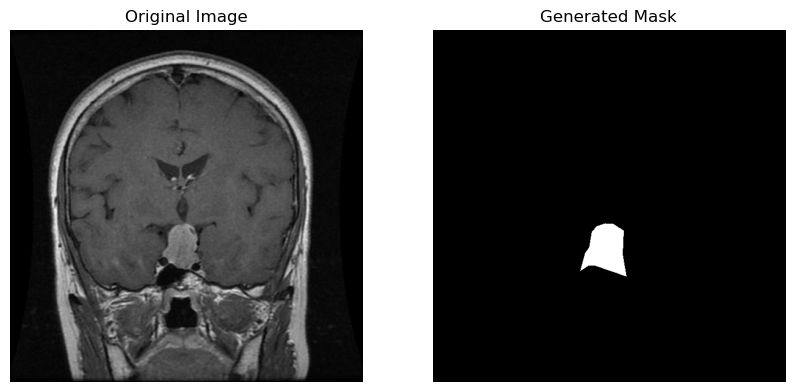

Loaded polygons for Tr-piTr_0003_jpg.rf.c666e364a6c405ab482f193bdf4c6a0d.txt: [[(0.4453125, 0.646484375), (0.490234375, 0.634765625), (0.525390625, 0.640625), (0.541015625, 0.6328125), (0.552734375, 0.615234375), (0.53515625, 0.5234375), (0.517578125, 0.505859375), (0.48046875, 0.5), (0.44921875, 0.517578125), (0.4375, 0.54296875), (0.4453125, 0.646484375)]]
Drawing polygon: [(285, 413), (313, 406), (336, 410), (346, 405), (353, 393), (342, 335), (331, 323), (307, 320), (287, 331), (280, 347), (285, 413)]


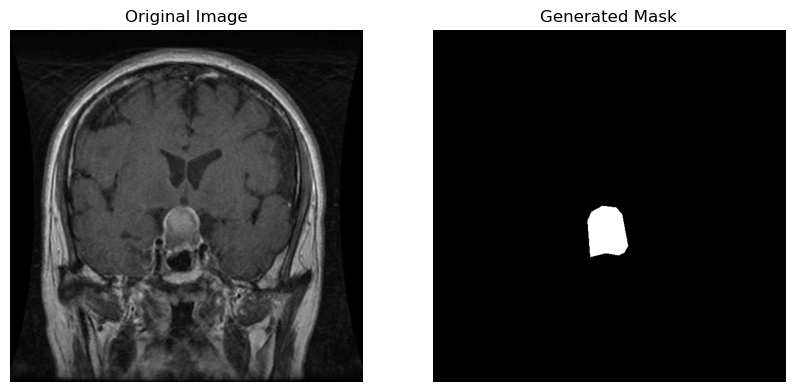

Loaded polygons for Tr-piTr_0006_jpg.rf.0a165c638bbec1b0d959229db9fba43d.txt: [[(0.455078125, 0.580078125), (0.45703125, 0.599609375), (0.521484375, 0.607421875), (0.576171875, 0.58984375), (0.572265625, 0.50390625), (0.556640625, 0.484375), (0.525390625, 0.474609375), (0.486328125, 0.498046875), (0.482421875, 0.544921875), (0.455078125, 0.580078125)]]
Drawing polygon: [(291, 371), (292, 383), (333, 388), (368, 377), (366, 322), (356, 310), (336, 303), (311, 318), (308, 348), (291, 371)]


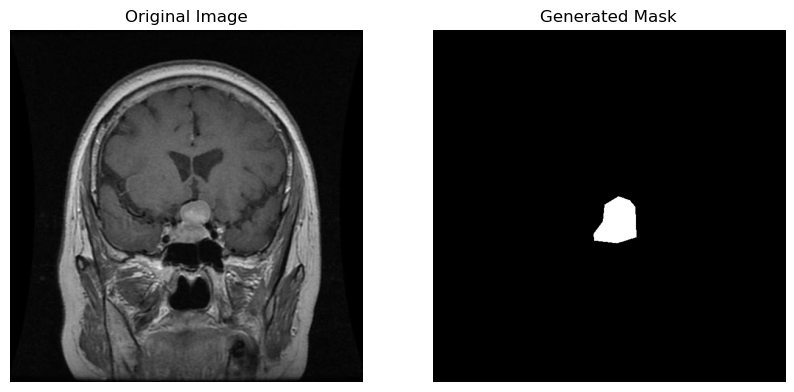

Loaded polygons for Tr-piTr_0007_jpg.rf.1fbeb27590f1a768137e9640456fb000.txt: [[(0.453125, 0.572265625), (0.478515625, 0.58203125), (0.494140625, 0.59765625), (0.53515625, 0.609375), (0.576171875, 0.57421875), (0.57421875, 0.55078125), (0.58203125, 0.529296875), (0.560546875, 0.49609375), (0.517578125, 0.48828125), (0.4765625, 0.5), (0.458984375, 0.51953125), (0.453125, 0.572265625)]]
Drawing polygon: [(290, 366), (306, 372), (316, 382), (342, 390), (368, 367), (367, 352), (372, 338), (358, 317), (331, 312), (305, 320), (293, 332), (290, 366)]


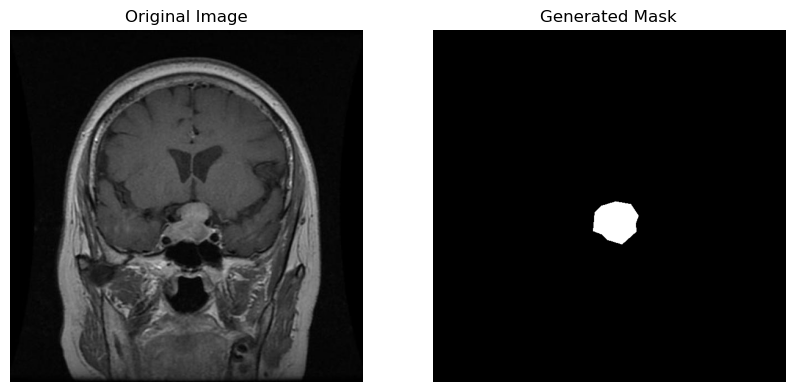

Loaded polygons for Tr-piTr_0008_jpg.rf.74893e49c476fa3850b57ec23d7fc271.txt: [[(0.49609375, 0.533203125), (0.439453125, 0.564453125), (0.416015625, 0.607421875), (0.419921875, 0.619140625), (0.44140625, 0.630859375), (0.455078125, 0.62890625), (0.47265625, 0.62109375), (0.4921875, 0.595703125), (0.51171875, 0.59765625), (0.533203125, 0.61328125), (0.56640625, 0.623046875), (0.59765625, 0.615234375), (0.599609375, 0.5859375), (0.552734375, 0.544921875), (0.55859375, 0.51953125), (0.541015625, 0.5078125), (0.515625, 0.50390625), (0.4921875, 0.515625), (0.5, 0.52734375), (0.49609375, 0.533203125)]]
Drawing polygon: [(317, 341), (281, 361), (266, 388), (268, 396), (282, 403), (291, 402), (302, 397), (315, 381), (327, 382), (341, 392), (362, 398), (382, 393), (383, 375), (353, 348), (357, 332), (346, 325), (330, 322), (315, 330), (320, 337), (317, 341)]


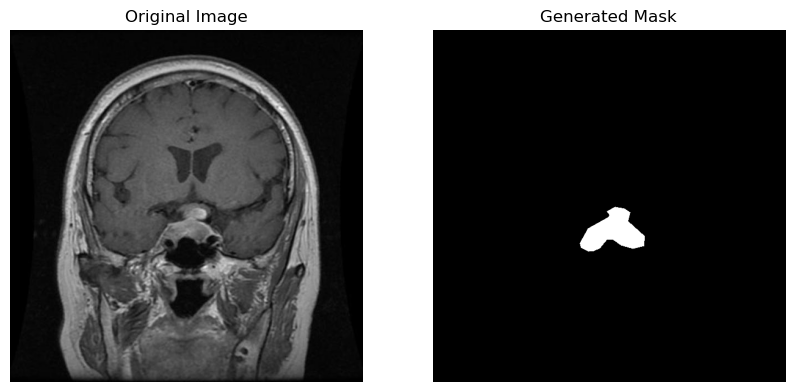

Loaded polygons for Tr-piTr_0009_jpg.rf.5d5024f1ca5e7769e4a52ca5cf6e5c02.txt: [[(0.544921875, 0.556640625), (0.560546875, 0.541015625), (0.56640625, 0.515625), (0.546875, 0.49609375), (0.515625, 0.4921875), (0.501953125, 0.505859375), (0.509765625, 0.53125), (0.544921875, 0.556640625)]]
Drawing polygon: [(348, 356), (358, 346), (362, 330), (350, 317), (330, 315), (321, 323), (326, 340), (348, 356)]


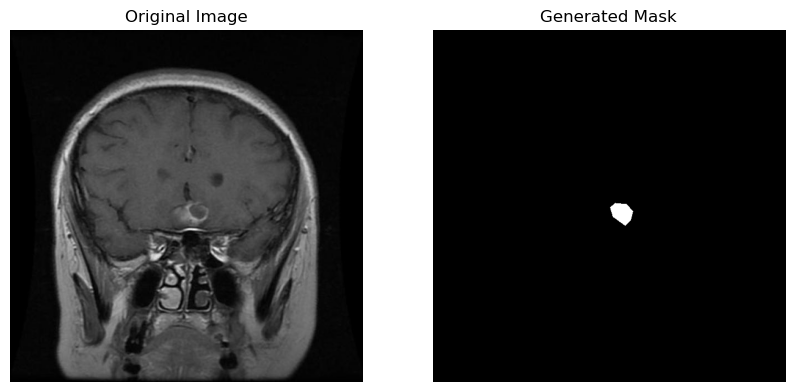

Loaded polygons for Tr-pi_1443_jpg.rf.7b25b18a464c79b3384c8457a3d3d667.txt: [[(0.537109375, 0.61328125), (0.544921875, 0.625), (0.5625, 0.62890625), (0.599609375, 0.623046875), (0.619140625, 0.607421875), (0.6328125, 0.580078125), (0.638671875, 0.544921875), (0.6328125, 0.490234375), (0.609375, 0.470703125), (0.578125, 0.466796875), (0.529296875, 0.484375), (0.515625, 0.517578125), (0.537109375, 0.61328125)]]
Drawing polygon: [(343, 392), (348, 400), (360, 402), (383, 398), (396, 388), (405, 371), (408, 348), (405, 313), (390, 301), (370, 298), (338, 310), (330, 331), (343, 392)]


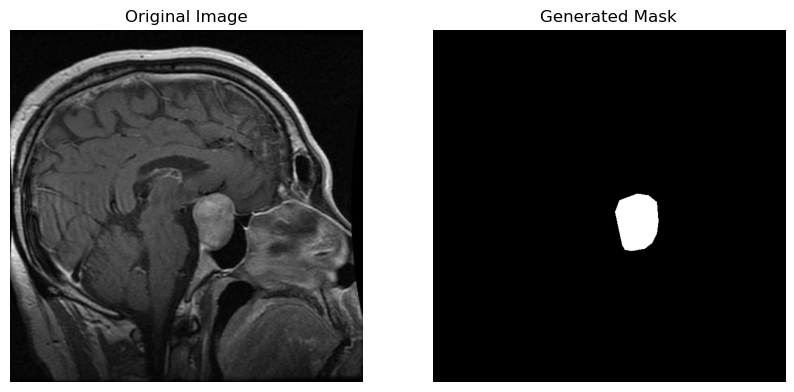

Loaded polygons for Tr-pi_1445_jpg.rf.d7a34bb5dc65ee05ed36e34d5befd708.txt: [[(0.5703125, 0.65625), (0.58203125, 0.689453125), (0.630859375, 0.693359375), (0.646484375, 0.681640625), (0.654296875, 0.662109375), (0.650390625, 0.576171875), (0.63671875, 0.55078125), (0.595703125, 0.54296875), (0.54296875, 0.607421875), (0.537109375, 0.638671875), (0.5703125, 0.65625)]]
Drawing polygon: [(365, 420), (372, 441), (403, 443), (413, 436), (418, 423), (416, 368), (407, 352), (381, 347), (347, 388), (343, 408), (365, 420)]


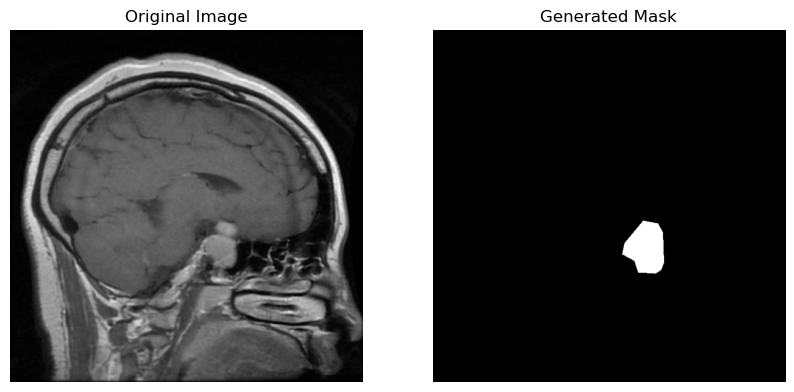

Loaded polygons for Tr-pi_1447_jpg.rf.78e0720477985c74f2a69e809c18f5dd.txt: [[(0.548828125, 0.63671875), (0.5546875, 0.685546875), (0.591796875, 0.703125), (0.638671875, 0.689453125), (0.65234375, 0.6640625), (0.64453125, 0.63671875), (0.650390625, 0.55859375), (0.630859375, 0.5390625), (0.599609375, 0.53515625), (0.583984375, 0.541015625), (0.568359375, 0.5625), (0.548828125, 0.63671875)]]
Drawing polygon: [(351, 407), (355, 438), (378, 450), (408, 441), (417, 425), (412, 407), (416, 357), (403, 345), (383, 342), (373, 346), (363, 360), (351, 407)]


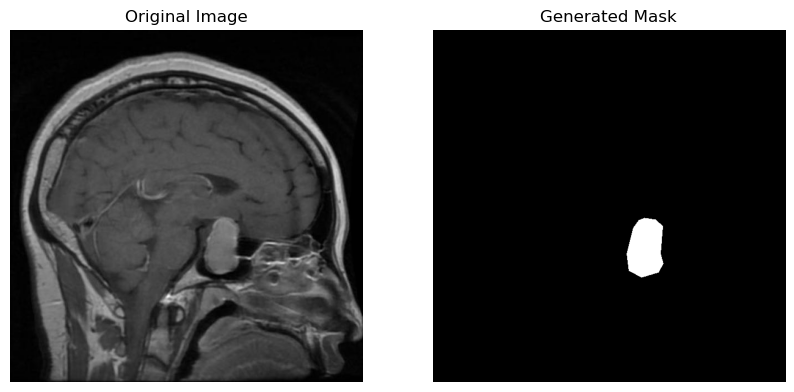

Loaded polygons for Tr-pi_1448_jpg.rf.4d0ce628e4c8e18fc29e14f3b4ac97b4.txt: [[(0.544921875, 0.677734375), (0.576171875, 0.69140625), (0.634765625, 0.68359375), (0.6484375, 0.669921875), (0.640625, 0.640625), (0.65234375, 0.58984375), (0.646484375, 0.55859375), (0.630859375, 0.54296875), (0.599609375, 0.5390625), (0.568359375, 0.556640625), (0.541015625, 0.650390625), (0.544921875, 0.677734375)]]
Drawing polygon: [(348, 433), (368, 442), (406, 437), (415, 428), (410, 410), (417, 377), (413, 357), (403, 347), (383, 345), (363, 356), (346, 416), (348, 433)]


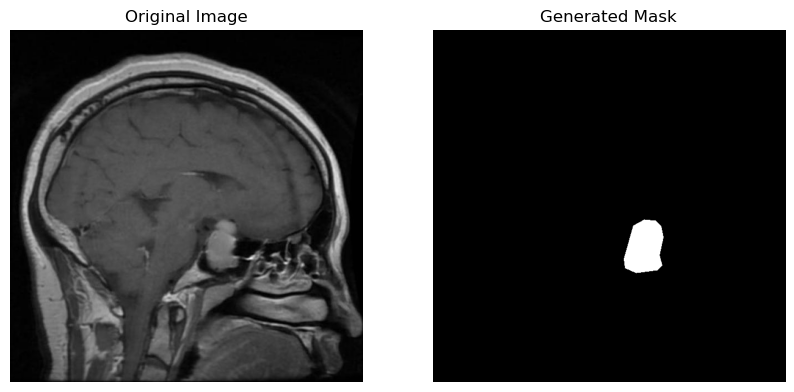

Loaded polygons for Tr-pi_1449_jpg.rf.402e03c9773e9f9960a6ad44a3dc9db0.txt: [[(0.5625, 0.626953125), (0.58203125, 0.669921875), (0.595703125, 0.68359375), (0.609375, 0.685546875), (0.62890625, 0.646484375), (0.630859375, 0.6171875), (0.642578125, 0.60546875), (0.6171875, 0.576171875), (0.587890625, 0.572265625), (0.57421875, 0.576171875), (0.5625, 0.591796875), (0.5625, 0.626953125)]]
Drawing polygon: [(360, 401), (372, 428), (381, 437), (390, 438), (402, 413), (403, 395), (411, 387), (395, 368), (376, 366), (367, 368), (360, 378), (360, 401)]


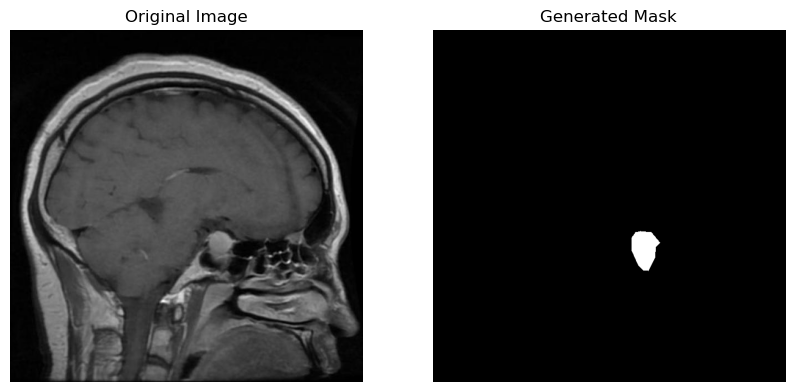

Loaded polygons for Tr-pi_1452_jpg.rf.1309a069a026dc94029227e46601888a.txt: [[(0.451171875, 0.5078125), (0.470703125, 0.537109375), (0.494140625, 0.537109375), (0.521484375, 0.515625), (0.544921875, 0.515625), (0.55859375, 0.49609375), (0.55859375, 0.482421875), (0.537109375, 0.44140625), (0.521484375, 0.431640625), (0.49609375, 0.4296875), (0.46875, 0.44140625), (0.458984375, 0.455078125), (0.451171875, 0.5078125)]]
Drawing polygon: [(288, 325), (301, 343), (316, 343), (333, 330), (348, 330), (357, 317), (357, 308), (343, 282), (333, 276), (317, 275), (300, 282), (293, 291), (288, 325)]


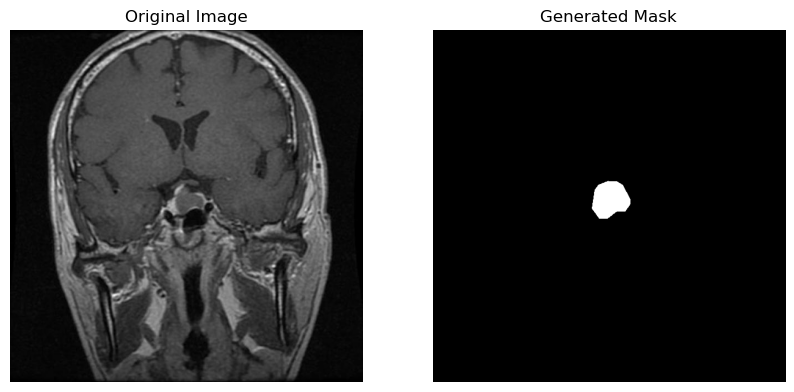

Loaded polygons for Tr-pi_1453_jpg.rf.d27609b294f45a3df37fca8278c887a3.txt: [[(0.44140625, 0.560546875), (0.45703125, 0.568359375), (0.4609375, 0.611328125), (0.501953125, 0.638671875), (0.521484375, 0.638671875), (0.5390625, 0.62890625), (0.564453125, 0.583984375), (0.583984375, 0.578125), (0.59375, 0.56640625), (0.5859375, 0.50390625), (0.5625, 0.482421875), (0.54296875, 0.478515625), (0.44921875, 0.48828125), (0.42578125, 0.51171875), (0.44140625, 0.560546875)]]
Drawing polygon: [(282, 358), (292, 363), (295, 391), (321, 408), (333, 408), (345, 402), (361, 373), (373, 370), (380, 362), (375, 322), (360, 308), (347, 306), (287, 312), (272, 327), (282, 358)]


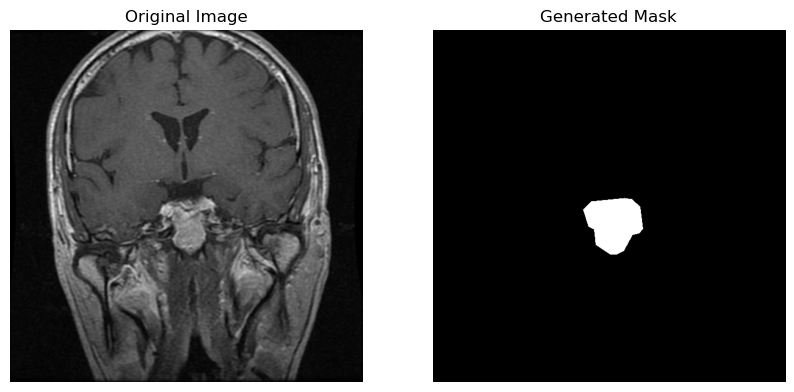

Loaded polygons for Tr-pi_1454_jpg.rf.62d6ecc2fac73476c8d479d7a5f6ff83.txt: [[(0.431640625, 0.5625), (0.451171875, 0.626953125), (0.50390625, 0.658203125), (0.51953125, 0.658203125), (0.578125, 0.62109375), (0.587890625, 0.611328125), (0.59765625, 0.544921875), (0.568359375, 0.529296875), (0.51171875, 0.54296875), (0.439453125, 0.541015625), (0.431640625, 0.5625)]]
Drawing polygon: [(276, 360), (288, 401), (322, 421), (332, 421), (370, 397), (376, 391), (382, 348), (363, 338), (327, 347), (281, 346), (276, 360)]


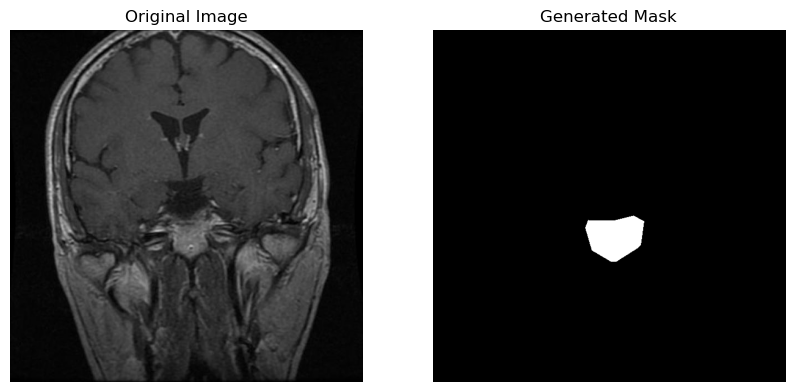

Loaded polygons for Tr-pi_1455_jpg.rf.077a48ae4a404b51afef93df0453e5dd.txt: [[(0.421875, 0.53125), (0.431640625, 0.55859375), (0.494140625, 0.568359375), (0.56640625, 0.529296875), (0.56640625, 0.494140625), (0.54296875, 0.46484375), (0.466796875, 0.455078125), (0.4296875, 0.466796875), (0.421875, 0.478515625), (0.421875, 0.53125)]]
Drawing polygon: [(270, 340), (276, 357), (316, 363), (362, 338), (362, 316), (347, 297), (298, 291), (275, 298), (270, 306), (270, 340)]


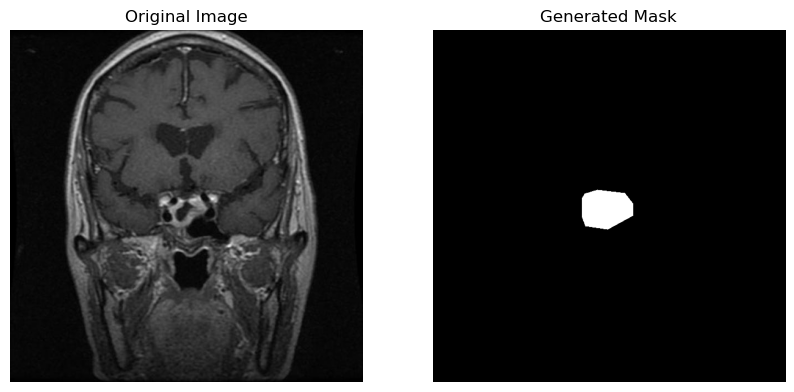

Loaded polygons for glioma10_jpg.rf.b31df39ef23a2ac7ef8a5515ad8fa18b.txt: [[(0.6640625, 0.6220703125), (0.673828125, 0.5986328125), (0.6494140625, 0.591796875), (0.5869140625, 0.59765625), (0.5556640625, 0.609375), (0.552734375, 0.6162109375), (0.58984375, 0.6669921875), (0.60546875, 0.7216796875), (0.6259765625, 0.7421875), (0.642578125, 0.7412109375), (0.6650390625, 0.732421875), (0.6875, 0.7060546875), (0.6875, 0.6494140625), (0.6640625, 0.6220703125)]]
Drawing polygon: [(425, 398), (431, 383), (415, 378), (375, 382), (355, 390), (353, 394), (377, 426), (387, 461), (400, 475), (411, 474), (425, 468), (440, 451), (440, 415), (425, 398)]


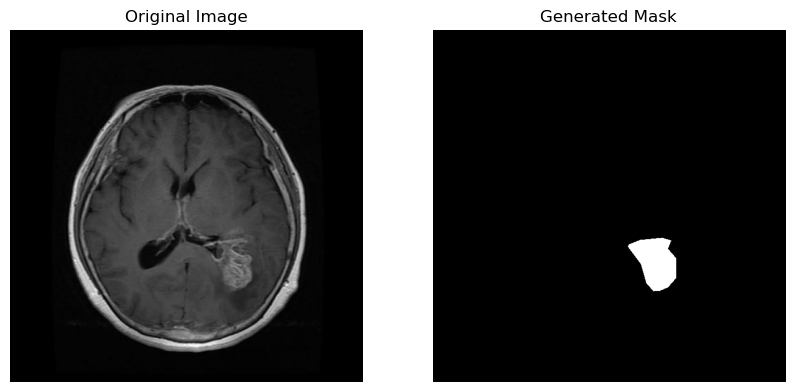

Loaded polygons for glioma11_jpg.rf.30548dde13c3a43a2e391d0842fa162f.txt: [[(0.283203125, 0.6416015625), (0.283203125, 0.6748046875), (0.3046875, 0.6787109375), (0.33203125, 0.6591796875), (0.3310546875, 0.6328125), (0.2900390625, 0.6328125), (0.283203125, 0.6416015625)]]
Drawing polygon: [(181, 410), (181, 431), (195, 434), (212, 421), (211, 405), (185, 405), (181, 410)]


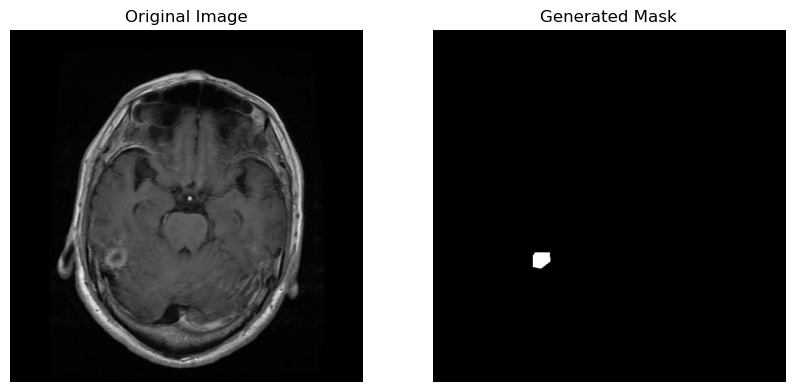

Loaded polygons for glioma13_jpg.rf.7dbb8d1588cf2a458f2113d4c9fb1463.txt: [[(0.3037109375, 0.6015625), (0.28125, 0.6201171875), (0.28125, 0.6650390625), (0.2880859375, 0.681640625), (0.31640625, 0.6845703125), (0.333984375, 0.6650390625), (0.337890625, 0.6279296875), (0.3232421875, 0.607421875), (0.3037109375, 0.6015625)], [(0.578125, 0.2841796875), (0.5576171875, 0.26953125), (0.5009765625, 0.26953125), (0.486328125, 0.2880859375), (0.4921875, 0.2958984375), (0.484375, 0.2978515625), (0.4921875, 0.3251953125), (0.5, 0.3291015625), (0.5009765625, 0.341796875), (0.5263671875, 0.345703125), (0.515625, 0.3486328125), (0.5263671875, 0.359375), (0.54296875, 0.3583984375), (0.5634765625, 0.35546875), (0.564453125, 0.3466796875), (0.578125, 0.3408203125), (0.578125, 0.2841796875)]]
Drawing polygon: [(194, 385), (180, 396), (180, 425), (184, 436), (202, 438), (213, 425), (216, 401), (206, 388), (194, 385)]
Drawing polygon: [(370, 181), (356, 172), (320, 172), (311, 184), (315, 189), (310, 190)

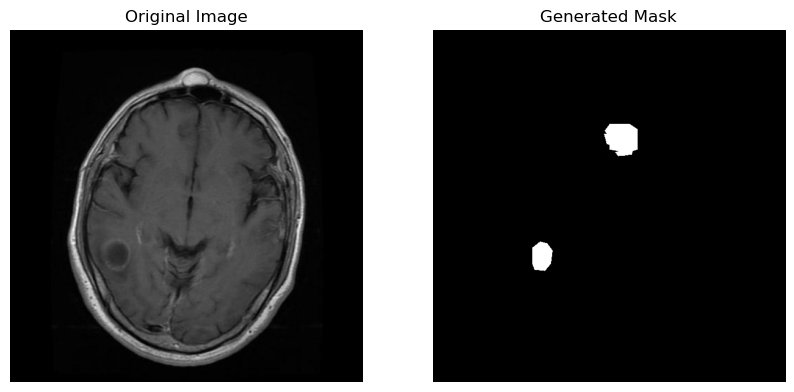

Loaded polygons for glioma14_jpg.rf.459f6c43a38aa75d330fb75c991c18f3.txt: [[(0.4287109375, 0.443359375), (0.3955078125, 0.443359375), (0.37109375, 0.4560546875), (0.373046875, 0.5068359375), (0.3798828125, 0.515625), (0.3935546875, 0.509765625), (0.443359375, 0.5146484375), (0.4580078125, 0.51171875), (0.466796875, 0.4912109375), (0.4560546875, 0.453125), (0.4287109375, 0.443359375)]]
Drawing polygon: [(274, 283), (253, 283), (237, 291), (238, 324), (243, 330), (251, 326), (283, 329), (293, 327), (298, 314), (291, 290), (274, 283)]


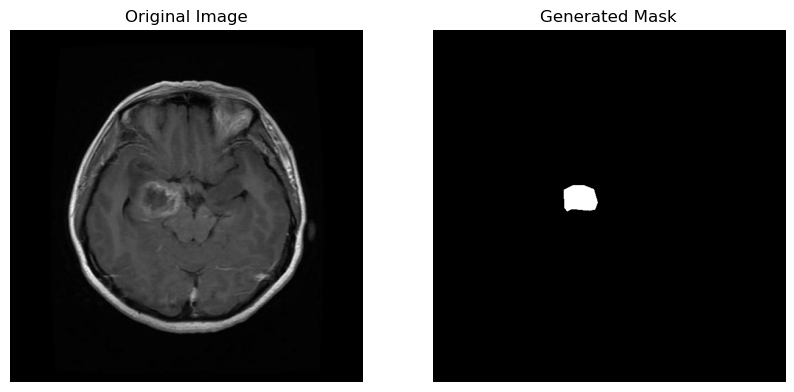

Loaded polygons for glioma16_jpg.rf.304494a01d6f9b34a425e825dc50fe9d.txt: [[(0.2978515625, 0.50390625), (0.30078125, 0.5126953125), (0.28515625, 0.5224609375), (0.28125, 0.5341796875), (0.287109375, 0.5751953125), (0.333984375, 0.5830078125), (0.3515625, 0.5537109375), (0.35546875, 0.5205078125), (0.3447265625, 0.5078125), (0.2978515625, 0.50390625)]]
Drawing polygon: [(190, 322), (192, 328), (182, 334), (180, 341), (183, 368), (213, 373), (225, 354), (227, 333), (220, 325), (190, 322)]


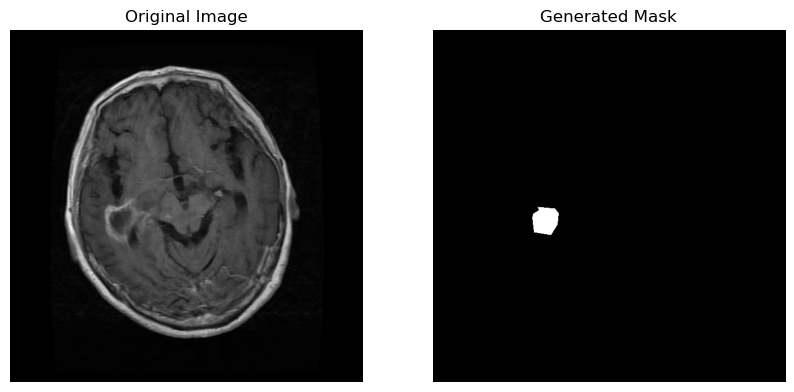

Loaded polygons for glioma17_jpg.rf.16fb88390536e6d58c97bc3fb6f01d0b.txt: [[(0.4267578125, 0.5703125), (0.443359375, 0.5517578125), (0.4453125, 0.5322265625), (0.4384765625, 0.525390625), (0.4052734375, 0.52734375), (0.3935546875, 0.501953125), (0.3681640625, 0.498046875), (0.3466796875, 0.47265625), (0.3330078125, 0.47265625), (0.2998046875, 0.517578125), (0.2626953125, 0.490234375), (0.2509765625, 0.490234375), (0.244140625, 0.5185546875), (0.25, 0.5537109375), (0.3056640625, 0.62890625), (0.341796875, 0.6357421875), (0.3603515625, 0.607421875), (0.3779296875, 0.603515625), (0.3896484375, 0.5859375), (0.4267578125, 0.5703125)]]
Drawing polygon: [(273, 365), (283, 353), (285, 340), (280, 336), (259, 337), (251, 321), (235, 318), (221, 302), (213, 302), (191, 331), (168, 313), (160, 313), (156, 331), (160, 354), (195, 402), (218, 406), (230, 388), (241, 386), (249, 375), (273, 365)]


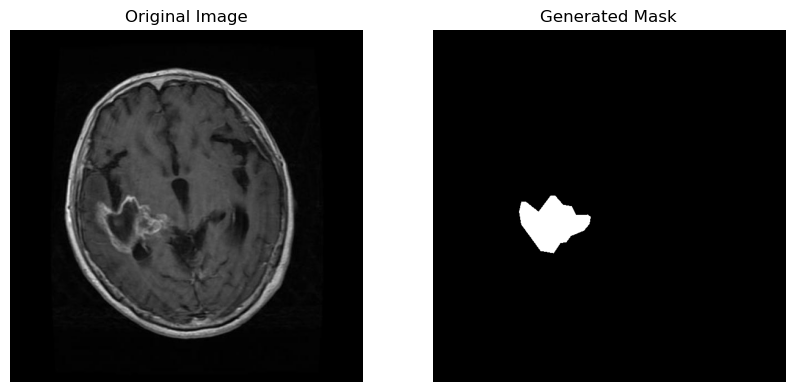

Loaded polygons for glioma19_jpg.rf.994c50c05289911f4155d56aba8e0910.txt: [[(0.4228515625, 0.5703125), (0.458984375, 0.5654296875), (0.4521484375, 0.51953125), (0.4150390625, 0.521484375), (0.3857421875, 0.505859375), (0.3408203125, 0.501953125), (0.3310546875, 0.548828125), (0.3154296875, 0.5390625), (0.3076171875, 0.546875), (0.291015625, 0.5419921875), (0.296875, 0.5615234375), (0.314453125, 0.5712890625), (0.3291015625, 0.609375), (0.373046875, 0.6181640625), (0.3857421875, 0.603515625), (0.4130859375, 0.59765625), (0.40234375, 0.5888671875), (0.4228515625, 0.5703125)]]
Drawing polygon: [(270, 365), (293, 361), (289, 332), (265, 333), (246, 323), (218, 321), (211, 351), (201, 345), (196, 350), (186, 346), (190, 359), (201, 365), (210, 390), (238, 395), (246, 386), (264, 382), (257, 376), (270, 365)]


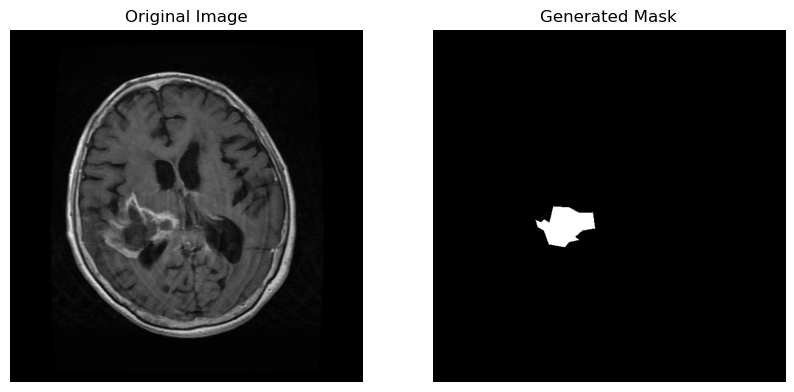

Loaded polygons for glioma1_jpg.rf.94c43e4b82ab59c7da13aebd3c6be045.txt: [[(0.65625, 0.6025390625), (0.6640625, 0.5791015625), (0.666015625, 0.4833984375), (0.6513671875, 0.45703125), (0.6201171875, 0.443359375), (0.6005859375, 0.443359375), (0.5693359375, 0.462890625), (0.5166015625, 0.46484375), (0.482421875, 0.4814453125), (0.46875, 0.5615234375), (0.474609375, 0.5986328125), (0.5009765625, 0.630859375), (0.5234375, 0.6396484375), (0.5517578125, 0.634765625), (0.5888671875, 0.607421875), (0.6142578125, 0.62109375), (0.65625, 0.6025390625)]]
Drawing polygon: [(420, 385), (425, 370), (426, 309), (416, 292), (396, 283), (384, 283), (364, 296), (330, 297), (308, 308), (300, 359), (303, 383), (320, 403), (335, 409), (353, 406), (376, 388), (393, 397), (420, 385)]


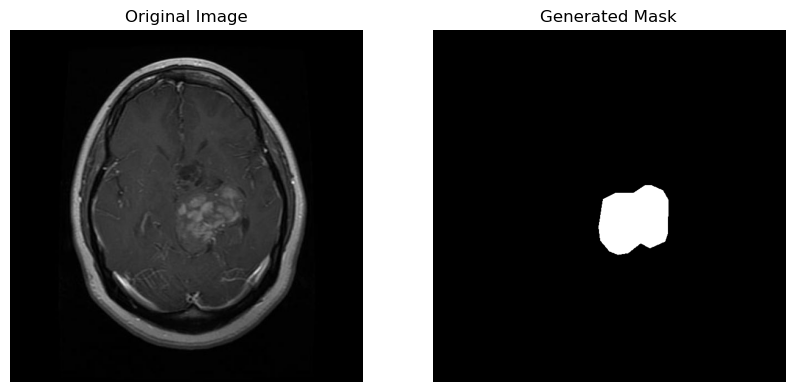

Loaded polygons for glioma21_jpg.rf.81cb7437a80bdbb7890280f6d04a5934.txt: [[(0.3720703125, 0.53125), (0.3564453125, 0.533203125), (0.3515625, 0.5693359375), (0.3359375, 0.6064453125), (0.322265625, 0.6162109375), (0.326171875, 0.6337890625), (0.3984375, 0.6396484375), (0.404296875, 0.6337890625), (0.396484375, 0.6044921875), (0.3984375, 0.5498046875), (0.3720703125, 0.53125)]]
Drawing polygon: [(238, 340), (228, 341), (225, 364), (215, 388), (206, 394), (208, 405), (255, 409), (258, 405), (253, 386), (255, 351), (238, 340)]


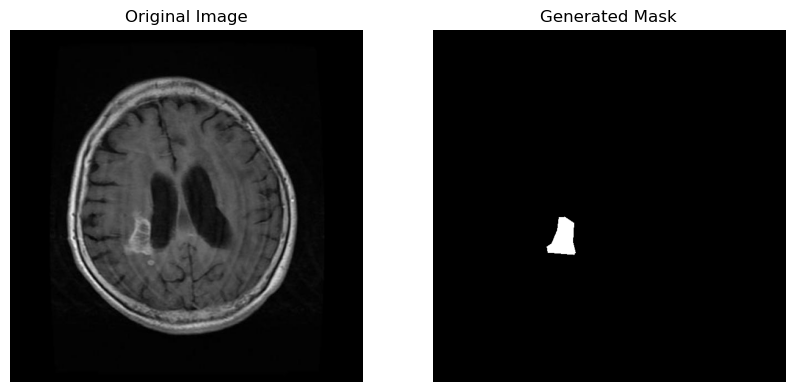

Loaded polygons for glioma25_jpg.rf.8179907cc9ad8b7bb1ee773cfd06160a.txt: [[(0.61328125, 0.4697265625), (0.6005859375, 0.458984375), (0.5712890625, 0.45703125), (0.548828125, 0.4775390625), (0.5546875, 0.4853515625), (0.54296875, 0.5068359375), (0.5348557703125, 0.5709134609375), (0.56640625, 0.5712890625), (0.59765625, 0.5576171875), (0.611328125, 0.5244140625), (0.6171875, 0.4853515625), (0.61328125, 0.4697265625)]]
Drawing polygon: [(392, 300), (384, 293), (365, 292), (351, 305), (355, 310), (347, 324), (342, 365), (362, 365), (382, 356), (391, 335), (395, 310), (392, 300)]


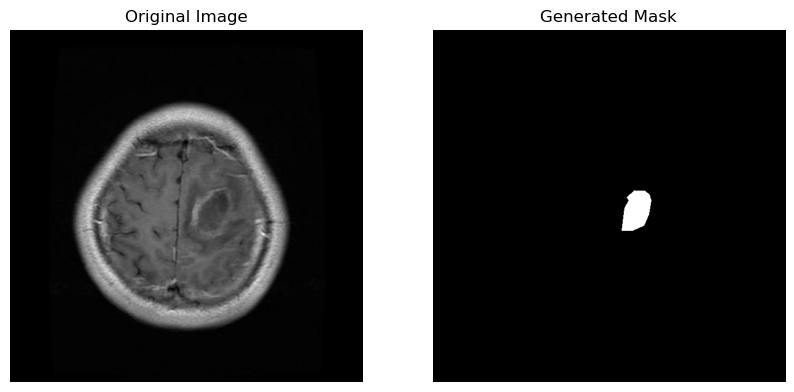

Loaded polygons for glioma26_jpg.rf.54dfe5087426894fdbd64e71deda2453.txt: [[(0.6698467546875, 0.515775240625), (0.6551983171875, 0.548001803125), (0.6581280046875, 0.564603365625), (0.6805889421875, 0.571439303125), (0.7108623796875, 0.564603365625), (0.7512019234375, 0.5228365390625), (0.6932842546875, 0.513822115625), (0.6698467546875, 0.515775240625)]]
Drawing polygon: [(428, 330), (419, 350), (421, 361), (435, 365), (454, 361), (480, 334), (443, 328), (428, 330)]


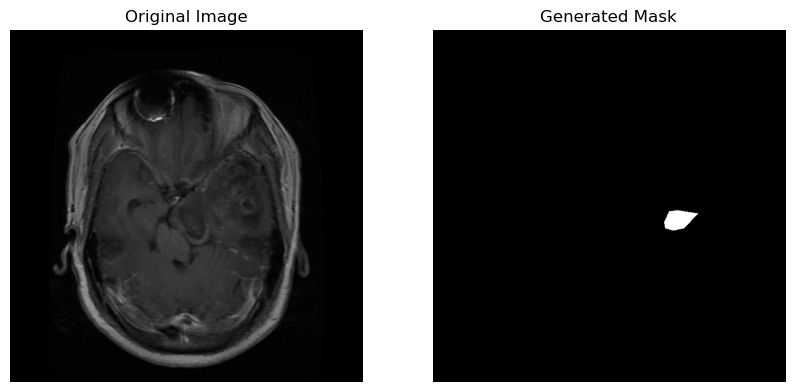

Loaded polygons for glioma27_jpg.rf.6ae20eaed528857606aef521befe2219.txt: [[(0.4921875, 0.2861328125), (0.4541015625, 0.2421875), (0.4208984375, 0.240234375), (0.384765625, 0.2705078125), (0.39453125, 0.2958984375), (0.38671875, 0.3369140625), (0.404296875, 0.3466796875), (0.4521484375, 0.337890625), (0.4931640625, 0.31640625), (0.5, 0.3056640625), (0.4921875, 0.2861328125)], [(0.3095703125, 0.345703125), (0.302734375, 0.3701171875), (0.3095703125, 0.376953125), (0.3359375, 0.3779296875), (0.34765625, 0.3662109375), (0.34765625, 0.3466796875), (0.3330078125, 0.337890625), (0.3095703125, 0.345703125)], [(0.6728515625, 0.384765625), (0.6396484375, 0.37890625), (0.625, 0.3876953125), (0.615234375, 0.4189453125), (0.638671875, 0.4658203125), (0.654296875, 0.4658203125), (0.654296875, 0.4404296875), (0.7021484375, 0.42578125), (0.7109375, 0.4091796875), (0.6728515625, 0.384765625)]]
Drawing polygon: [(315, 183), (290, 155), (269, 153), (246, 173), (252, 189), (247, 215), (258, 221), (289, 2

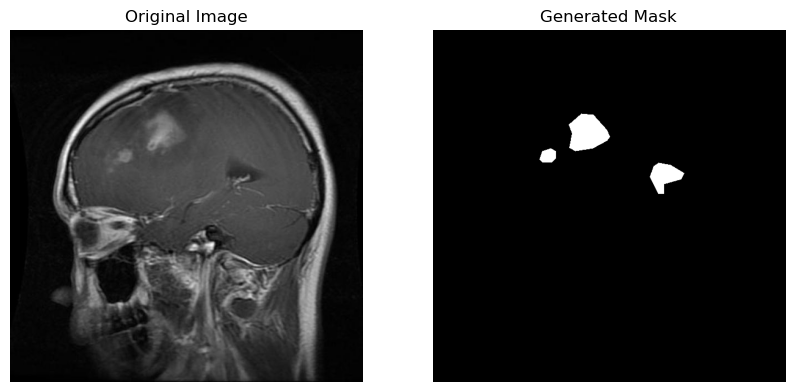

Loaded polygons for glioma28_jpg.rf.b15db44e39ceba25f6004e6176a82188.txt: [[(0.4345703125, 0.265625), (0.404296875, 0.3076171875), (0.38671875, 0.3173828125), (0.388671875, 0.3447265625), (0.41015625, 0.3486328125), (0.462890625, 0.3349609375), (0.470703125, 0.2978515625), (0.4580078125, 0.265625), (0.4345703125, 0.265625)], [(0.5048828125, 0.431640625), (0.4755859375, 0.4453125), (0.47265625, 0.4599609375), (0.482421875, 0.4794921875), (0.5107421875, 0.50390625), (0.537109375, 0.5087890625), (0.5498046875, 0.505859375), (0.5625, 0.4892578125), (0.548828125, 0.4619140625), (0.5048828125, 0.431640625)]]
Drawing polygon: [(278, 170), (258, 196), (247, 203), (248, 220), (262, 223), (296, 214), (301, 190), (293, 170), (278, 170)]
Drawing polygon: [(323, 276), (304, 285), (302, 294), (308, 306), (326, 322), (343, 325), (351, 323), (360, 313), (351, 295), (323, 276)]


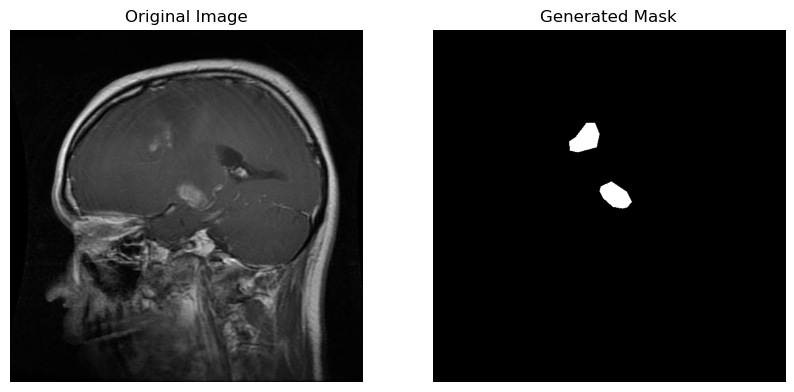

Loaded polygons for glioma2_jpg.rf.edf2ebefd6a4d3c19d7601807ffc9a30.txt: [[(0.6689453125, 0.31640625), (0.642578125, 0.3251953125), (0.62890625, 0.3818359375), (0.6416015625, 0.396484375), (0.662109375, 0.3974609375), (0.6865234375, 0.392578125), (0.708984375, 0.3740234375), (0.703125, 0.3466796875), (0.6689453125, 0.31640625)]]
Drawing polygon: [(428, 202), (411, 208), (402, 244), (410, 253), (423, 254), (439, 251), (453, 239), (450, 221), (428, 202)]


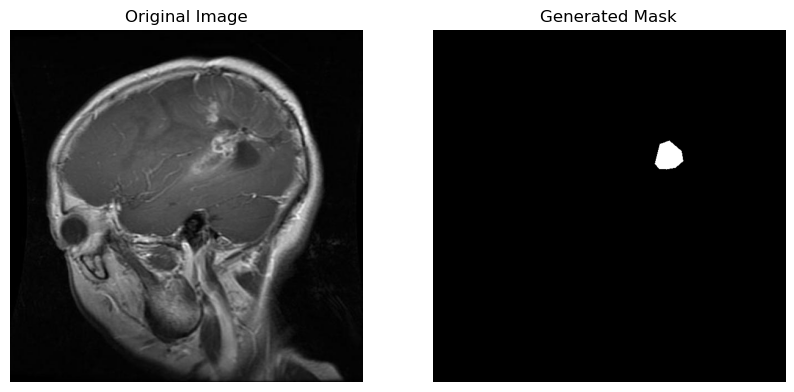

Loaded polygons for glioma30_jpg.rf.648d8cc07e543ab73fa22cb12895e3e8.txt: [[(0.6044921875, 0.46484375), (0.5595703125, 0.4453125), (0.5361328125, 0.439453125), (0.5087890625, 0.443359375), (0.5009765625, 0.4296875), (0.4853515625, 0.43359375), (0.470703125, 0.4501953125), (0.466796875, 0.4833984375), (0.501953125, 0.4970703125), (0.5078125, 0.5419921875), (0.52734375, 0.5830078125), (0.5703125, 0.5927734375), (0.6123046875, 0.560546875), (0.626953125, 0.5380859375), (0.6171875, 0.4794921875), (0.6044921875, 0.46484375)], [(0.408203125, 0.4248046875), (0.39453125, 0.4189453125), (0.4150390625, 0.40234375), (0.4443359375, 0.40625), (0.4912109375, 0.37109375), (0.5302734375, 0.36328125), (0.6005859375, 0.37109375), (0.603515625, 0.3564453125), (0.5869140625, 0.33984375), (0.5107421875, 0.33203125), (0.4169921875, 0.361328125), (0.3662109375, 0.38671875), (0.35546875, 0.3994140625), (0.3515625, 0.4287109375), (0.3662109375, 0.4453125), (0.380859375, 0.4443359375), (0.390625, 0.4404296875),

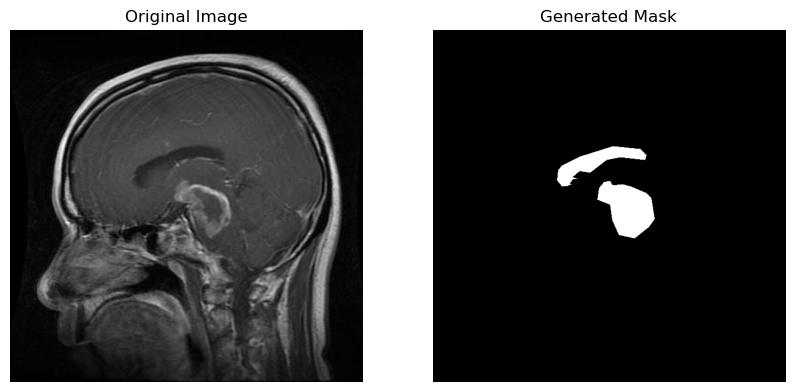

Loaded polygons for glioma33_jpg.rf.2d14f6f80c1e4df7e72ac3069966e88f.txt: [[(0.5498046875, 0.513671875), (0.5244140625, 0.501953125), (0.4755859375, 0.498046875), (0.427734375, 0.5400390625), (0.43359375, 0.5615234375), (0.41796875, 0.5888671875), (0.419921875, 0.6123046875), (0.4404296875, 0.634765625), (0.474609375, 0.6396484375), (0.5263671875, 0.619140625), (0.560546875, 0.5869140625), (0.57421875, 0.5400390625), (0.5498046875, 0.513671875)]]
Drawing polygon: [(351, 328), (335, 321), (304, 318), (273, 345), (277, 359), (267, 376), (268, 391), (281, 406), (303, 409), (336, 396), (358, 375), (367, 345), (351, 328)]


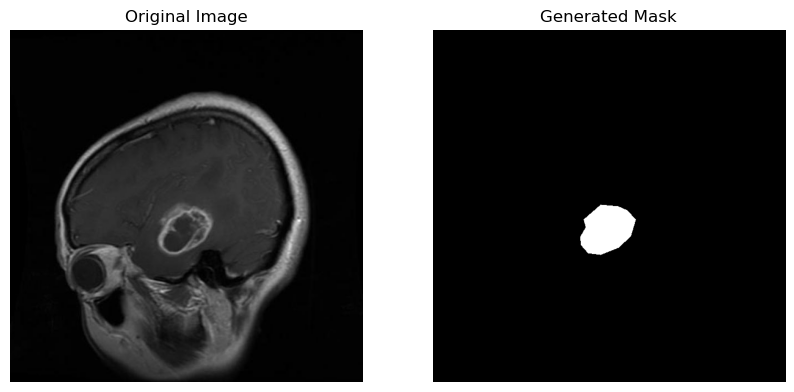

Loaded polygons for glioma34_jpg.rf.500b8ea609754e7c93fbe7c26a6e17a2.txt: [[(0.5849609375, 0.5390625), (0.5986328125, 0.515625), (0.5107421875, 0.486328125), (0.4521484375, 0.50390625), (0.43359375, 0.5166015625), (0.41796875, 0.6240234375), (0.4384765625, 0.6484375), (0.474609375, 0.6533203125), (0.568359375, 0.5966796875), (0.578125, 0.5712890625), (0.57421875, 0.5400390625), (0.5849609375, 0.5390625)]]
Drawing polygon: [(374, 345), (383, 330), (326, 311), (289, 322), (277, 330), (267, 399), (280, 415), (303, 418), (363, 381), (370, 365), (367, 345), (374, 345)]


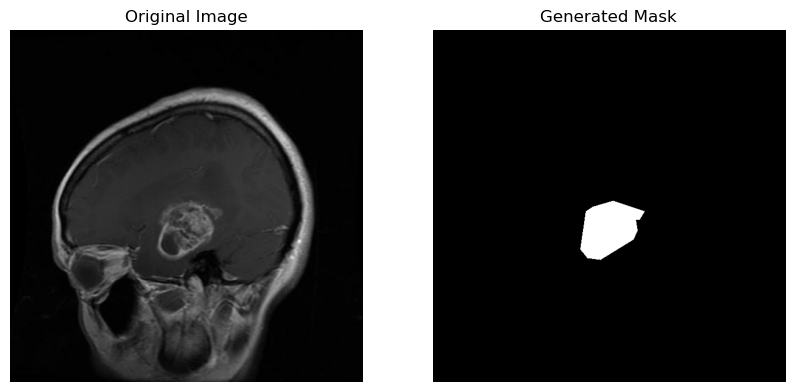

Loaded polygons for glioma35_jpg.rf.7e47df31c936daef9cb59d033585bc94.txt: [[(0.5224609375, 0.486328125), (0.4833984375, 0.490234375), (0.4482421875, 0.505859375), (0.421875, 0.5400390625), (0.423828125, 0.6298828125), (0.4482421875, 0.65234375), (0.474609375, 0.6513671875), (0.5556640625, 0.61328125), (0.57421875, 0.5947265625), (0.564453125, 0.5322265625), (0.5224609375, 0.486328125)]]
Drawing polygon: [(334, 311), (309, 313), (286, 323), (270, 345), (271, 403), (286, 417), (303, 416), (355, 392), (367, 380), (361, 340), (334, 311)]


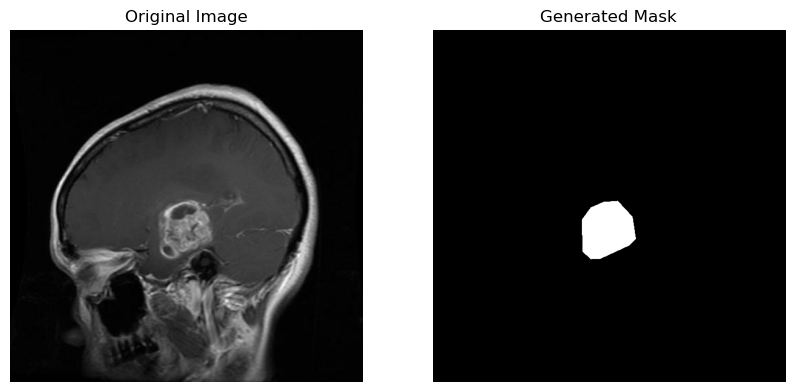

Loaded polygons for glioma36_jpg.rf.16d8b62a65f8215d40fb85e800cb16d8.txt: [[(0.556640625, 0.5048828125), (0.5146484375, 0.486328125), (0.4931640625, 0.486328125), (0.4521484375, 0.50390625), (0.4296875, 0.5439453125), (0.427734375, 0.5791015625), (0.435546875, 0.5947265625), (0.4638671875, 0.61328125), (0.4921875, 0.6162109375), (0.5498046875, 0.591796875), (0.568359375, 0.5537109375), (0.56640625, 0.5205078125), (0.556640625, 0.5048828125)]]
Drawing polygon: [(356, 323), (329, 311), (315, 311), (289, 322), (275, 348), (273, 370), (278, 380), (296, 392), (315, 394), (351, 378), (363, 354), (362, 333), (356, 323)]


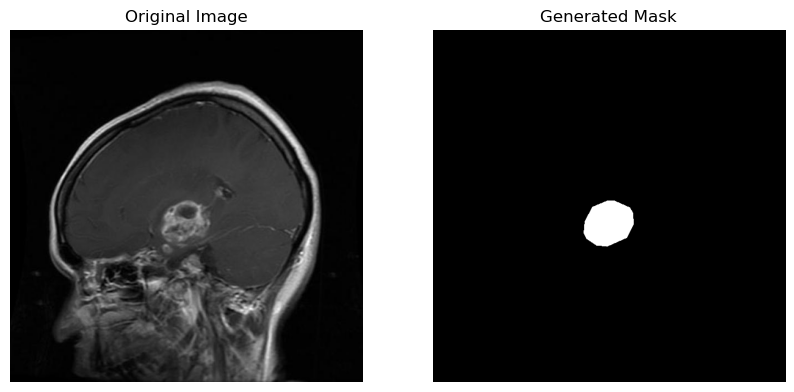

Loaded polygons for glioma38_jpg.rf.2a7831dcc0992fbaca2dba3b6ebc60ee.txt: [[(0.724609375, 0.5361328125), (0.7158203125, 0.525390625), (0.6767578125, 0.509765625), (0.6416015625, 0.509765625), (0.546875, 0.5322265625), (0.544921875, 0.5615234375), (0.5791015625, 0.611328125), (0.638671875, 0.6181640625), (0.6669921875, 0.609375), (0.705078125, 0.5771484375), (0.72265625, 0.5478515625), (0.724609375, 0.5361328125)], [(0.4306640625, 0.466796875), (0.419921875, 0.4794921875), (0.4140625, 0.5126953125), (0.4208984375, 0.5234375), (0.443359375, 0.5244140625), (0.4931640625, 0.484375), (0.58984375, 0.4326171875), (0.5224609375, 0.4296875), (0.4306640625, 0.466796875)]]
Drawing polygon: [(463, 343), (458, 336), (433, 326), (410, 326), (350, 340), (348, 359), (370, 391), (408, 395), (426, 390), (451, 369), (462, 350), (463, 343)]
Drawing polygon: [(275, 298), (268, 306), (265, 328), (269, 335), (283, 335), (315, 310), (377, 276), (334, 275), (275, 298)]


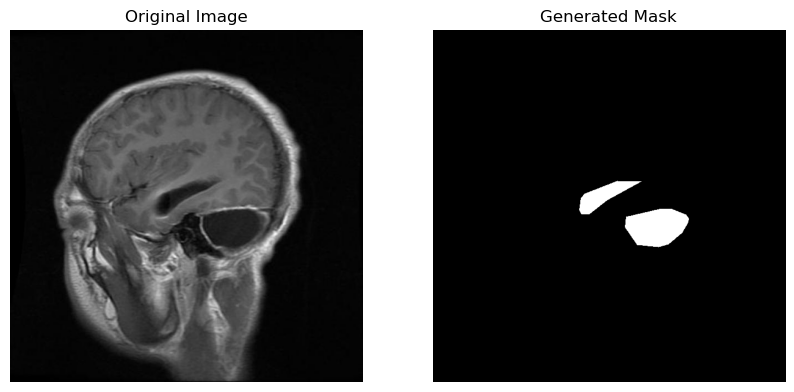

Loaded polygons for glioma39_jpg.rf.c8be56e6ce4e0edbd839051c0703c7b4.txt: [[(0.7333984375, 0.5234375), (0.6845703125, 0.505859375), (0.6162109375, 0.50390625), (0.5498046875, 0.515625), (0.53515625, 0.5263671875), (0.544921875, 0.5732421875), (0.5703125, 0.6083984375), (0.6044921875, 0.640625), (0.6328125, 0.6455078125), (0.6748046875, 0.62890625), (0.71484375, 0.5927734375), (0.73828125, 0.5458984375), (0.7333984375, 0.5234375)]]
Drawing polygon: [(469, 335), (438, 323), (394, 322), (351, 330), (342, 336), (348, 366), (365, 389), (386, 410), (405, 413), (431, 402), (457, 379), (472, 349), (469, 335)]


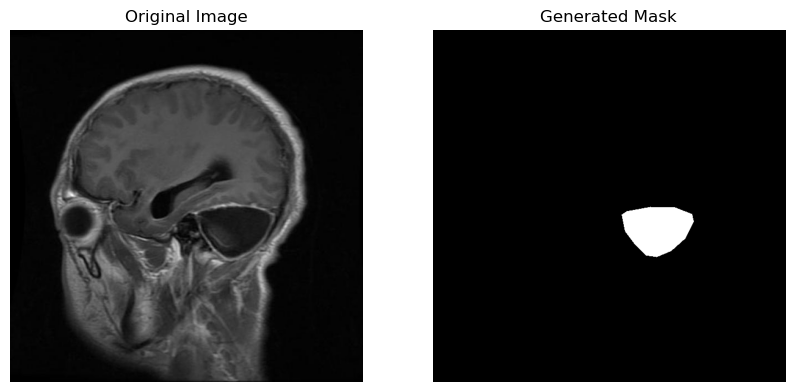

Loaded polygons for glioma3_jpg.rf.00d1df66e7194a15c6424306b53f4ece.txt: [[(0.5517578125, 0.310546875), (0.5087890625, 0.294921875), (0.5, 0.3134765625), (0.5078125, 0.3395432703125), (0.4672475953125, 0.3635817296875), (0.5087890625, 0.392578125), (0.51953125, 0.3916015625), (0.5361328125, 0.38671875), (0.560546875, 0.3525390625), (0.5625, 0.3232421875), (0.5517578125, 0.310546875)], [(0.392578125, 0.2373046875), (0.380859375, 0.2802734375), (0.400390625, 0.2861328125), (0.43359375, 0.2373046875), (0.4248046875, 0.21875), (0.4072265625, 0.22265625), (0.392578125, 0.2373046875)]]
Drawing polygon: [(353, 198), (325, 188), (320, 200), (325, 217), (299, 232), (325, 251), (332, 250), (343, 247), (358, 225), (360, 206), (353, 198)]
Drawing polygon: [(251, 151), (243, 179), (256, 183), (277, 151), (271, 140), (260, 142), (251, 151)]


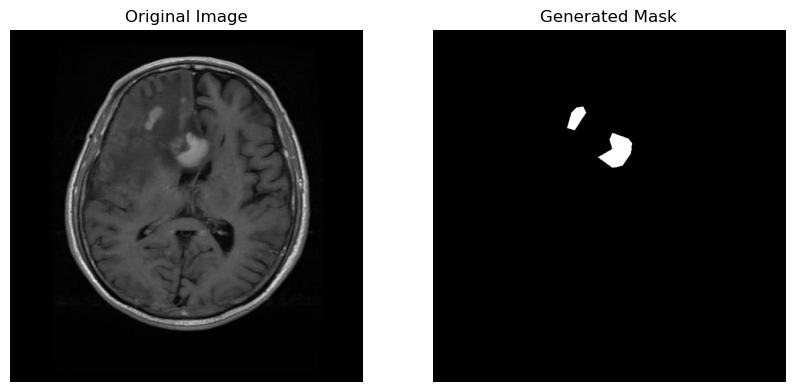

Loaded polygons for glioma40_jpg.rf.56c28c957948efd928997c3026e427a0.txt: [[(0.74609375, 0.5224609375), (0.6650390625, 0.49609375), (0.5830078125, 0.498046875), (0.5283203125, 0.515625), (0.521484375, 0.5302734375), (0.55078125, 0.6025390625), (0.6162109375, 0.6484375), (0.64453125, 0.6513671875), (0.6923828125, 0.625), (0.720703125, 0.5947265625), (0.74609375, 0.5537109375), (0.74609375, 0.5224609375)]]
Drawing polygon: [(477, 334), (425, 317), (373, 318), (338, 330), (333, 339), (352, 385), (394, 415), (412, 416), (443, 400), (461, 380), (477, 354), (477, 334)]


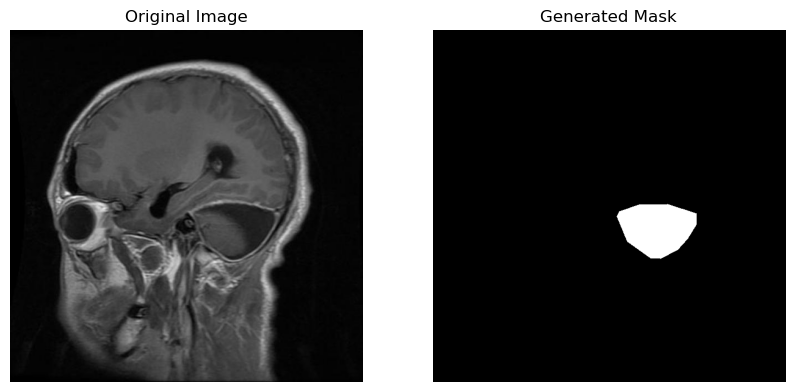

Loaded polygons for glioma42_jpg.rf.783b55cc41a6f86444b29ee25539f758.txt: [[(0.4033203125, 0.3125), (0.4697265625, 0.314453125), (0.5166015625, 0.328125), (0.5341796875, 0.3359375), (0.5595703125, 0.36328125), (0.5810546875, 0.361328125), (0.6015625, 0.3369140625), (0.60546875, 0.3173828125), (0.5791015625, 0.296875), (0.5048828125, 0.267578125), (0.4638671875, 0.263671875), (0.4130859375, 0.2734375), (0.3525390625, 0.298828125), (0.3125, 0.3330078125), (0.30078125, 0.3603515625), (0.298828125, 0.3974609375), (0.3056640625, 0.41015625), (0.3203125, 0.4111328125), (0.337890625, 0.3623046875), (0.3515625, 0.3447265625), (0.3740234375, 0.32421875), (0.4033203125, 0.3125)], [(0.6474609375, 0.462890625), (0.5810546875, 0.46875), (0.6064453125, 0.486328125), (0.6572265625, 0.49609375), (0.685546875, 0.5166015625), (0.708984375, 0.5810546875), (0.7109375, 0.6259765625), (0.716796875, 0.6259765625), (0.77734375, 0.5556640625), (0.783203125, 0.5419921875), (0.77734375, 0.5185546875), (0.6474609

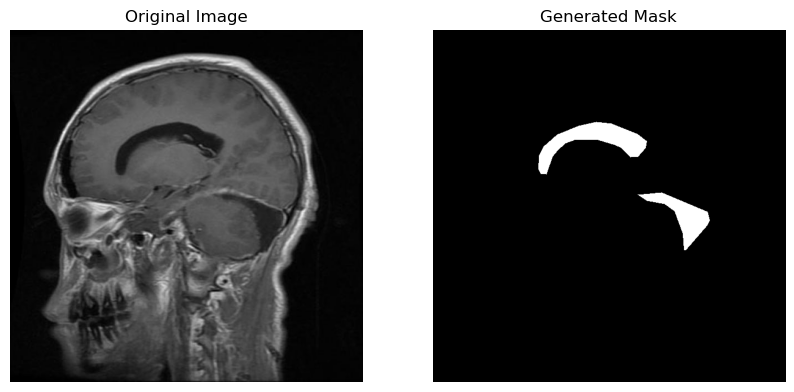

Loaded polygons for glioma44_jpg.rf.1d379e606bdcef959bda96076c602bfd.txt: [[(0.52734375, 0.2861328125), (0.5078125, 0.2470703125), (0.4892578125, 0.23046875), (0.4208984375, 0.224609375), (0.3740234375, 0.2421875), (0.357421875, 0.2626953125), (0.36328125, 0.2685546875), (0.35546875, 0.2724609375), (0.345703125, 0.3505859375), (0.3515625, 0.3779296875), (0.3720703125, 0.396484375), (0.4052734375, 0.41796875), (0.453125, 0.4267578125), (0.4853515625, 0.408203125), (0.50390625, 0.3818359375), (0.5234375, 0.3349609375), (0.52734375, 0.2861328125)]]
Drawing polygon: [(337, 183), (325, 158), (313, 147), (269, 143), (239, 155), (228, 168), (232, 171), (227, 174), (221, 224), (225, 241), (238, 253), (259, 267), (290, 273), (310, 261), (322, 244), (335, 214), (337, 183)]


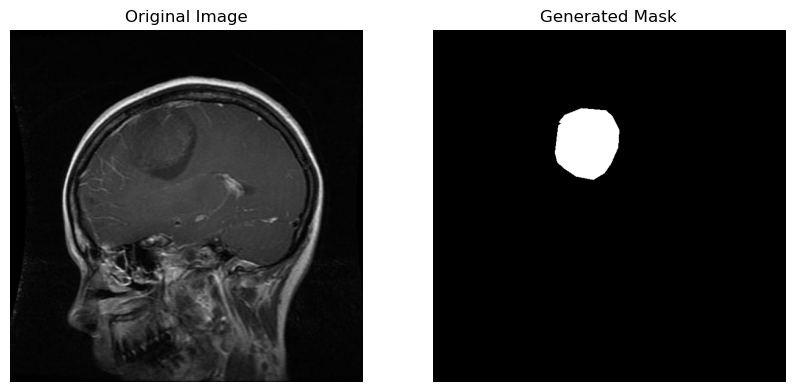

Loaded polygons for glioma45_jpg.rf.0fd25e87f2d8b9782eef94b14ac42eac.txt: [[(0.521484375, 0.2705078125), (0.515625, 0.2705078125), (0.513671875, 0.2861328125), (0.5048828125, 0.283203125), (0.4970703125, 0.294921875), (0.4912109375, 0.2890625), (0.3466796875, 0.291015625), (0.34375, 0.2822265625), (0.359375, 0.2744140625), (0.3388671875, 0.2734375), (0.33203125, 0.2802734375), (0.337890625, 0.2841796875), (0.318359375, 0.2958984375), (0.306640625, 0.3330078125), (0.326171875, 0.3759765625), (0.3857421875, 0.419921875), (0.453125, 0.4306640625), (0.4931640625, 0.408203125), (0.521484375, 0.3662109375), (0.53125, 0.3193359375), (0.521484375, 0.2705078125)]]
Drawing polygon: [(333, 173), (330, 173), (328, 183), (323, 181), (318, 188), (314, 185), (221, 186), (220, 180), (230, 175), (216, 175), (212, 179), (216, 181), (203, 189), (196, 213), (208, 240), (246, 268), (290, 275), (315, 261), (333, 234), (340, 204), (333, 173)]


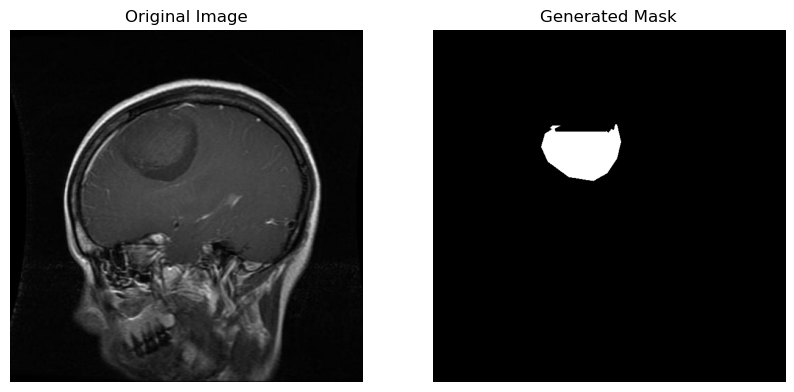

Loaded polygons for glioma46_jpg.rf.ceb839e8baf9fb5eb7f5e8bdee18fa0e.txt: [[(0.4287109375, 0.232421875), (0.3896484375, 0.2421875), (0.3583984375, 0.259765625), (0.3359375, 0.2841796875), (0.333984375, 0.2978515625), (0.314453125, 0.3134765625), (0.3125, 0.3388671875), (0.330078125, 0.3779296875), (0.3759765625, 0.41796875), (0.4130859375, 0.4296875), (0.455078125, 0.4287109375), (0.509765625, 0.3896484375), (0.529296875, 0.3232421875), (0.4736328125, 0.23828125), (0.4287109375, 0.232421875)]]
Drawing polygon: [(274, 148), (249, 155), (229, 166), (215, 181), (213, 190), (201, 200), (200, 216), (211, 241), (240, 267), (264, 275), (291, 274), (326, 249), (338, 206), (303, 152), (274, 148)]


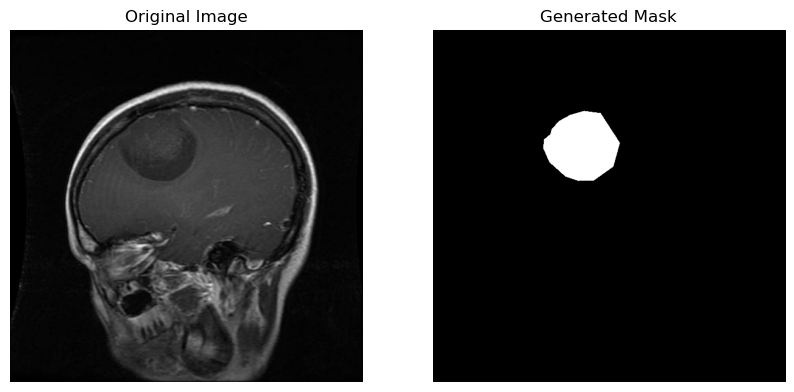

Loaded polygons for glioma48_jpg.rf.9a9197ab447096de817a279c0f983c2e.txt: [[(0.2978515625, 0.369140625), (0.2890625, 0.3798828125), (0.294921875, 0.3994140625), (0.322265625, 0.4052734375), (0.3427734375, 0.40234375), (0.365234375, 0.3837890625), (0.3193359375, 0.365234375), (0.2978515625, 0.369140625)]]
Drawing polygon: [(190, 236), (185, 243), (188, 255), (206, 259), (219, 257), (233, 245), (204, 233), (190, 236)]


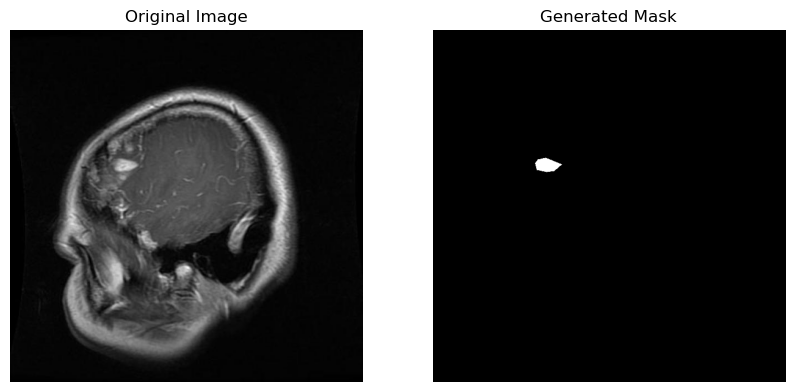

Loaded polygons for glioma49_jpg.rf.9f1c925253a596fc72034d0109e7412e.txt: [[(0.3046875, 0.3251953125), (0.306640625, 0.3544921875), (0.2822265625, 0.361328125), (0.27734375, 0.3818359375), (0.3037109375, 0.41015625), (0.357421875, 0.4111328125), (0.3876953125, 0.39453125), (0.392578125, 0.3798828125), (0.3173828125, 0.310546875), (0.3046875, 0.3251953125)]]
Drawing polygon: [(195, 208), (196, 226), (180, 231), (177, 244), (194, 262), (228, 263), (248, 252), (251, 243), (203, 198), (195, 208)]


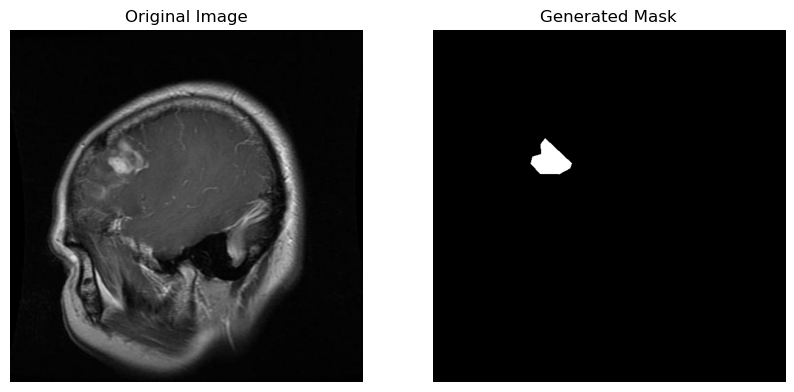

Loaded polygons for glioma4_jpg.rf.064601b1464fd007499b42c182763571.txt: [[(0.4150390625, 0.251953125), (0.400390625, 0.2607421875), (0.3828125, 0.3017578125), (0.3974609375, 0.32421875), (0.421875, 0.3271484375), (0.4296875, 0.3193359375), (0.416015625, 0.2822265625), (0.427734375, 0.2587890625), (0.4150390625, 0.251953125)], [(0.4892578125, 0.361328125), (0.44140625, 0.3486328125), (0.4755859375, 0.390625), (0.51171875, 0.3974609375), (0.525390625, 0.3662109375), (0.5185546875, 0.33203125), (0.5068359375, 0.330078125), (0.4892578125, 0.361328125)]]
Drawing polygon: [(265, 161), (256, 166), (245, 193), (254, 207), (270, 209), (275, 204), (266, 180), (273, 165), (265, 161)]
Drawing polygon: [(313, 231), (282, 223), (304, 250), (327, 254), (336, 234), (331, 212), (324, 211), (313, 231)]


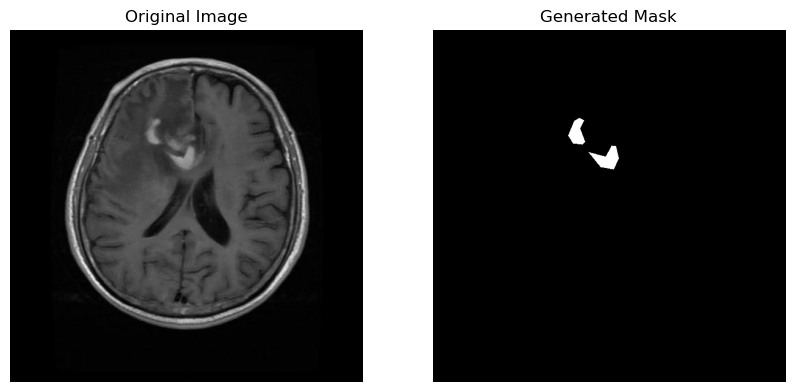

Loaded polygons for glioma5_jpg.rf.9666e40a130e55d876a31b42b43bff12.txt: [[(0.5625, 0.4501953125), (0.548828125, 0.5107421875), (0.560546875, 0.5615234375), (0.5732421875, 0.578125), (0.591796875, 0.5810546875), (0.60546875, 0.5673828125), (0.607421875, 0.5419921875), (0.5888671875, 0.42578125), (0.5625, 0.4501953125)], [(0.4775390625, 0.294921875), (0.4404296875, 0.296875), (0.431640625, 0.2666015625), (0.4169921875, 0.259765625), (0.3984375, 0.3115234375), (0.42578125, 0.3291015625), (0.42578125, 0.3388671875), (0.44921875, 0.3564453125), (0.482421875, 0.4091796875), (0.494140625, 0.4111328125), (0.51171875, 0.3916015625), (0.517578125, 0.3623046875), (0.498046875, 0.3095703125), (0.4775390625, 0.294921875)]]
Drawing polygon: [(360, 288), (351, 326), (358, 359), (366, 370), (378, 371), (387, 363), (388, 346), (376, 272), (360, 288)]
Drawing polygon: [(305, 188), (281, 190), (276, 170), (266, 166), (255, 199), (272, 210), (272, 216), (287, 228), (308, 261), (316, 263), (327, 250), (33

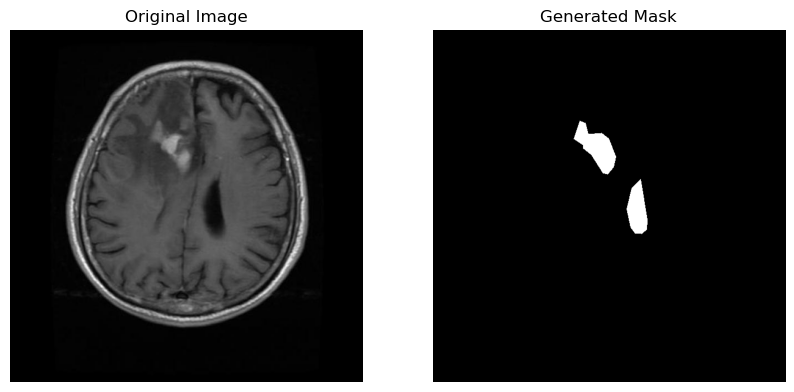

Loaded polygons for glioma6_jpg.rf.c56e9abe8ce5d73c83b3e1159f98886f.txt: [[(0.4814453125, 0.267578125), (0.46484375, 0.2763671875), (0.443359375, 0.3134765625), (0.44921875, 0.3388671875), (0.46484375, 0.3466796875), (0.4921875, 0.3115234375), (0.482421875, 0.2958984375), (0.494140625, 0.2744140625), (0.4814453125, 0.267578125)]]
Drawing polygon: [(308, 171), (297, 176), (283, 200), (287, 216), (297, 221), (315, 199), (308, 189), (316, 175), (308, 171)]


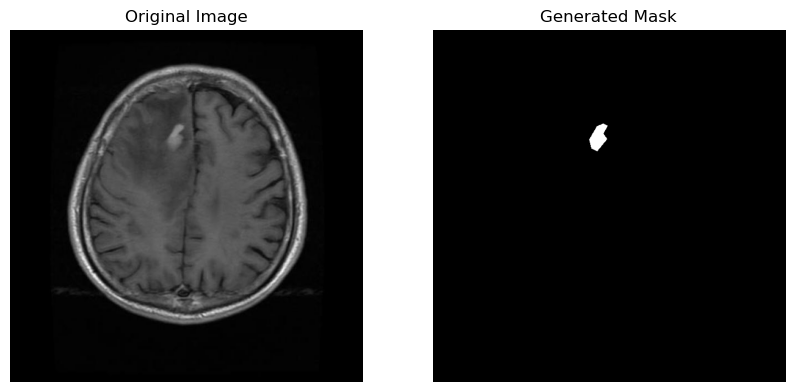

Loaded polygons for glioma8_jpg.rf.d54a4342750326015e96200d736fad8d.txt: [[(0.6123046875, 0.5546875), (0.572265625, 0.5986328125), (0.568359375, 0.6298828125), (0.578125, 0.7568359375), (0.6044921875, 0.767578125), (0.623046875, 0.7666015625), (0.708984375, 0.6962890625), (0.716796875, 0.6337890625), (0.7060546875, 0.583984375), (0.6123046875, 0.5546875)]]
Drawing polygon: [(391, 355), (366, 383), (363, 403), (370, 484), (386, 491), (398, 490), (453, 445), (458, 405), (451, 373), (391, 355)]


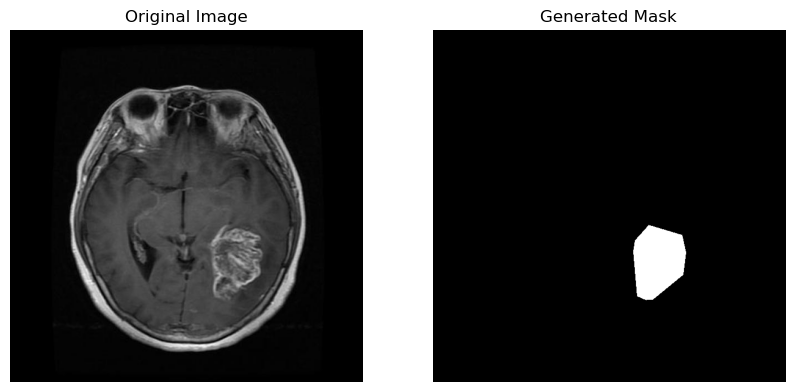

Loaded polygons for glioma9_jpg.rf.3c547e76482a970b00018a91e0e8a4fc.txt: [[(0.708984375, 0.5966796875), (0.6474609375, 0.552734375), (0.6279296875, 0.5546875), (0.54296875, 0.6025390625), (0.546875, 0.6201171875), (0.56640625, 0.6396484375), (0.5859375, 0.7373046875), (0.6083984375, 0.76171875), (0.62890625, 0.7646484375), (0.705078125, 0.6884765625), (0.689453125, 0.6611328125), (0.70703125, 0.6474609375), (0.708984375, 0.5966796875)]]
Drawing polygon: [(453, 381), (414, 353), (401, 355), (347, 385), (350, 396), (362, 409), (375, 471), (389, 487), (402, 489), (451, 440), (441, 423), (452, 414), (453, 381)]


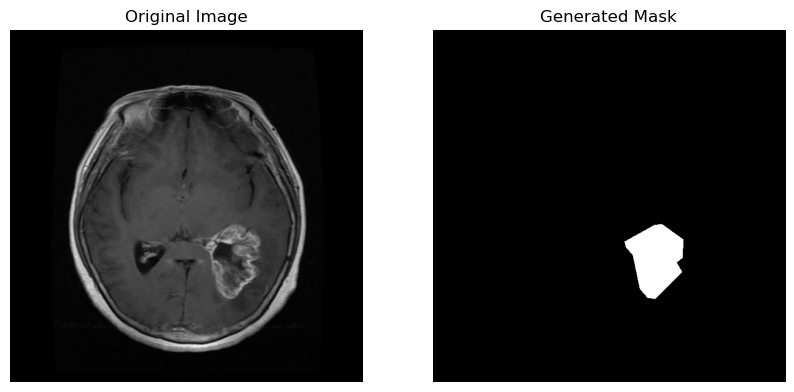

Loaded polygons for meningioma10_jpg.rf.24f870883d2b7d87c46ae6aefaf9827d.txt: [[(0.3985992234375, 0.3056640609375), (0.32622785625, 0.2578125), (0.26833076093749997, 0.265625), (0.23047497187500002, 0.2890625), (0.1781449046875, 0.3720703125), (0.1892789625, 0.4208984390625), (0.2527430828125, 0.474609375), (0.27167098125, 0.4736328125), (0.3373619140625, 0.447265625), (0.381898140625, 0.4023437484375), (0.41418690468749997, 0.3876953125), (0.3985992234375, 0.3056640609375)]]
Drawing polygon: [(255, 195), (208, 165), (171, 170), (147, 185), (114, 238), (121, 269), (161, 303), (173, 303), (215, 286), (244, 257), (265, 248), (255, 195)]


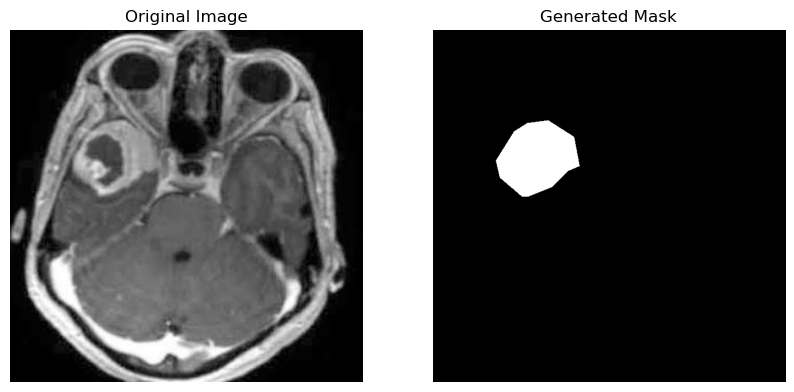

Loaded polygons for meningioma12_jpg.rf.437a30f87a8137238724bee6c03655a0.txt: [[(0.6692956828125001, 0.3847656234375), (0.6073025999999999, 0.40234375), (0.587786259375, 0.4443359390625), (0.6199308203125, 0.4794921890625), (0.6360031, 0.5458984390625), (0.6853679625, 0.58203125), (0.7783575875000001, 0.6123046890625), (0.8449427484375001, 0.5771484390625), (0.8587189890625, 0.4833984390625), (0.7519531265625, 0.38671875), (0.6692956828125001, 0.3847656234375)], [(0.3914748328125, 0.08789062343750001), (0.4925005953125, 0.09570312343750001), (0.5166090156250001, 0.10839843906249999), (0.5418654578125001, 0.08496093906249999), (0.5361253593749999, 0.05859375), (0.3834386953125, 0.0556640609375), (0.3914748328125, 0.08789062343750001)]]
Drawing polygon: [(428, 246), (388, 257), (376, 284), (396, 306), (407, 349), (438, 372), (498, 391), (540, 369), (549, 309), (481, 247), (428, 246)]
Drawing polygon: [(250, 56), (315, 61), (330, 69), (346, 54), (343, 37), (245, 35), (250, 56)]


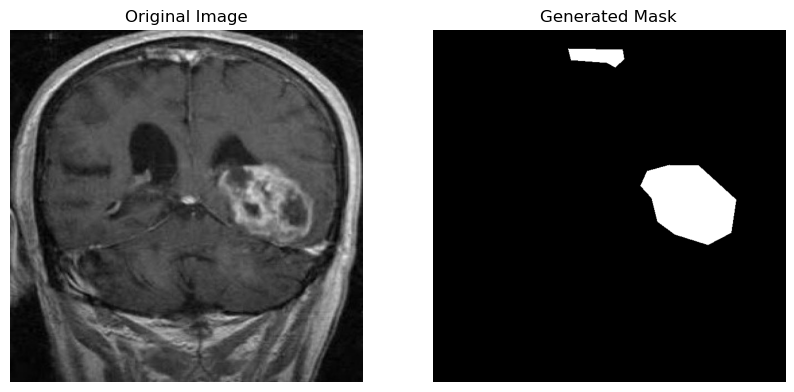

Loaded polygons for meningioma13_jpg.rf.e54fe0689e43d4f69ee9eadbdd688f01.txt: [[(0.73498535, 0.3222656234375), (0.719741209375, 0.328125), (0.6892529296875, 0.330078125), (0.6838085953124999, 0.3388671890625), (0.6925195296875, 0.3505859375), (0.66529785, 0.373046875), (0.621743165625, 0.3789062515625), (0.604321290625, 0.3945312515625), (0.5890771499999999, 0.3964843765625), (0.583632809375, 0.4072265609375), (0.583632809375, 0.4228515609375), (0.591254884375, 0.4375), (0.621743165625, 0.4472656234375), (0.6631201156250001, 0.4726562515625), (0.699052734375, 0.4755859375), (0.7720068343750001, 0.4433593765625), (0.7905175796874999, 0.4111328109375), (0.786162109375, 0.3603515609375), (0.73498535, 0.3222656234375)]]
Drawing polygon: [(470, 206), (460, 210), (441, 211), (437, 216), (443, 224), (425, 238), (397, 242), (386, 252), (377, 253), (373, 260), (373, 270), (378, 280), (397, 286), (424, 302), (447, 304), (494, 283), (505, 263), (503, 230), (470, 206)]


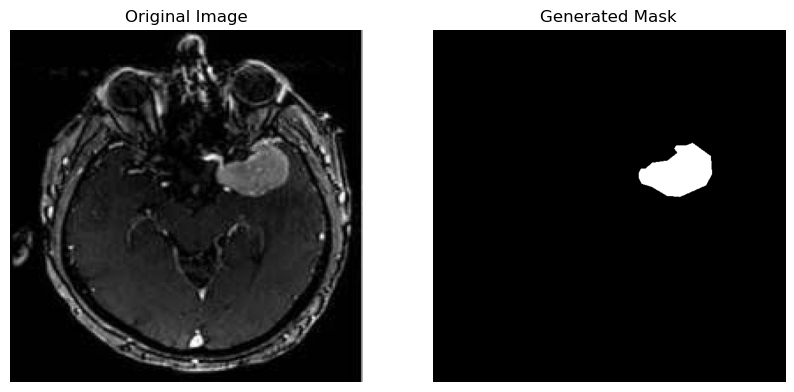

Loaded polygons for meningioma15_jpg.rf.b23df9f410f16ee1c4f7f11179bec8b0.txt: [[(0.4589843765625, 0.6318359375), (0.4072265625, 0.5957031234375), (0.3251953140625, 0.6152343765625), (0.1787109375, 0.7011718765625), (0.1484375, 0.7060546859375), (0.2392578140625, 0.8261718765625), (0.3095703140625, 0.8613281234375), (0.3515625, 0.8623046859375), (0.4335937515625, 0.8154296859375), (0.4746093765625, 0.7373046859375), (0.4765625, 0.6923828140625), (0.4589843765625, 0.6318359375)]]
Drawing polygon: [(293, 404), (260, 381), (208, 393), (114, 448), (95, 451), (153, 528), (198, 551), (225, 551), (277, 521), (303, 471), (305, 443), (293, 404)]


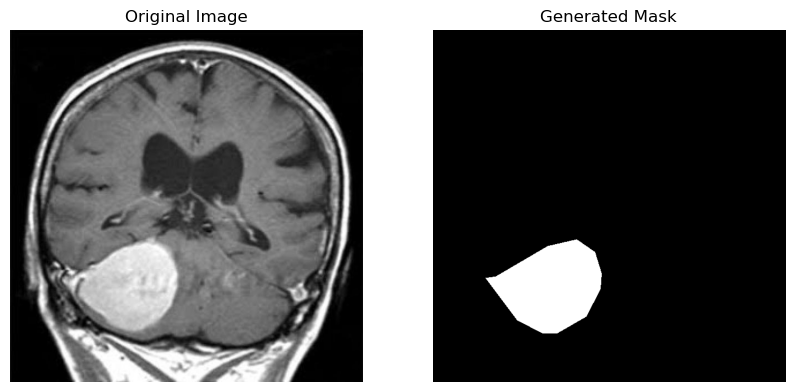

Loaded polygons for meningioma16_jpg.rf.9324fabaf0ee8820c41f0d1531167063.txt: [[(0.5, 0.36227301562499997), (0.4609375, 0.320813978125), (0.431640625, 0.263561021875), (0.3994140609375, 0.242831503125), (0.3154296875, 0.24677998437499998), (0.2353515609375, 0.27639358125), (0.2070312515625, 0.31291701875), (0.1992187484375, 0.358324534375), (0.2109375, 0.4925728453125), (0.2724609390625, 0.4915857265625), (0.3056640609375, 0.5172508437500001), (0.3466796875, 0.5152766046874999), (0.408203125, 0.53205764375), (0.4443359390625, 0.519225084375), (0.4804687484375, 0.4767789265625), (0.5039062515625, 0.39780933281249997), (0.5, 0.36227301562499997)]]
Drawing polygon: [(320, 231), (295, 205), (276, 168), (255, 155), (201, 157), (150, 176), (132, 200), (127, 229), (135, 315), (174, 314), (195, 331), (221, 329), (261, 340), (284, 332), (307, 305), (322, 254), (320, 231)]


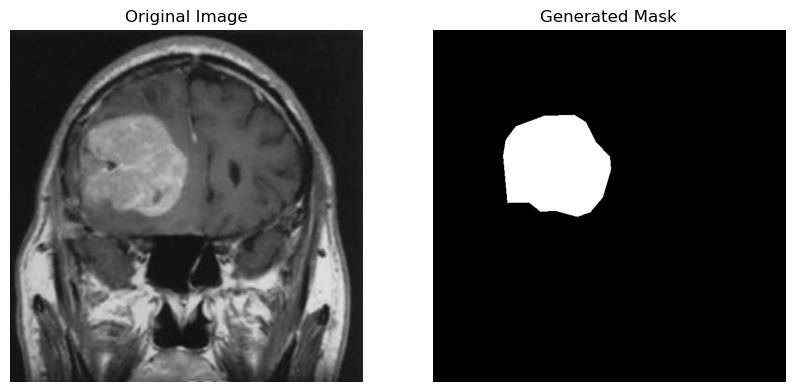

Loaded polygons for meningioma17_jpg.rf.7d7db1bbd366d07cf78665e42cc9481e.txt: [[(0.4606168359375, 0.4599609375), (0.4545825578125, 0.4033203140625), (0.418376865625, 0.3740234390625), (0.418376865625, 0.3623046859375), (0.4364797109375, 0.3564453140625), (0.3509940546875, 0.310546875), (0.28461695468750003, 0.3183593765625), (0.2463998359375, 0.341796875), (0.1699656015625, 0.3632812515625), (0.1428113328125, 0.3876953140625), (0.11867420937499999, 0.4287109375), (0.10057136250000001, 0.4365234390625), (0.0985599359375, 0.4970703140625), (0.1247084875, 0.5439453140625), (0.122697059375, 0.5712890625), (0.1548798953125, 0.6298828109375), (0.16795417343750002, 0.640625), (0.27154267656250003, 0.6455078109375), (0.3590397609375, 0.601562503125), (0.394239740625, 0.5693359375), (0.4364797109375, 0.4853515609375), (0.4606168359375, 0.4599609375)]]
Drawing polygon: [(294, 294), (290, 258), (267, 239), (267, 231), (279, 228), (224, 198), (182, 203), (157, 218), (108, 232), (91, 248), (75, 274

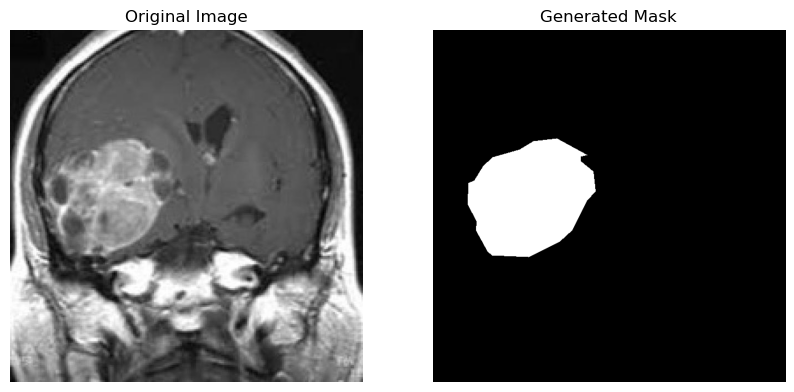

Loaded polygons for meningioma18_jpg.rf.3beedda7e7c962462ef652f26571b0cd.txt: [[(0.2989422265625, 0.5966796875), (0.27269920625, 0.5703125), (0.1585991203125, 0.5703125), (0.130074096875, 0.6064453125), (0.125510096875, 0.6435546875), (0.17115013125, 0.6689453125), (0.1973931484375, 0.72265625), (0.24189218281249997, 0.7294921875), (0.2818272125, 0.7265625), (0.3149162375, 0.6943359375), (0.317198240625, 0.6337890625), (0.2989422265625, 0.5966796875)]]
Drawing polygon: [(191, 381), (174, 365), (101, 365), (83, 388), (80, 411), (109, 428), (126, 462), (154, 466), (180, 465), (201, 444), (203, 405), (191, 381)]


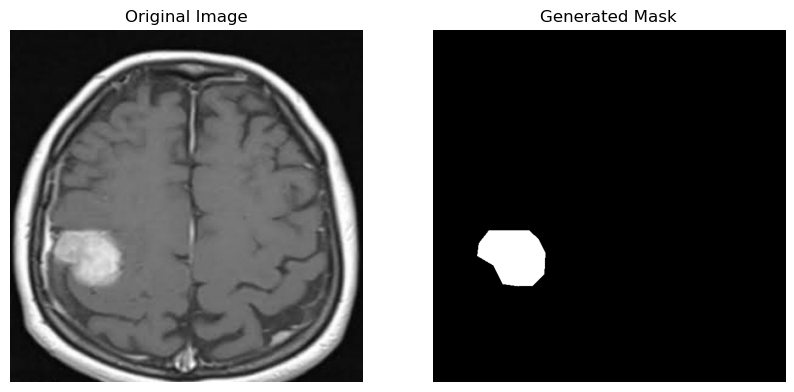

Loaded polygons for meningioma20_jpg.rf.9ce8314aade0a44b066051b2d9e96a17.txt: [[(0.44354363281250003, 0.4052734375), (0.381577978125, 0.3359375), (0.29352152187499997, 0.3173828140625), (0.27069206874999996, 0.236328125), (0.218510465625, 0.2148437515625), (0.1793742640625, 0.2148437515625), (0.10218897499999999, 0.2939453140625), (0.10218897499999999, 0.3486328140625), (0.07392393750000001, 0.4580078140625), (0.07827240625000001, 0.5029296859375), (0.096753390625, 0.525390625), (0.14893499375000002, 0.546875), (0.2337301, 0.5507812484375), (0.27069206874999996, 0.529296875), (0.283737471875, 0.548828125), (0.32178655625, 0.5595703140625), (0.3881006796875, 0.525390625), (0.4218012953125, 0.4931640625), (0.44789209999999996, 0.4365234375), (0.44354363281250003, 0.4052734375)]]
Drawing polygon: [(283, 259), (244, 215), (187, 203), (173, 151), (139, 137), (114, 137), (65, 188), (65, 223), (47, 293), (50, 321), (61, 336), (95, 350), (149, 352), (173, 338), (181, 351), (205, 358), (248, 33

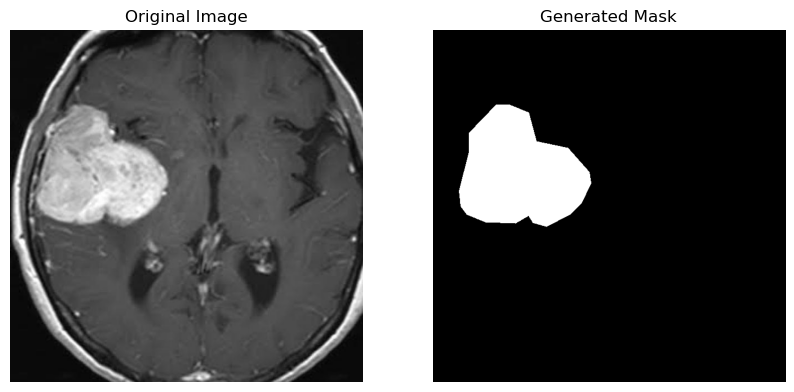

Loaded polygons for meningioma21_jpg.rf.14205983048a6a3f834e7965654c6823.txt: [[(0.6533296125, 0.11816406093750001), (0.633243428125, 0.09179687343750001), (0.5782707078125, 0.0605468734375), (0.4683252734375, 0.072265625), (0.42180989531249996, 0.08984375), (0.40383804375, 0.11230468593750001), (0.39538070468750003, 0.1474609390625), (0.40383804375, 0.2607421875), (0.42392423125, 0.2832031265625), (0.46409660312499995, 0.28125), (0.5074404765625, 0.2958984375), (0.6121000734375001, 0.26171875), (0.666015625, 0.2080078125), (0.6681299625, 0.1572265625), (0.6533296125, 0.11816406093750001)]]
Drawing polygon: [(418, 75), (405, 58), (370, 38), (299, 46), (269, 57), (258, 71), (253, 94), (258, 166), (271, 181), (297, 180), (324, 189), (391, 167), (426, 133), (427, 100), (418, 75)]


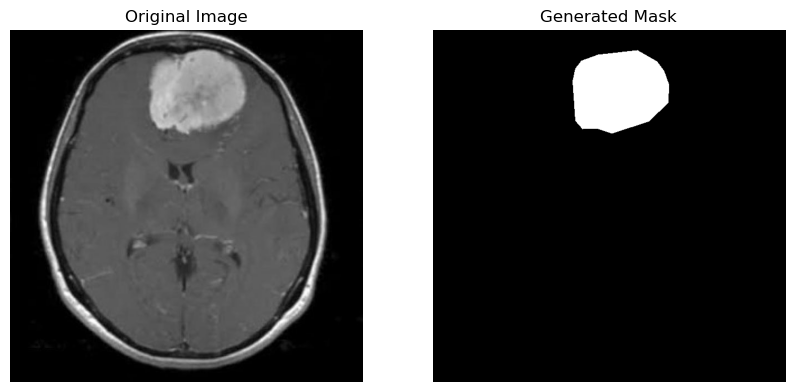

Loaded polygons for meningioma22_jpg.rf.3c0bf6390bd94fb5cfd825f37d43c710.txt: [[(0.6928813359375, 0.2138671875), (0.643042503125, 0.18359375), (0.6090062265625, 0.18359375), (0.567676465625, 0.15625), (0.46313647187500007, 0.1582031234375), (0.43517810468749996, 0.1826171875), (0.418159965625, 0.2080078125), (0.3938483390625, 0.3603515625), (0.418159965625, 0.4091796875), (0.4594897265625, 0.4287109375), (0.65033599375, 0.390625), (0.6953125, 0.3564453125), (0.7098994750000001, 0.2412109375), (0.6928813359375, 0.2138671875)]]
Drawing polygon: [(443, 136), (411, 117), (389, 117), (363, 100), (296, 101), (278, 116), (267, 133), (252, 230), (267, 261), (294, 274), (416, 250), (445, 228), (454, 154), (443, 136)]


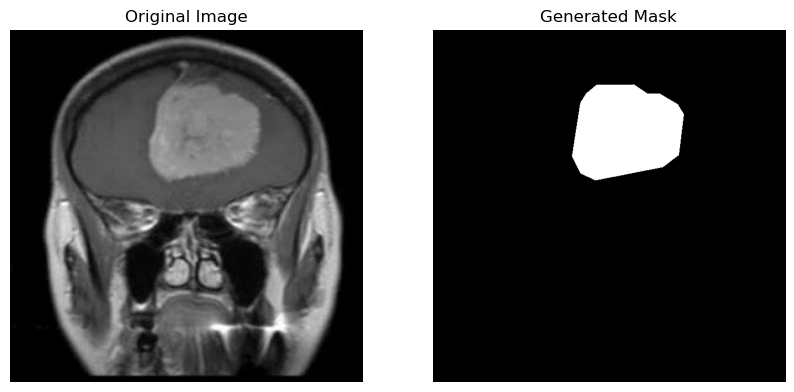

Loaded polygons for meningioma23_jpg.rf.d2e438942bdda35e6e442ee46a438a67.txt: [[(0.5804575109375001, 0.6240234375), (0.5428352624999999, 0.6015625), (0.46544092812500004, 0.5976562484375), (0.43319328749999997, 0.609375), (0.41599454687500004, 0.6386718765625), (0.37729738125, 0.6308593765625), (0.3579487984375, 0.640625), (0.3224763953125, 0.7216796859375), (0.33537545, 0.7666015625), (0.3686980109375, 0.7890625), (0.43749297499999995, 0.7734375), (0.5245616, 0.7998046859375), (0.549284790625, 0.7890625), (0.59550640625, 0.7353515625), (0.59980609375, 0.6826171859375), (0.5804575109375001, 0.6240234375)]]
Drawing polygon: [(371, 399), (347, 385), (297, 382), (277, 390), (266, 408), (241, 403), (229, 410), (206, 461), (214, 490), (235, 505), (279, 495), (335, 511), (351, 505), (381, 470), (383, 436), (371, 399)]


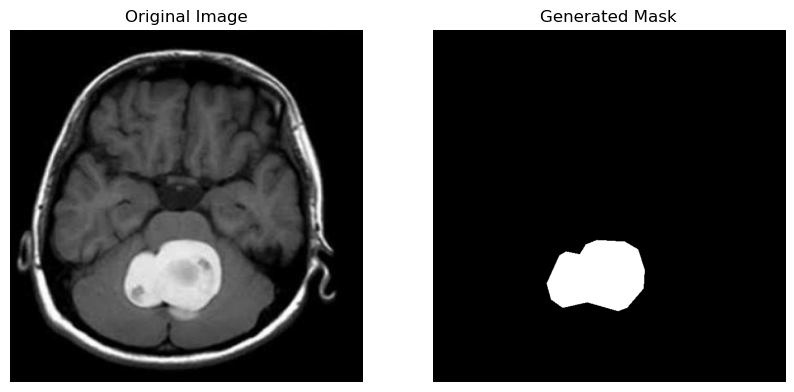

Loaded polygons for meningioma24_jpg.rf.b1a3870150d9f958ba372234fb4218b0.txt: [[(0.8489467062499999, 0.5253906234375), (0.7831915, 0.5058593765625), (0.74092029375, 0.515625), (0.6810360875, 0.5634765609375), (0.659900484375, 0.6298828125), (0.6916038890625, 0.6796874984375), (0.7784946984375, 0.7246093765625), (0.807849703125, 0.7255859375), (0.8783017109375001, 0.6591796859375), (0.8548177062500001, 0.6259765609375), (0.8806501109375, 0.5693359375), (0.8489467062499999, 0.5253906234375)]]
Drawing polygon: [(543, 336), (501, 323), (474, 330), (435, 360), (422, 403), (442, 434), (498, 463), (517, 464), (562, 421), (547, 400), (563, 364), (543, 336)]


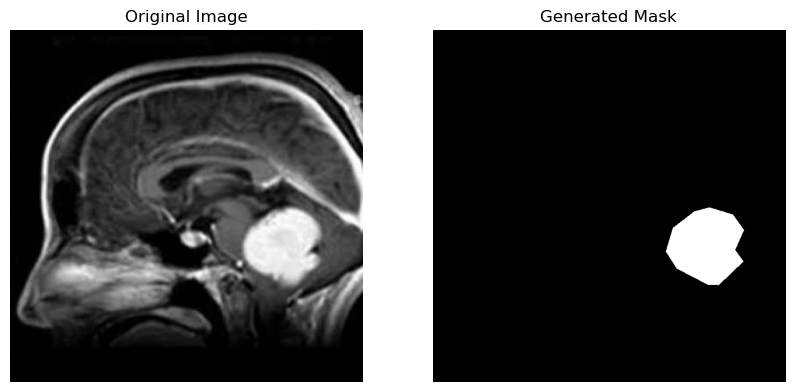

Loaded polygons for meningioma26_jpg.rf.ad10e711ad911b92931e4c4591760d5e.txt: [[(0.5166015640625, 0.1914062484375), (0.505859375, 0.2060546875), (0.501953125, 0.2490234359375), (0.5244140640625, 0.263671875), (0.5429687515625, 0.2646484359375), (0.5703125, 0.2333984359375), (0.5703125, 0.2001953125), (0.5498046875, 0.189453125), (0.5166015640625, 0.1914062484375)]]
Drawing polygon: [(330, 122), (323, 131), (321, 159), (335, 168), (347, 169), (365, 149), (365, 128), (351, 121), (330, 122)]


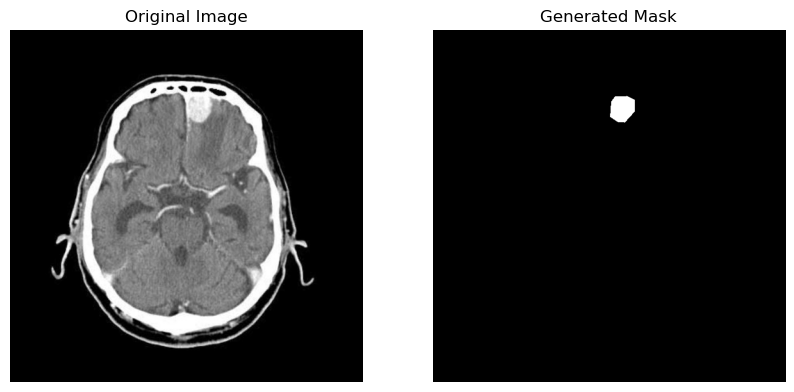

Loaded polygons for meningioma27_jpg.rf.936c63e6f2d68c1e103552e7e2d8c364.txt: [[(0.5976562484375, 0.2431640625), (0.611328125, 0.2197265625), (0.615234375, 0.1904296875), (0.6054687515625, 0.1591796875), (0.5849609375, 0.140625), (0.4990234375, 0.119140625), (0.4658203125, 0.134765625), (0.451171875, 0.1650390625), (0.423828125, 0.1826171875), (0.419921875, 0.1962890625), (0.427734375, 0.2255859375), (0.419921875, 0.2431640625), (0.4345703125, 0.28125), (0.4638671875, 0.2851562484375), (0.4833984375, 0.310546875), (0.515625, 0.3115234375), (0.533203125, 0.2978515625), (0.5380859375, 0.271484375), (0.5751953125, 0.263671875), (0.5976562484375, 0.2431640625)]]
Drawing polygon: [(382, 155), (391, 140), (393, 121), (387, 101), (374, 90), (319, 76), (298, 86), (288, 105), (271, 116), (268, 125), (273, 144), (268, 155), (278, 180), (296, 182), (309, 198), (330, 199), (341, 190), (344, 173), (368, 168), (382, 155)]


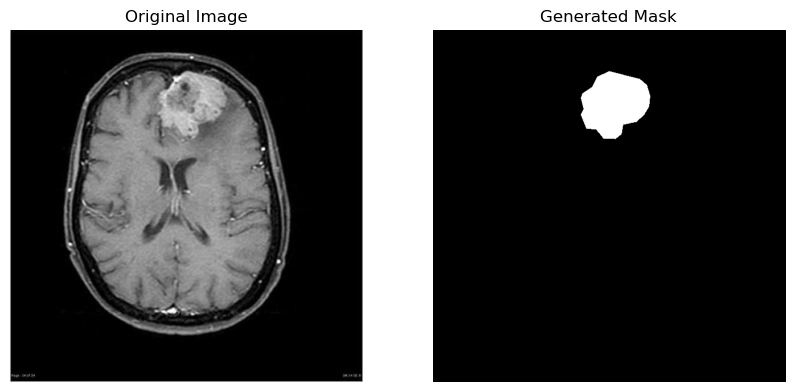

Loaded polygons for meningioma28_jpg.rf.d545bff4ec15a865fb2836b0173230b9.txt: [[(0.7894787921875001, 0.3671875015625), (0.6564346703124999, 0.3339843734375), (0.569830478125, 0.4541015640625), (0.663965471875, 0.51171875), (0.7304875281250001, 0.5185546875), (0.8108160546875001, 0.4697265640625), (0.8359187218749999, 0.4384765640625), (0.8359187218749999, 0.4189453125), (0.7894787921875001, 0.3671875015625)]]
Drawing polygon: [(505, 235), (420, 213), (364, 290), (424, 327), (467, 331), (518, 300), (534, 280), (534, 268), (505, 235)]


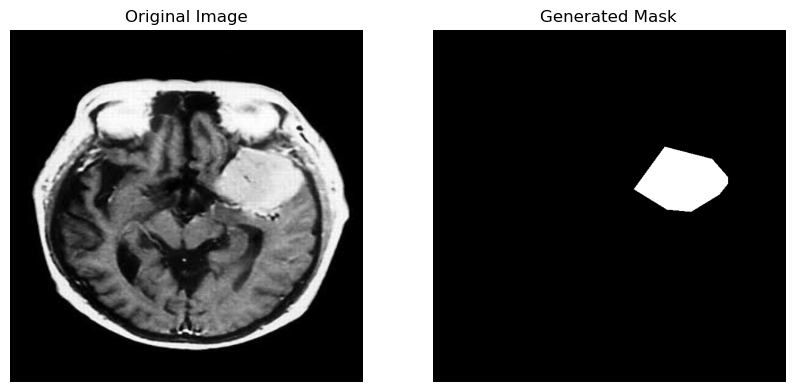

Loaded polygons for meningioma29_jpg.rf.11f91fcd9abe515d1191ba47c6f74e04.txt: [[(0.6479166671875001, 0.6022451453125), (0.7229166671875, 0.5916262140625), (0.8291666671875, 0.5916262140625), (0.85625, 0.5188106796875), (0.8604166671875, 0.480885921875), (0.8625, 0.47481796093749995), (0.8476041671875001, 0.4697265625), (0.8476041671875001, 0.4345703125), (0.8261458328125, 0.3857421875), (0.7631119796875, 0.36328125), (0.7175130203125, 0.31640625), (0.6558203140625001, 0.3105468734375), (0.5418229171875, 0.4287109375), (0.5203645828125001, 0.4716796875), (0.5310937499999999, 0.4990234375), (0.5291666671875, 0.5203276703124999), (0.5479166671875, 0.5370145625), (0.5875, 0.58100728125), (0.6479166671875001, 0.6022451453125)]]
Drawing polygon: [(414, 385), (462, 378), (530, 378), (548, 332), (550, 307), (552, 303), (542, 300), (542, 278), (528, 246), (488, 232), (459, 202), (419, 198), (346, 274), (333, 301), (339, 319), (338, 333), (350, 343), (376, 371), (414, 385)]


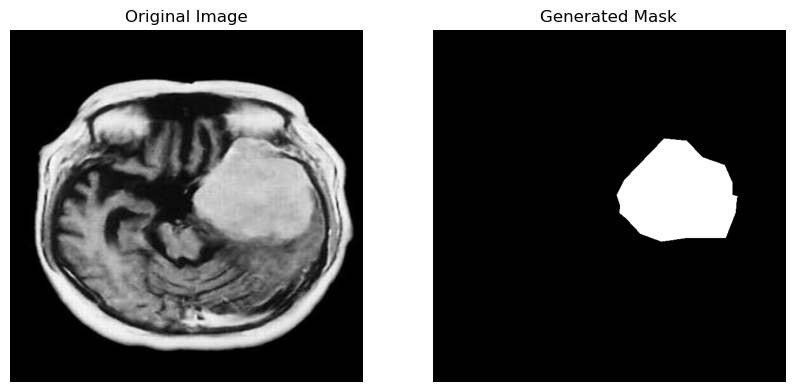

Loaded polygons for meningioma2_jpg.rf.8ad0b09a38c5839cbd78629a564cd779.txt: [[(0.771484375, 0.489967403125), (0.775390625, 0.455963353125), (0.7431640640625, 0.4760566546875), (0.7119140640625, 0.45132643906250003), (0.6708984359375, 0.44823516249999995), (0.6259765640625, 0.48223920937500003), (0.587890625, 0.5703406046875), (0.580078125, 0.6383486984375), (0.638671875, 0.65071380625), (0.6787109359375, 0.5780687953125), (0.7236328140625, 0.562612409375), (0.7529296859375, 0.5224258093749999), (0.771484375, 0.489967403125)]]
Drawing polygon: [(493, 313), (496, 291), (475, 304), (455, 288), (429, 286), (400, 308), (376, 365), (371, 408), (408, 416), (434, 369), (463, 360), (481, 334), (493, 313)]


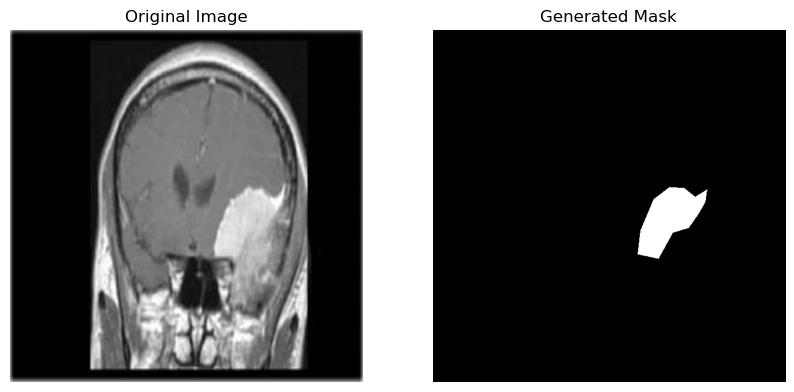

Loaded polygons for meningioma31_jpg.rf.a75e1a32a27fe6d557c537ba150949f7.txt: [[(0.5316233921875, 0.1298828109375), (0.423153146875, 0.109375), (0.334946578125, 0.126953125), (0.3385225203125, 0.2080078109375), (0.3814338234375, 0.2646484375), (0.40884937812500005, 0.283203125), (0.46844841718749997, 0.28125), (0.503015853125, 0.3037109359375), (0.52923943125, 0.2841796875), (0.5316233921875, 0.2412109359375), (0.564998853125, 0.2177734375), (0.5316233921875, 0.1298828109375)]]
Drawing polygon: [(340, 83), (270, 70), (214, 81), (216, 133), (244, 169), (261, 181), (299, 180), (321, 194), (338, 181), (340, 154), (361, 139), (340, 83)]


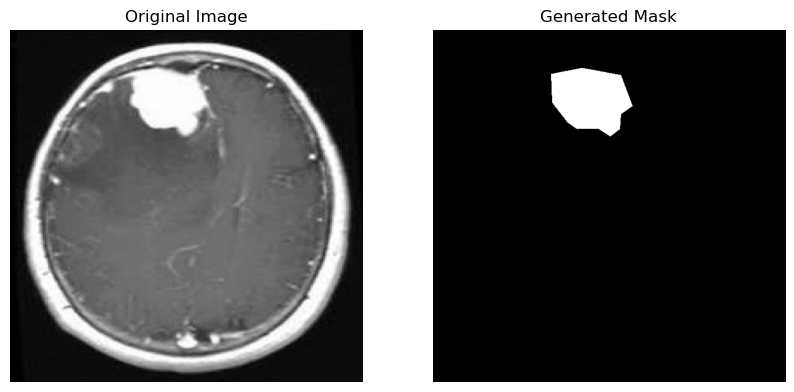

Loaded polygons for meningioma33_jpg.rf.b4918f3d3f97e0e0c36e359bfe1b3c4d.txt: [[(0.650390625, 0.3398437484375), (0.6245404390625, 0.3759765609375), (0.60386029375, 0.4853515609375), (0.6204044125, 0.5166015609375), (0.652458640625, 0.541015625), (0.69175091875, 0.560546875), (0.7506893375, 0.5693359390625), (0.8127297796875, 0.5361328125), (0.75689338125, 0.3291015609375), (0.70209099375, 0.322265625), (0.650390625, 0.3398437484375)]]
Drawing polygon: [(416, 217), (399, 240), (386, 310), (397, 330), (417, 346), (442, 358), (480, 364), (520, 343), (484, 210), (449, 206), (416, 217)]


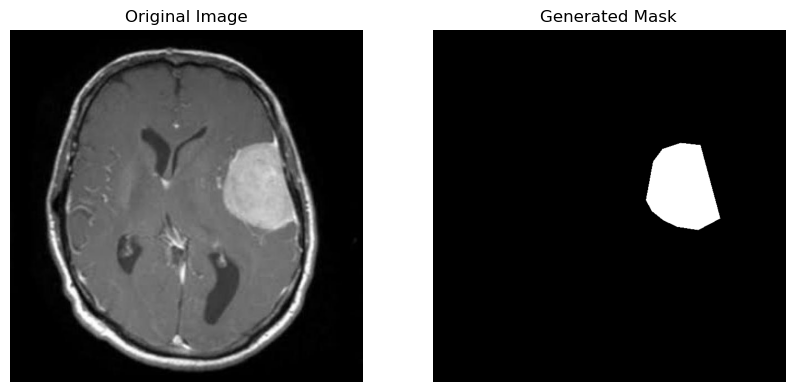

Loaded polygons for meningioma37_jpg.rf.138145f333ffbd1a16e01c4050479000.txt: [[(0.61328125, 0.1669921875), (0.5615234375, 0.150390625), (0.4775390625, 0.177734375), (0.470703125, 0.2099609375), (0.48828125, 0.2509765625), (0.556640625, 0.2724609375), (0.6044921875, 0.267578125), (0.62890625, 0.2490234375), (0.6328125, 0.2119140625), (0.61328125, 0.1669921875)]]
Drawing polygon: [(392, 106), (359, 96), (305, 113), (301, 134), (312, 160), (356, 174), (386, 171), (402, 159), (405, 135), (392, 106)]


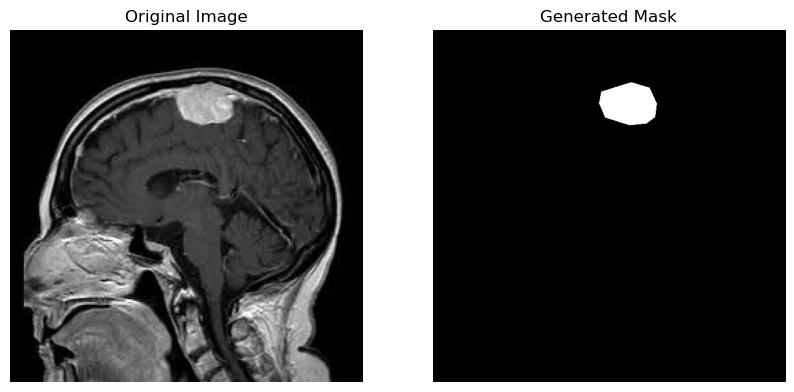

Loaded polygons for meningioma39_jpg.rf.71879046c9dd8a26bbc61285a8087fad.txt: [[(0.5174590328125, 0.328125), (0.4651904421875, 0.328125), (0.43905614843749996, 0.3447265625), (0.40978573906250004, 0.3876953109375), (0.4014227640625, 0.4306640640625), (0.4599635828125, 0.4501953109375), (0.5603192734375, 0.4287109359375), (0.5645007609375, 0.3935546890625), (0.5519563015625, 0.3544921875), (0.5174590328125, 0.328125)]]
Drawing polygon: [(331, 210), (297, 210), (280, 220), (262, 248), (256, 275), (294, 288), (358, 274), (361, 251), (353, 226), (331, 210)]


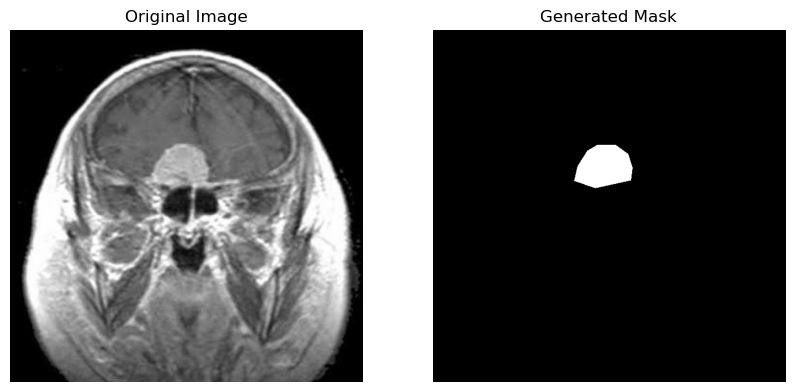

Loaded polygons for meningioma3_jpg.rf.b0a8b210d8aec7afdb1e57646339f45e.txt: [[(0.6376953125, 0.4609375), (0.7070312484375, 0.3837890625), (0.7226562484375, 0.3310546875), (0.720703125, 0.2802734375), (0.6982421875, 0.2226562484375), (0.6572265625, 0.1875), (0.6162109375, 0.1679687515625), (0.5830078125, 0.154296875), (0.5263671875, 0.1523437515625), (0.5185546875, 0.142578125), (0.5078125, 0.1513671875), (0.4990234375, 0.1796875), (0.4365234375, 0.1757812484375), (0.3955078125, 0.1914062484375), (0.384765625, 0.2021484375), (0.3789062484375, 0.2275390625), (0.341796875, 0.2939453125), (0.341796875, 0.3310546875), (0.353515625, 0.3642578125), (0.3515625, 0.4013671875), (0.375, 0.4697265625), (0.3935546875, 0.4921875), (0.4130859375, 0.501953125), (0.4882812484375, 0.5048828125), (0.5087890625, 0.494140625), (0.5556640625, 0.501953125), (0.5966796875, 0.4882812484375), (0.6376953125, 0.4609375)]]
Drawing polygon: [(408, 295), (452, 245), (462, 211), (461, 179), (446, 142), (420, 120), (

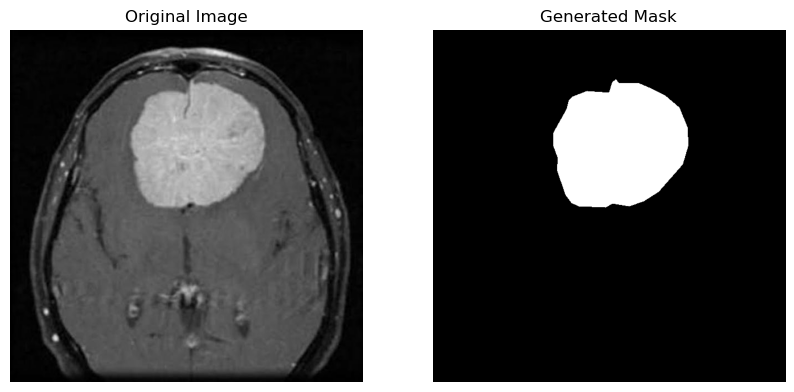

Loaded polygons for meningioma40_jpg.rf.3d5914c774222eb22962404e7759b849.txt: [[(0.724111128125, 0.123046875), (0.6990336875, 0.10156250156249999), (0.6572379500000001, 0.09375), (0.6279809359375, 0.10156250156249999), (0.6603726296875, 0.12207031406249999), (0.6561930578124999, 0.1943359375), (0.73560495625, 0.2783203140625), (0.8097923874999999, 0.251953125), (0.8526330171875, 0.1982421875), (0.79307409375, 0.1503906234375), (0.724111128125, 0.123046875)]]
Drawing polygon: [(463, 78), (447, 65), (420, 60), (401, 65), (422, 78), (419, 124), (470, 178), (518, 161), (545, 126), (507, 96), (463, 78)]


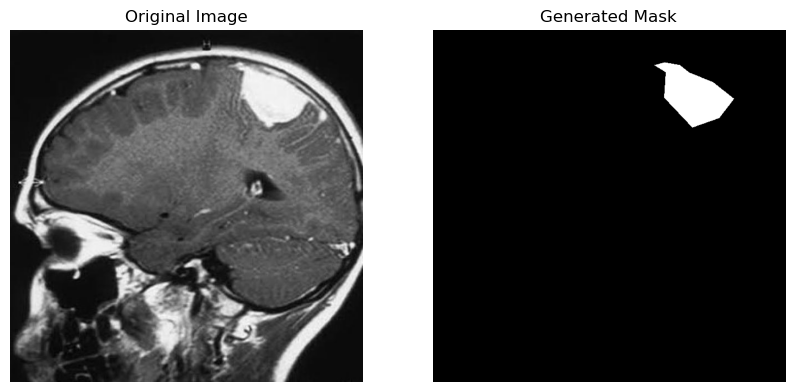

Loaded polygons for meningioma41_jpg.rf.f8d369b5f4cd1bccc4c250908c2383cc.txt: [[(0.42915709843750005, 0.1552734375), (0.40953848906249996, 0.1298828109375), (0.43038326250000003, 0.11914062656249999), (0.47942978593749996, 0.158203125), (0.48678676718749997, 0.10351562656249999), (0.4426448953125, 0.109375), (0.4254786109375, 0.09960937343750001), (0.3666227796875, 0.11328125), (0.266077403125, 0.1640624984375), (0.20844773437500003, 0.2060546875), (0.20722157187499998, 0.2128906265625), (0.23787564843750003, 0.2177734375), (0.268529728125, 0.2597656265625), (0.3482303328125, 0.2783203125), (0.361718125, 0.265625), (0.4107646515625, 0.25390625), (0.4365140765625, 0.2177734375), (0.42915709843750005, 0.1552734375)]]
Drawing polygon: [(274, 99), (262, 83), (275, 76), (306, 101), (311, 66), (283, 70), (272, 63), (234, 72), (170, 104), (133, 131), (132, 136), (152, 139), (171, 166), (222, 178), (231, 170), (262, 162), (279, 139), (274, 99)]


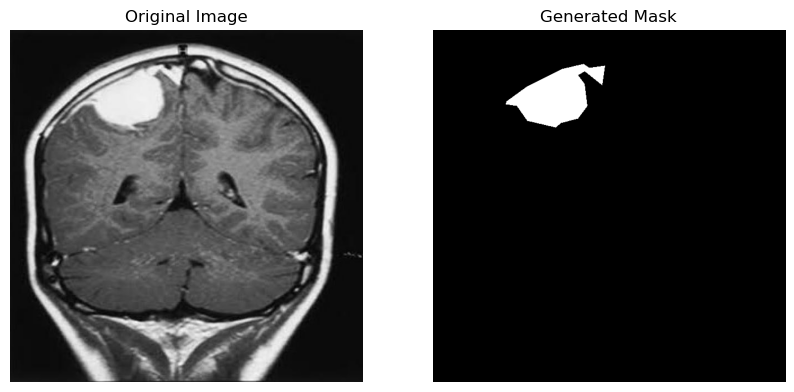

Loaded polygons for meningioma42_jpg.rf.69a4e48015c99808fcdd8f2252295075.txt: [[(0.5224609359375, 0.115234375), (0.4794921875, 0.12109375156249999), (0.4423828125, 0.115234375), (0.3789062484375, 0.1513671875), (0.373046875, 0.1728515640625), (0.3798828125, 0.189453125), (0.4384765640625, 0.2265625), (0.4755859359375, 0.232421875), (0.4882812484375, 0.2490234359375), (0.490234375, 0.2216796875), (0.529296875, 0.1767578125), (0.5351562484375, 0.1416015640625), (0.5224609359375, 0.115234375)]]
Drawing polygon: [(334, 73), (306, 77), (283, 73), (242, 96), (238, 110), (243, 121), (280, 145), (304, 148), (312, 159), (313, 141), (338, 113), (342, 90), (334, 73)]


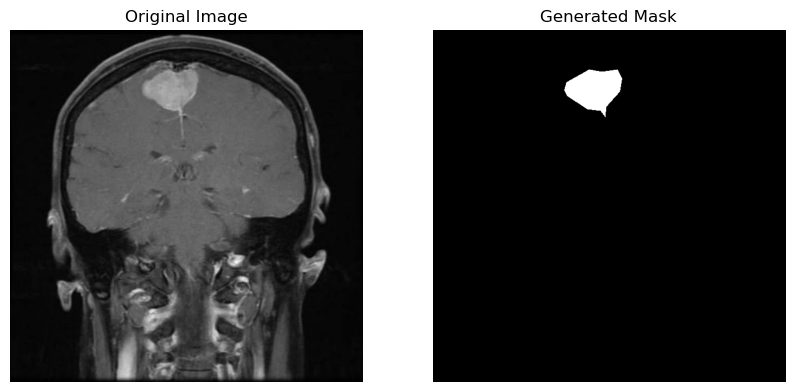

Loaded polygons for meningioma43_jpg.rf.7938f4911af02810376ad420e239e083.txt: [[(0.4969075515625, 0.103515625), (0.49165482968749996, 0.1298828109375), (0.5063624515625, 0.1552734359375), (0.5063624515625, 0.1865234359375), (0.530524975, 0.2109374984375), (0.5735973000000001, 0.2177734359375), (0.6072147250000001, 0.2001953125), (0.6051136359375, 0.1337890625), (0.559940221875, 0.103515625), (0.4969075515625, 0.103515625)]]
Drawing polygon: [(318, 66), (314, 83), (324, 99), (324, 119), (339, 134), (367, 139), (388, 128), (387, 85), (358, 66), (318, 66)]


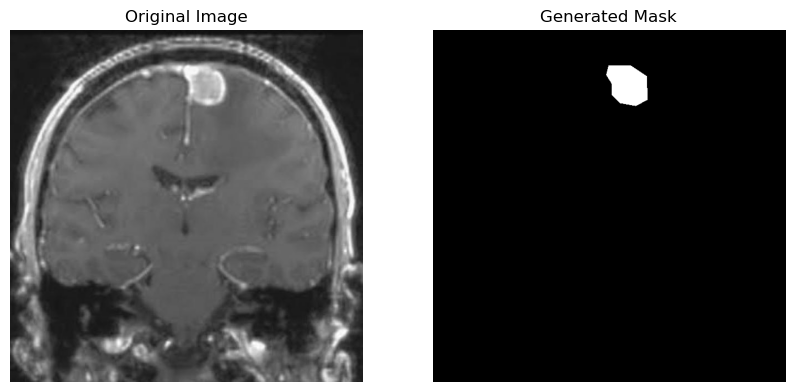

Loaded polygons for meningioma44_jpg.rf.5986909009b906ffdb6fd5efb44cf94d.txt: [[(0.6992187515625, 0.1884765640625), (0.6474609359375, 0.154296875), (0.5673828125, 0.123046875), (0.5302734359375, 0.119140625), (0.5048828125, 0.130859375), (0.490234375, 0.1494140640625), (0.490234375, 0.1767578125), (0.5078125, 0.2373046875), (0.5732421875, 0.287109375), (0.640625, 0.2919921875), (0.6865234359375, 0.271484375), (0.7109375, 0.2412109359375), (0.7148437515625, 0.2294921875), (0.6992187515625, 0.1884765640625)]]
Drawing polygon: [(447, 120), (414, 98), (363, 78), (339, 76), (323, 83), (313, 95), (313, 113), (325, 151), (366, 183), (410, 186), (439, 173), (455, 154), (457, 146), (447, 120)]


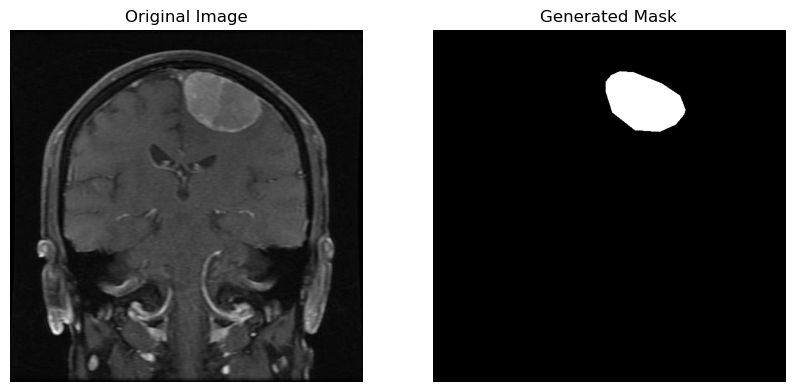

Loaded polygons for meningioma45_jpg.rf.982f69d82b665464671fd8ed98d712bf.txt: [[(0.6103515640625, 0.1953125), (0.5107421875, 0.203125), (0.5, 0.2353515640625), (0.505859375, 0.2861328125), (0.5400390640625, 0.326171875), (0.572265625, 0.3310546875), (0.6142578125, 0.314453125), (0.662109375, 0.2216796875), (0.693359375, 0.2119140640625), (0.6103515640625, 0.1953125)]]
Drawing polygon: [(390, 125), (326, 130), (320, 150), (323, 183), (345, 208), (366, 211), (393, 201), (423, 141), (443, 135), (390, 125)]


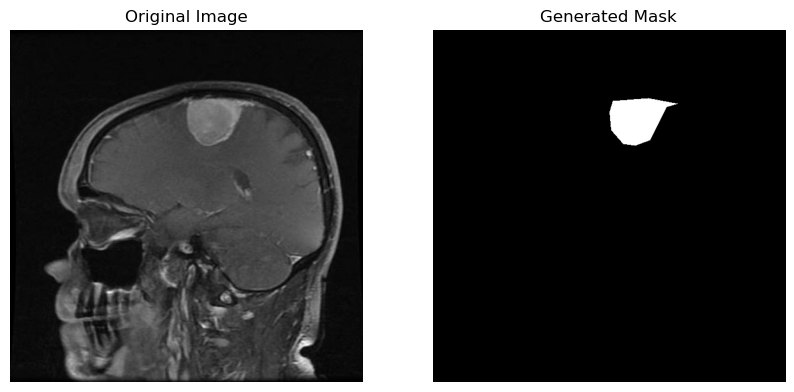

Loaded polygons for meningioma46_jpg.rf.1a0cf14408bc85539aa4a9edb7a6c282.txt: [[(0.5560153046874999, 0.333984375), (0.5959559125, 0.3359374984375), (0.637998659375, 0.322265625), (0.6958074328125, 0.2763671875), (0.69790956875, 0.2138671875), (0.6737349921875, 0.193359375), (0.5370960703125001, 0.1328125015625), (0.4719298140625, 0.12109375), (0.47718515781250004, 0.1298828125), (0.4582659234375, 0.1455078125), (0.470878746875, 0.1650390640625), (0.462470196875, 0.2802734375), (0.46667447187500005, 0.3349609359375), (0.47718515781250004, 0.3408203109375), (0.470878746875, 0.3017578125), (0.4971554625, 0.291015625), (0.522381109375, 0.29296875), (0.5560153046874999, 0.333984375)]]
Drawing polygon: [(355, 213), (381, 214), (408, 206), (445, 176), (446, 136), (431, 123), (343, 85), (302, 77), (305, 83), (293, 93), (301, 105), (295, 179), (298, 214), (305, 218), (301, 193), (318, 186), (334, 187), (355, 213)]


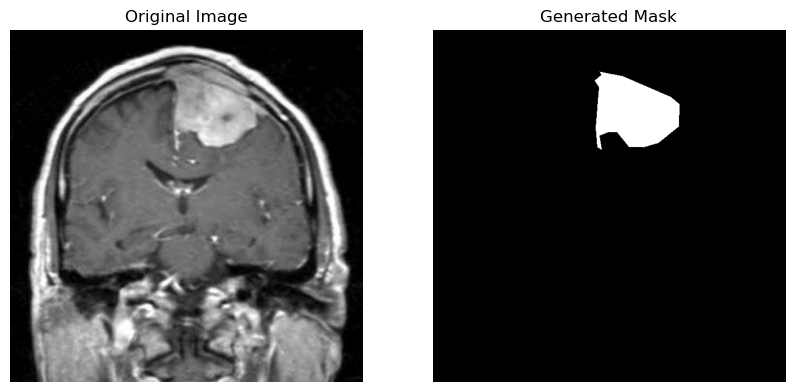

Loaded polygons for meningioma47_jpg.rf.ef504a28fd196407fa72365c6c69e93c.txt: [[(0.6699218765625, 0.136829721875), (0.6591796890625, 0.12162641874999999), (0.6025390625, 0.1114908859375), (0.4931640625, 0.11554509843750001), (0.4501953109375, 0.12162641874999999), (0.37109375, 0.1550736875), (0.4150390625, 0.22298177031250002), (0.4833984375, 0.2675781265625), (0.52734375, 0.2706187859375), (0.5791015625, 0.25136126718749996), (0.603515625, 0.19358872031250002), (0.6582031234375, 0.165209221875), (0.6699218765625, 0.136829721875)]]
Drawing polygon: [(428, 87), (421, 77), (385, 71), (315, 73), (288, 77), (237, 99), (265, 142), (309, 171), (337, 173), (370, 160), (386, 123), (421, 105), (428, 87)]


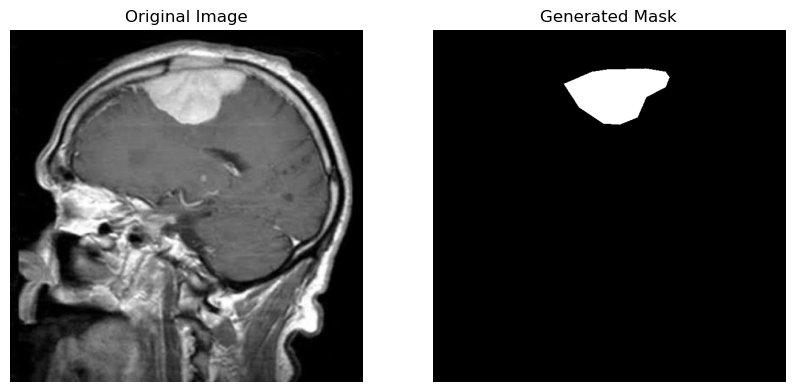

Loaded polygons for meningioma48_jpg.rf.214468f42eedb0b7856c12a161b6ec91.txt: [[(0.6113281234375, 0.1639811203125), (0.5996093765625, 0.1407063796875), (0.5976562484375, 0.1153157546875), (0.5712890640625, 0.09309895781250001), (0.5419921875, 0.08886718593750001), (0.5283203125, 0.099446615625), (0.5068359359375, 0.10579426875), (0.4941406234375, 0.119547528125), (0.4902343765625, 0.13224283750000002), (0.4902343765625, 0.15340169374999998), (0.4960937515625, 0.17244466249999998), (0.4941406234375, 0.21053059687500003), (0.4980468765625, 0.231689453125), (0.5146484359375, 0.251790365625), (0.5380859359375, 0.25813801875000003), (0.5605468765625, 0.257080078125), (0.5751953125, 0.251790365625), (0.6015625, 0.2338053375), (0.6113281234375, 0.20206705625), (0.6113281234375, 0.1639811203125)]]
Drawing polygon: [(391, 104), (383, 90), (382, 73), (365, 59), (346, 56), (338, 63), (324, 67), (316, 76), (313, 84), (313, 98), (317, 110), (316, 134), (318, 148), (329, 161), (344, 165), (358, 164)

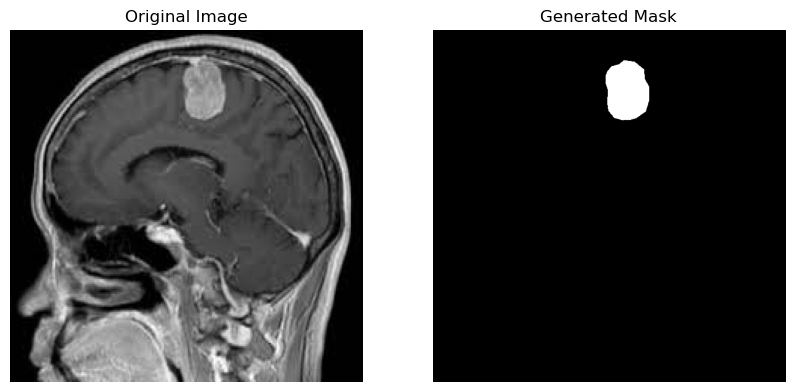

Loaded polygons for meningioma4_jpg.rf.4cf8ba5ec66e6bed5bf943484b60cd57.txt: [[(0.4208984359375, 0.520076309375), (0.3828125, 0.5620912046875), (0.3782051265625, 0.6574239734375), (0.44102564062500005, 0.70363745), (0.4782051265625, 0.71854501875), (0.49609375, 0.727879725), (0.49609375, 0.5893441125), (0.4697265640625, 0.5359738375), (0.4208984359375, 0.520076309375)]]
Drawing polygon: [(269, 332), (245, 359), (242, 420), (282, 450), (306, 459), (317, 465), (317, 377), (300, 343), (269, 332)]


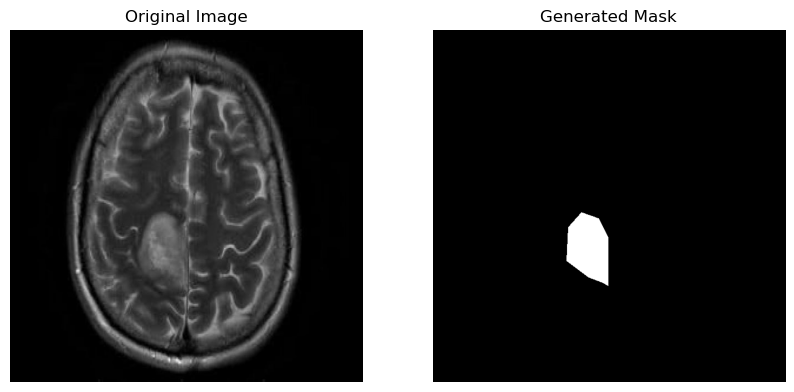

Loaded polygons for meningioma5_jpg.rf.c015031fa36804d49f8169aec9a18832.txt: [[(0.3549659125, 0.603515625), (0.2833407421875, 0.646484375), (0.2759675640625, 0.6650390625), (0.286500678125, 0.6962890625), (0.314940084375, 0.7226562515625), (0.364445715625, 0.7275390625), (0.39815167812499996, 0.7001953109375), (0.40657816875, 0.6435546890625), (0.3823520078125, 0.615234375), (0.3549659125, 0.603515625)]]
Drawing polygon: [(227, 386), (181, 413), (176, 425), (183, 445), (201, 462), (233, 465), (254, 448), (260, 411), (244, 393), (227, 386)]


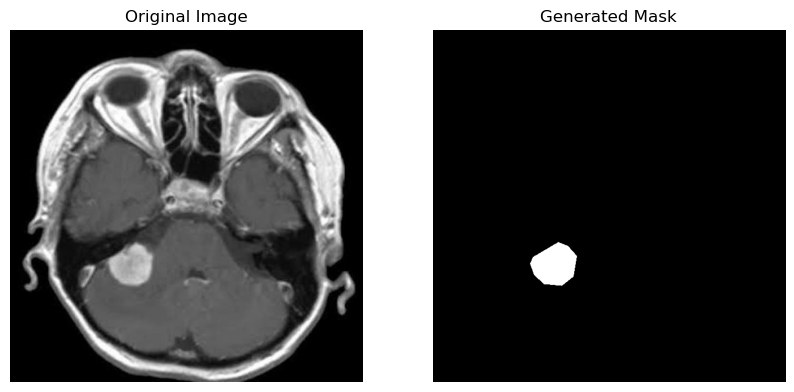

Loaded polygons for meningioma9_jpg.rf.c85bb291f4a93d2612d5529c9fac7d08.txt: [[(0.8439409375, 0.7001953125), (0.8191191453125001, 0.6904296875), (0.8116726062499999, 0.6650390625), (0.7781631875, 0.64453125), (0.728519603125, 0.634765625), (0.713626528125, 0.64453125), (0.6615007640624999, 0.650390625), (0.6404022406250001, 0.6650390625), (0.6130982687500001, 0.7275390625), (0.6304735234375001, 0.7783203125), (0.6503309578125, 0.7880859375), (0.66398294375, 0.806640625), (0.6912869140625, 0.81640625), (0.721073065625, 0.81640625), (0.7458948578125, 0.806640625), (0.7570646640625001, 0.8212890625), (0.7942973515625, 0.7978515625), (0.8067082484375, 0.7490234375), (0.8439409375, 0.7119140625), (0.8439409375, 0.7001953125)]]
Drawing polygon: [(540, 448), (524, 441), (519, 425), (498, 412), (466, 406), (456, 412), (423, 416), (409, 425), (392, 465), (403, 498), (416, 504), (424, 516), (442, 522), (461, 522), (477, 516), (484, 525), (508, 510), (516, 479), (540, 455), (540, 448)]


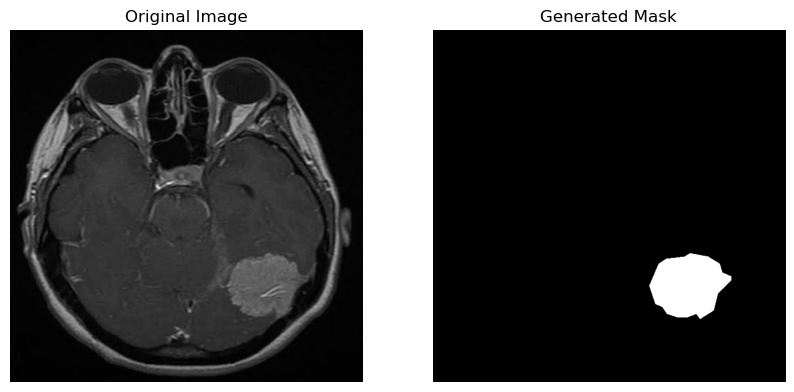

Loaded polygons for pituitary11_jpg.rf.df74c7f95b343930f097bb2ea63679b8.txt: [[(0.42079207968750004, 0.44059405937499996), (0.42079207968750004, 0.5049504953125), (0.40594059375, 0.5148514843750001), (0.4009900984375, 0.54950495), (0.3960396046875, 0.54950495), (0.4009900984375, 0.5841584156249999), (0.42079207968750004, 0.6039603953125), (0.425742575, 0.6386138609375), (0.46534653437499995, 0.633663365625), (0.4702970296875, 0.6485148515625), (0.490099009375, 0.6633663359375), (0.5396039609375001, 0.6633663359375), (0.5445544546875001, 0.653465346875), (0.5643564359375, 0.653465346875), (0.5643564359375, 0.6485148515625), (0.5891089109375, 0.653465346875), (0.6039603953125, 0.608910890625), (0.6138613859375, 0.6039603953125), (0.6237623765625, 0.5841584156249999), (0.608910890625, 0.524752475), (0.5990099015625, 0.5198019796875), (0.608910890625, 0.5049504953125), (0.608910890625, 0.485148515625), (0.6138613859375, 0.485148515625), (0.608910890625, 0.43564356406250004), (0.59405940625

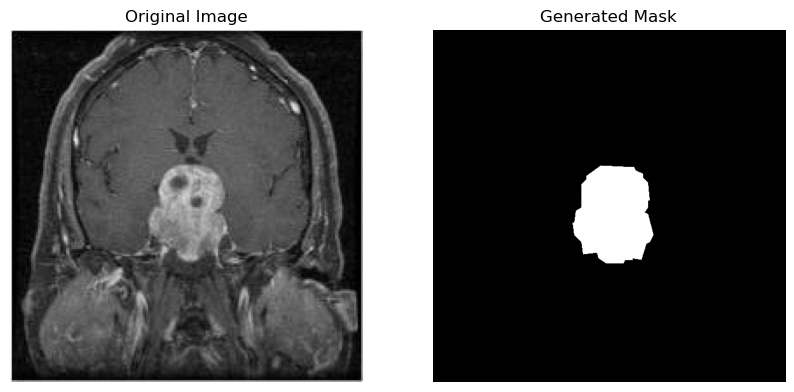

Loaded polygons for pituitary12_jpg.rf.ca825b950569694fcfd3725c454a1b35.txt: [[(0.4125, 0.540625), (0.4125, 0.55859375), (0.43359375, 0.596875), (0.45234375, 0.603125), (0.4953125, 0.60546875), (0.5078125, 0.60078125), (0.515625, 0.59375), (0.52578125, 0.57421875), (0.53203125, 0.55), (0.53125, 0.53046875), (0.52109375, 0.5046875), (0.50625, 0.48671875), (0.4828125, 0.471875), (0.4703125, 0.47109375), (0.446875, 0.48828125), (0.42578125, 0.51640625), (0.4125, 0.540625)]]
Drawing polygon: [(264, 346), (264, 357), (277, 382), (289, 386), (317, 387), (325, 384), (330, 380), (336, 367), (340, 352), (340, 339), (333, 323), (324, 311), (309, 302), (301, 301), (286, 312), (272, 330), (264, 346)]


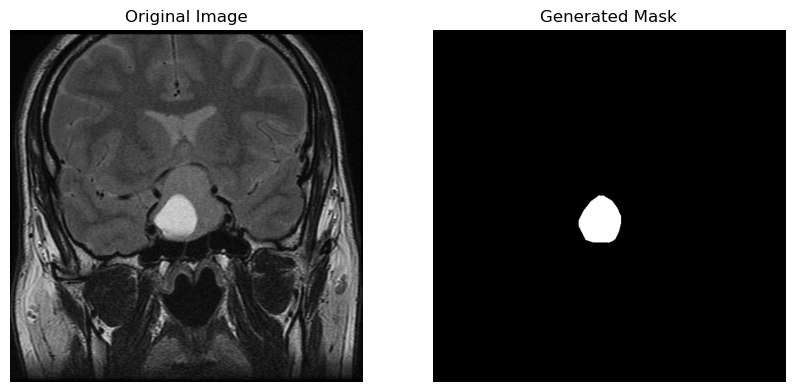

Loaded polygons for pituitary13_jpg.rf.745fda83faa316e9e6415354aa25ba08.txt: [[(0.3325688078125, 0.652680653125), (0.40825688125, 0.659673659375), (0.45642201875, 0.6083916078125), (0.458715596875, 0.5734265734374999), (0.43807339375, 0.55011655), (0.39449541250000003, 0.559440559375), (0.35091743124999997, 0.5291375296874999), (0.30963302812500004, 0.55011655), (0.30733945, 0.6200466203125), (0.3325688078125, 0.652680653125)]]
Drawing polygon: [(212, 417), (261, 422), (292, 389), (293, 366), (280, 352), (252, 358), (224, 338), (198, 352), (196, 396), (212, 417)]


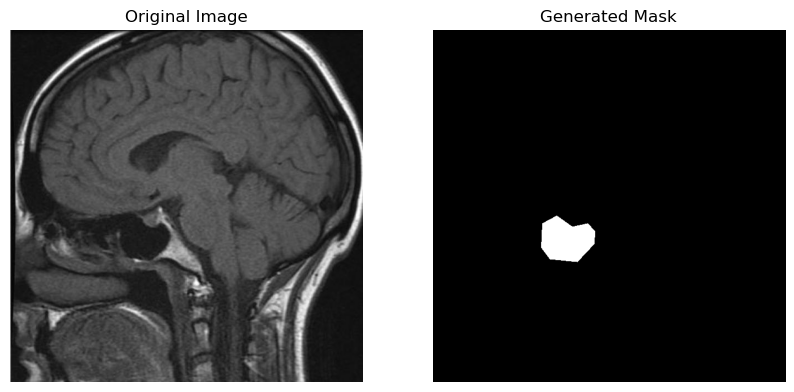

Loaded polygons for pituitary15_jpg.rf.562df86c1c0a699b01a2d8f1a4d8c2ab.txt: [[(0.4658203125, 0.458984375), (0.431640625, 0.4833984375), (0.4257812515625, 0.5068359375), (0.4335937484375, 0.5400390625), (0.4423828125, 0.552734375), (0.4794921875, 0.5546875), (0.498046875, 0.5634765625), (0.498046875, 0.5224609375), (0.515625, 0.4814453125), (0.5029296875, 0.4648437484375), (0.4658203125, 0.458984375)]]
Drawing polygon: [(298, 293), (276, 309), (272, 324), (277, 345), (283, 353), (306, 355), (318, 360), (318, 334), (330, 308), (321, 297), (298, 293)]


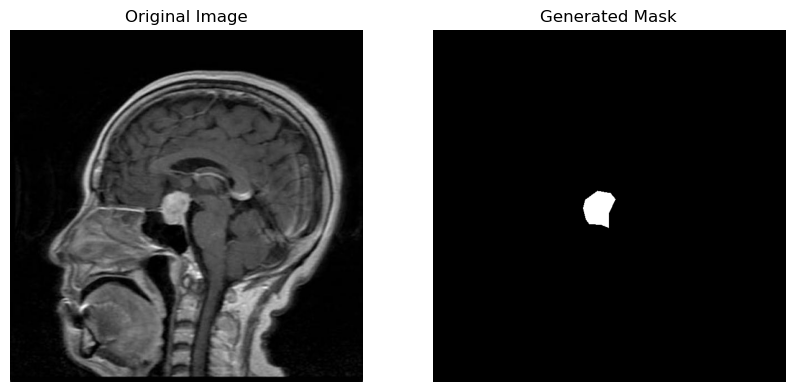

Loaded polygons for pituitary18_jpg.rf.d8e2b77a6634785de46d861affbc30a8.txt: [[(0.4, 0.5423280421875), (0.44166666718750003, 0.603174603125), (0.5083333328124999, 0.603174603125), (0.5416666671875, 0.566137565625), (0.5361111109375, 0.502645503125), (0.5138888890625, 0.4761904765625), (0.47222222187499996, 0.4761904765625), (0.427777778125, 0.4894179890625), (0.40277777812500004, 0.521164021875), (0.4, 0.5423280421875)]]
Drawing polygon: [(256, 347), (282, 386), (325, 386), (346, 362), (343, 321), (328, 304), (302, 304), (273, 313), (257, 333), (256, 347)]


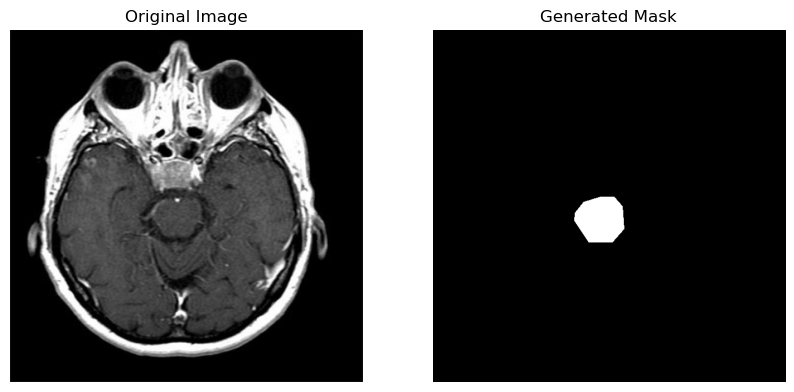

Loaded polygons for pituitary1_jpg.rf.8412b11aa0d3018aa2de30a4feb0ea3a.txt: [[(0.48046875, 0.5390625), (0.525390625, 0.546875), (0.533203125, 0.5390625), (0.533203125, 0.509765625), (0.548828125, 0.46484375), (0.54296875, 0.453125), (0.501953125, 0.435546875), (0.46484375, 0.45703125), (0.45703125, 0.4921875), (0.48046875, 0.5390625)]]
Drawing polygon: [(307, 345), (336, 350), (341, 345), (341, 326), (351, 297), (347, 290), (321, 278), (297, 292), (292, 315), (307, 345)]


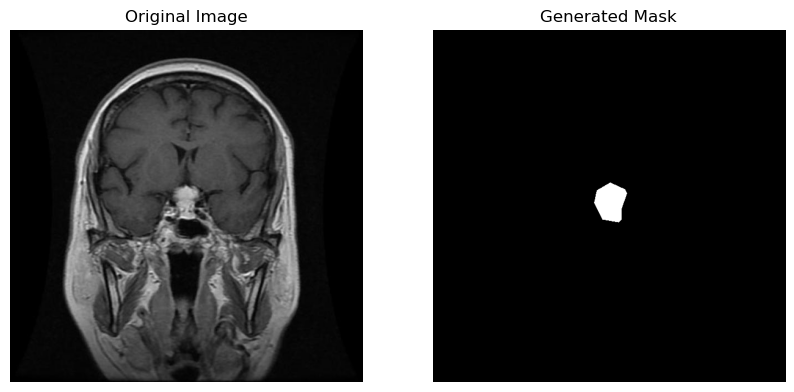

Loaded polygons for pituitary21_jpg.rf.28007013f53cc5d16983c8c8fc286ba9.txt: [[(0.4261603375, 0.521097046875), (0.4324894515625, 0.5464135015625), (0.44303797500000003, 0.5590717296875), (0.4894514765625, 0.5675105484375), (0.49156118125, 0.586497890625), (0.5063291140625, 0.6033755281250001), (0.5126582281250001, 0.4767932484375), (0.4978902953125, 0.46202531718750006), (0.45358649843750004, 0.4578059078125), (0.44092827031250004, 0.46202531718750006), (0.430379746875, 0.48312236249999996), (0.4261603375, 0.521097046875)]]
Drawing polygon: [(272, 333), (276, 349), (283, 357), (313, 363), (314, 375), (324, 386), (328, 305), (318, 295), (290, 292), (282, 295), (275, 309), (272, 333)]


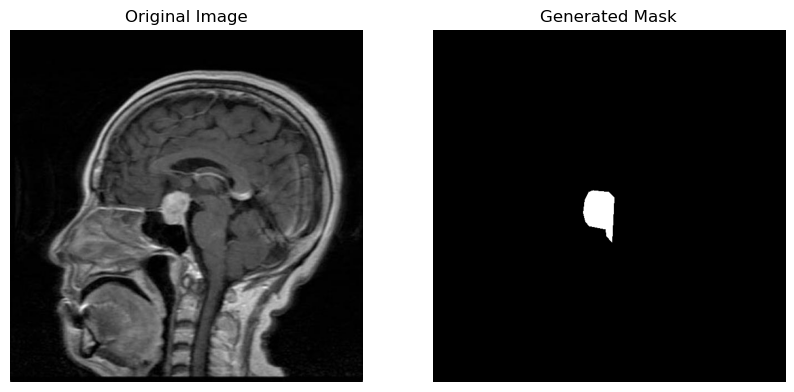

Loaded polygons for pituitary22_jpg.rf.5a39a9ae530513eff25418854e197744.txt: [[(0.46170212812500006, 0.553240740625), (0.46808510625000005, 0.590277778125), (0.5, 0.5995370375), (0.5765957453125, 0.5995370375), (0.6085106390624999, 0.6180555562500001), (0.6361702124999999, 0.5509259265625001), (0.634042553125, 0.48842592656250006), (0.5851063828124999, 0.47222222187499996), (0.5531914890625, 0.47453703750000004), (0.5361702125, 0.4583333328125), (0.5212765953125, 0.4583333328125), (0.4893617015625, 0.4699074078125), (0.46808510625000005, 0.5), (0.46170212812500006, 0.553240740625)]]
Drawing polygon: [(295, 354), (299, 377), (320, 383), (369, 383), (389, 395), (407, 352), (405, 312), (374, 302), (354, 303), (343, 293), (333, 293), (313, 300), (299, 320), (295, 354)]


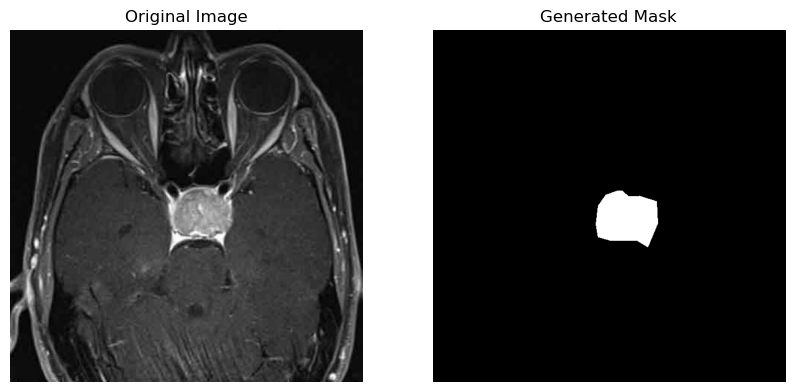

Loaded polygons for pituitary24_jpg.rf.e00c78703b46c69e1475f8f059dcaf64.txt: [[(0.47263681562500004, 0.31904761875), (0.4577114421875, 0.32380952343749997), (0.4577114421875, 0.3333333328125), (0.44776119375, 0.33809523750000003), (0.44776119375, 0.347619046875), (0.4378109453125, 0.352380953125), (0.4378109453125, 0.36666666718749996), (0.4328358203125, 0.36666666718749996), (0.4328358203125, 0.41904761874999996), (0.4378109453125, 0.41904761874999996), (0.44776119375, 0.4952380953125), (0.4328358203125, 0.5047619046875), (0.427860696875, 0.5333333328125), (0.44776119375, 0.5333333328125), (0.4577114421875, 0.5238095234375), (0.48756218906250004, 0.5190476187499999), (0.48756218906250004, 0.5238095234375), (0.5572139296875, 0.5238095234375), (0.5572139296875, 0.528571428125), (0.5721393031249999, 0.528571428125), (0.5721393031249999, 0.5333333328125), (0.5870646765624999, 0.5333333328125), (0.5870646765624999, 0.5380952375), (0.6368159203125, 0.5333333328125), (0.6417910453125, 0.5142

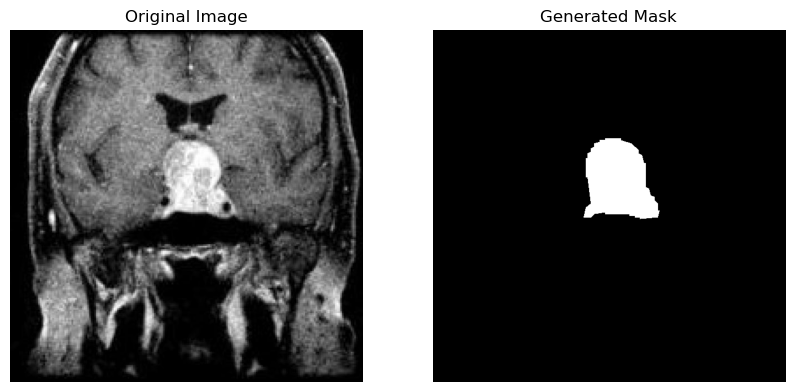

Loaded polygons for pituitary27_jpg.rf.abf8592a25928439880ae99063899c4e.txt: [[(0.3800904984375, 0.4841628953125), (0.3710407234375, 0.5475113125), (0.382352940625, 0.54977375625), (0.404977375, 0.58823529375), (0.432126696875, 0.610859728125), (0.6040723984375, 0.6063348421875), (0.6266968328125, 0.58597285), (0.6289592765625, 0.572398190625), (0.615384615625, 0.54977375625), (0.6176470593750001, 0.479638009375), (0.6040723984375, 0.44570135781250003), (0.54977375625, 0.3959276015625), (0.5113122171875, 0.384615384375), (0.48868778281249997, 0.3552036203125), (0.4434389140625, 0.3484162890625), (0.40950226250000005, 0.37556561093749996), (0.41176470624999995, 0.436651584375), (0.3800904984375, 0.4841628953125)]]
Drawing polygon: [(243, 309), (237, 350), (244, 351), (259, 376), (276, 390), (386, 388), (401, 375), (402, 366), (393, 351), (395, 306), (386, 285), (351, 253), (327, 246), (312, 227), (283, 222), (262, 240), (263, 279), (243, 309)]


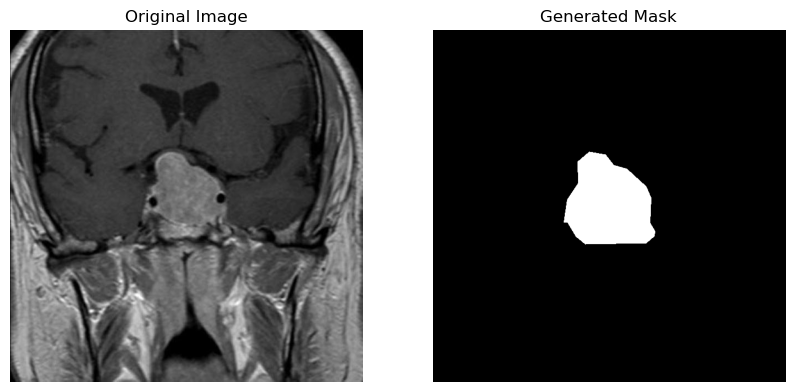

Loaded polygons for pituitary29_jpg.rf.0ae350c14e861272e65066085f5963da.txt: [[(0.349358975, 0.6013179578125001), (0.365384615625, 0.6276771), (0.3958333328125, 0.63097199375), (0.4262820515625, 0.6227347609375), (0.44391025624999997, 0.6095551890625), (0.4487179484375, 0.5963756171875), (0.4647435890625, 0.5387149921875001), (0.4615384609375, 0.5140032953125), (0.43589743593749997, 0.49258649062500004), (0.40865384687499995, 0.4876441515625), (0.384615384375, 0.49588138437499996), (0.349358975, 0.530477759375), (0.349358975, 0.6013179578125001)]]
Drawing polygon: [(223, 384), (233, 401), (253, 403), (272, 398), (284, 390), (287, 381), (297, 344), (295, 328), (278, 315), (261, 312), (246, 317), (223, 339), (223, 384)]


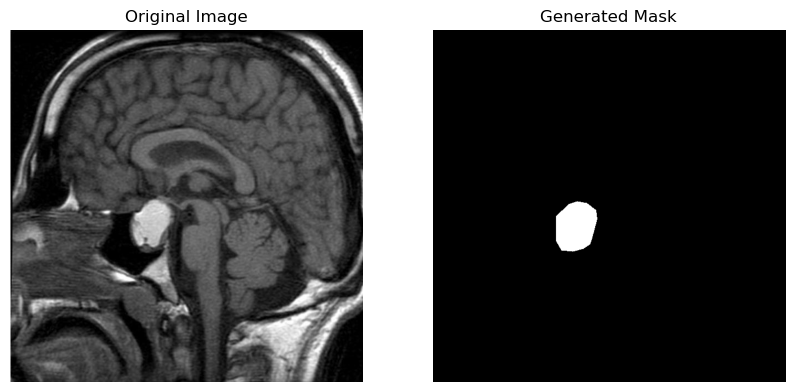

Loaded polygons for pituitary2_jpg.rf.f13d93daef83874b88d3a966ca09ca0f.txt: [[(0.32786885312499997, 0.560546875), (0.35040983593749997, 0.587890625), (0.366803278125, 0.595703125), (0.42622950781249996, 0.58984375), (0.45696721250000005, 0.595703125), (0.46516393437500003, 0.58984375), (0.471311475, 0.556640625), (0.450819671875, 0.521484375), (0.3729508203125, 0.4921875), (0.33811475468749996, 0.48828125), (0.3360655734375, 0.509765625), (0.31967213125, 0.537109375), (0.32786885312499997, 0.560546875)]]
Drawing polygon: [(209, 358), (224, 376), (234, 381), (272, 377), (292, 381), (297, 377), (301, 356), (288, 333), (238, 315), (216, 312), (215, 326), (204, 343), (209, 358)]


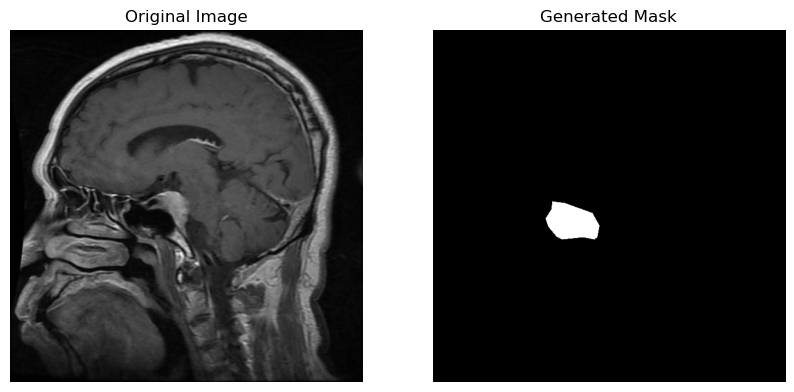

Loaded polygons for pituitary33_jpg.rf.a660d9eb9d3203a0a67f372792bc54e7.txt: [[(0.422471909375, 0.490783409375), (0.41348314531249997, 0.50614439375), (0.42921348281249994, 0.548387096875), (0.42921348281249994, 0.5583717359375), (0.41947565468750003, 0.5921658984375), (0.42022471875, 0.6090629796875), (0.4247191015625, 0.622119815625), (0.447940075, 0.6359447), (0.48614232187499995, 0.6497695859375), (0.5460674156249999, 0.65284178125), (0.5730337078125001, 0.6490015359375), (0.5842696625, 0.65284178125), (0.5917603, 0.6459293390624999), (0.59625468125, 0.632872503125), (0.597752809375, 0.5921658984375), (0.589513109375, 0.5614439328125), (0.5857677906250001, 0.5222734250000001), (0.577528090625, 0.502304146875), (0.5610486890625, 0.4846390171875), (0.541573034375, 0.47311827968750003), (0.48913857656250004, 0.46159754218750004), (0.4674157296875, 0.46082949375000004), (0.456179775, 0.463133640625), (0.4434456921875, 0.47081413281250006), (0.422471909375, 0.490783409375)]]
Drawing pol

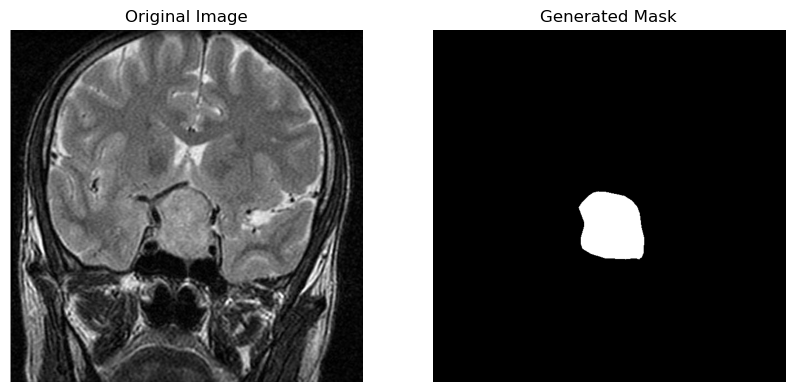

Loaded polygons for pituitary44_jpg.rf.f877e4500c9940d62778f578a7470da5.txt: [[(0.462890625, 0.5496200625000001), (0.46484375, 0.527351846875), (0.455078125, 0.5091323984375), (0.4189453125, 0.48585199062499995), (0.3876953125, 0.493949521875), (0.3642578125, 0.5222908890625), (0.34765625, 0.52937623125), (0.337890625, 0.5556932140625), (0.33984375, 0.5901077296875), (0.349609375, 0.614400328125), (0.3759765625, 0.635656353125), (0.3984375015625, 0.6366685453125001), (0.4228515625, 0.6275588203125), (0.4375, 0.6103515625), (0.4453124984375, 0.569863896875), (0.462890625, 0.5496200625000001)]]
Drawing polygon: [(296, 351), (297, 337), (291, 325), (268, 310), (248, 316), (233, 334), (222, 338), (216, 355), (217, 377), (223, 393), (240, 406), (255, 407), (270, 401), (280, 390), (284, 364), (296, 351)]


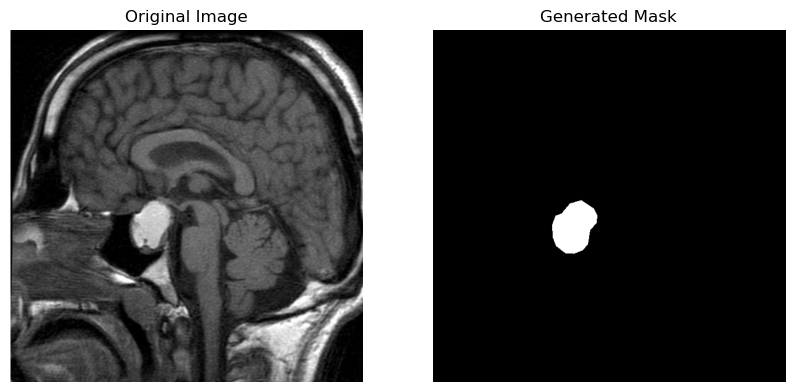

Loaded polygons for pituitary46_jpg.rf.5a8bbfa462db8fe9372c88224ea35ae1.txt: [[(0.42079207968750004, 0.3514851484375), (0.42079207968750004, 0.44059405937499996), (0.425742575, 0.44059405937499996), (0.425742575, 0.4603960390625), (0.43069306875, 0.4603960390625), (0.43069306875, 0.4801980203125), (0.43564356406250004, 0.4801980203125), (0.44059405937499996, 0.524752475), (0.4455445546875, 0.524752475), (0.4554455453125, 0.54950495), (0.46534653437499995, 0.54950495), (0.4702970296875, 0.559405940625), (0.490099009375, 0.5643564359375), (0.490099009375, 0.56930693125), (0.5643564359375, 0.56930693125), (0.5643564359375, 0.5643564359375), (0.5792079203125, 0.559405940625), (0.574257425, 0.5), (0.5792079203125, 0.5), (0.5841584156249999, 0.45049504999999995), (0.5891089109375, 0.45049504999999995), (0.5891089109375, 0.43564356406250004), (0.59405940625, 0.43564356406250004), (0.59405940625, 0.4009900984375), (0.5990099015625, 0.4009900984375), (0.59405940625, 0.3514851484375), (0.5891089

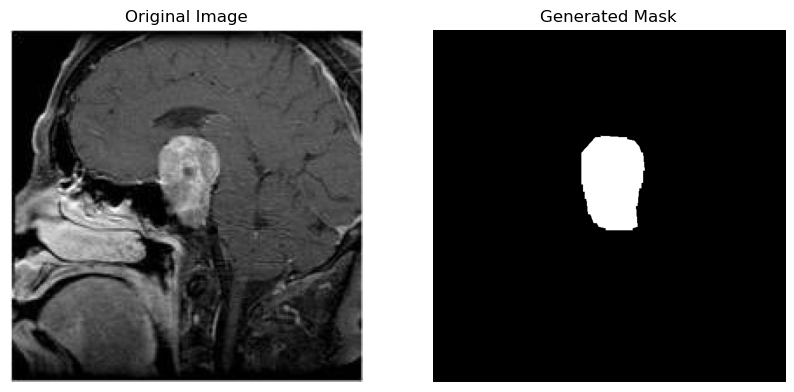

Loaded polygons for pituitary6_jpg.rf.469e20606dc945993f91a902c3070318.txt: [[(0.3945147671875, 0.4282700421875), (0.3881856546875, 0.4578059078125), (0.40506329062499996, 0.5063291140625), (0.3628691984375, 0.5400843875), (0.35232067499999997, 0.5590717296875), (0.348101265625, 0.635021096875), (0.3628691984375, 0.6835443031249999), (0.38185654062499996, 0.69620253125), (0.44303797500000003, 0.7025316453125), (0.4978902953125, 0.7320675109375), (0.521097046875, 0.734177215625), (0.6118143453125, 0.6898734171875), (0.63924050625, 0.6624472578125), (0.6413502109375, 0.6413502109375), (0.5843881859375, 0.5316455703125), (0.586497890625, 0.45358649843750004), (0.521097046875, 0.3987341765625), (0.495780590625, 0.396624471875), (0.45569620312500003, 0.4156118140625), (0.4198312234375, 0.4156118140625), (0.3945147671875, 0.4282700421875)]]
Drawing polygon: [(252, 274), (248, 292), (259, 324), (232, 345), (225, 357), (222, 406), (232, 437), (244, 445), (283, 449), (318, 468), (333, 469), (39

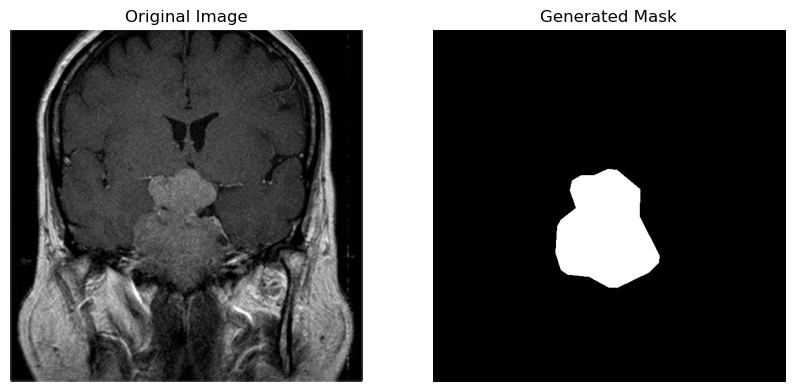

Image volume shape: (102, 640, 640, 3)
Mask volume shape: (102, 640, 640)
Training dataset prepared.


In [5]:
#I had some problems with the masks above, but managed to sort them out here. Initially, I could not get the polygon
#to create a mask which was not just a dark screen, then it I got rectangles but not polygons around the tumor as above,
#finally I got the accurate masks displayed below.

import os
import numpy as np
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt

# Paths
labels_folder = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/train/labels"
images_folder = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/train/images"

# Initialize arrays for images and masks
volume_images = []
volume_masks = []

def create_mask_from_polygons(polygons, img_width, img_height):
    """Create a binary mask from normalized polygon coordinates."""
    # Create a blank black image
    mask = Image.new('L', (img_width, img_height), 0)  
    draw = ImageDraw.Draw(mask)
    
    for polygon in polygons:
        if not polygon:
            print("Empty polygon detected, skipping.")
            continue
        
        # Scale the normalized coordinates to image dimensions
        scaled_polygon = [(int(x * img_width), int(y * img_height)) for x, y in polygon]
        print(f"Drawing polygon: {scaled_polygon}")  # Debug scaled polygon coordinates
        draw.polygon(scaled_polygon, outline=1, fill=1)  # Draw precise polygons
    
    # Convert to a binary NumPy array
    return np.array(mask, dtype=np.uint8)

# Iterate through label files
for label_file in sorted(os.listdir(labels_folder)):
    if label_file.endswith('.txt'):  # Check for label files
        # Load polygons and labels
        label_path = os.path.join(labels_folder, label_file)
        polygons, _ = load_polygon_from_file(label_path)  # Ensure this function is correct
        
        # Debug polygons
        print(f"Loaded polygons for {label_file}: {polygons}")
        
        # Find the corresponding image file
        image_file = label_file.replace('.txt', '.jpg')  # Adjust extension as needed
        image_path = os.path.join(images_folder, image_file)
        
        if os.path.exists(image_path):
            # Load the image
            img = Image.open(image_path)
            img_width, img_height = img.size
            img_array = np.array(img)
            
            # Create a precise mask from the polygons
            mask_array = create_mask_from_polygons(polygons, img_width, img_height)
            
            # Add image and mask to volumes
            volume_images.append(img_array)
            volume_masks.append(mask_array)
            
            # Visualize the image and mask in the notebook
            plt.figure(figsize=(10, 5))
            
            plt.subplot(1, 2, 1)
            plt.imshow(img_array)
            plt.title("Original Image")
            plt.axis("off")
            
            plt.subplot(1, 2, 2)
            plt.imshow(mask_array, cmap="gray")
            plt.title("Generated Mask")
            plt.axis("off")
            
            plt.show()
        else:
            print(f"Image not found for label file: {label_file}")

# Convert to NumPy arrays
if volume_images and volume_masks:
    volume_images = np.stack(volume_images)  # Shape: (num_images, height, width, channels)
    volume_masks = np.stack(volume_masks)    # Shape: (num_images, height, width)

    # Normalize images and masks
    volume_images = volume_images / 255.0  # Scale images to [0, 1]
    volume_masks = volume_masks.astype('float32')  # Ensure masks are float32

    print(f"Image volume shape: {volume_images.shape}")
    print(f"Mask volume shape: {volume_masks.shape}")
else:
    print("No valid images or masks were created.")

print("Training dataset prepared.")


In [6]:
#I wanted to start with a complex model to see how accurate I could predict segmentation from the full-sized images
#with as many convolutions as were recommended.

from tensorflow.keras.layers import Conv2D, MaxPooling2D, Conv2DTranspose, concatenate, Input
from tensorflow.keras.models import Model

def unet_model(input_shape=(640, 640, 3), num_classes=2):
    inputs = Input(input_shape)
    
    # Encoder
    c1 = Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    c1 = Conv2D(32, (3, 3), activation='relu', padding='same')(c1)
    p1 = MaxPooling2D((2, 2))(c1)
    
    c2 = Conv2D(64, (3, 3), activation='relu', padding='same')(p1)
    c2 = Conv2D(64, (3, 3), activation='relu', padding='same')(c2)
    p2 = MaxPooling2D((2, 2))(c2)
    
    # Bottleneck
    c3 = Conv2D(128, (3, 3), activation='relu', padding='same')(p2)
    c3 = Conv2D(128, (3, 3), activation='relu', padding='same')(c3)
    
    # Decoder
    u1 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c3)
    u1 = concatenate([u1, c2])
    c4 = Conv2D(64, (3, 3), activation='relu', padding='same')(u1)
    c4 = Conv2D(64, (3, 3), activation='relu', padding='same')(c4)
    
    u2 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c4)
    u2 = concatenate([u2, c1])
    c5 = Conv2D(32, (3, 3), activation='relu', padding='same')(u2)
    c5 = Conv2D(32, (3, 3), activation='relu', padding='same')(c5)
    
    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c5)
    
    model = Model(inputs, outputs)
    return model

# Create the model
model = unet_model(input_shape=(640, 640, 3), num_classes=2)
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

model.summary()



Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 640, 640,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 640, 640,  │        896 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 640, 640,  │      9,248 │ conv2d[0][0]      │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 320, 320,  │          0 │ conv2d_1[0][0]    │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 320, 320,  │     18,496 │ max_pooling2d[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 320, 320,  │     36,928 │ conv2d_2[0][0]    │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 160, 160,  │          0 │ conv2d_3[0][0]    │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 160, 160,  │     73,856 │ max_pooling2d_1[… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 160, 160,  │    147,584 │ conv2d_4[0][0]    │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose    │ (None, 320, 320,  │     32,832 │ conv2d_5[0][0]    │
│ (Conv2DTranspose)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 320, 320,  │          0 │ conv2d_transpose… │
│ (Concatenate)       │ 128)              │            │ conv2d_3[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_6 (Conv2D)   │ (None, 320, 320,  │     73,792 │ concatenate[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_7 (Conv2D)   │ (None, 320, 320,  │     36,928 │ conv2d_6[0][0]    │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_1  │ (None, 640, 640,  │      8,224 │ conv2d_7[0][0]    │
│ (Conv2DTranspose)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_1       │ (None, 640, 640,  │          0 │ conv2d_transpose… │
│ (Concatenate)       │ 64)               │            │ conv2d_1[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_8 (Conv2D)   │ (None, 640, 640,  │     18,464 │ concatenate_1[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_9 (Conv2D)   │ (None, 640, 640,  │      9,248 │ conv2d_8[0][0]  

 Total params: 466,529 (1.78 MB)

 Trainable params: 466,529 (1.78 MB)

 Non-trainable params: 0 (0.00 B)

In [11]:
#Here I rename the data and polygons, compile the model, and run it.

#Renaming the volumes
train_data = volume_images
train_masks = volume_masks

#Compiling the model
model.compile(optimizer='adam', 
              loss='binary_crossentropy', 
              metrics=['accuracy'])

# Ensure your masks are integers representing class indices
train_masks = train_masks.astype('int32')

# Train the model
training = model.fit(train_data, train_masks, epochs=1, validation_split=0.2)

3/3 ━━━━━━━━━━━━━━━━━━━━ 777s 230s/step - accuracy: 0.9763 - loss: 0.6543 - val_accuracy: 0.9758 - val_loss: 0.4915


In [11]:
#I start evaluating the data by saving the model details and looking at the loss.

#Generating a checkpoint and saving the node weights
checkpoint = ModelCheckpoint('weights.keras', monitor='val_loss', save_best_only=True)
callbacks = [checkpoint]
print(callbacks)

# Plot the loss and validation loss
plt.plot(training.history['loss'], label='Training Loss')
plt.plot(training.history['val_loss'], label='Validation Loss')

# Add axis labels
plt.xlabel('Epochs')
plt.ylabel('Loss')

# Add a legend to distinguish the lines
plt.legend()

# Display the plot
plt.show()


NameError: name 'training' is not defined

In [9]:
#Now let's see how the model performs on the test data and whether I need to adjust training data.

Loaded volume shape: (15, 640, 640, 3)


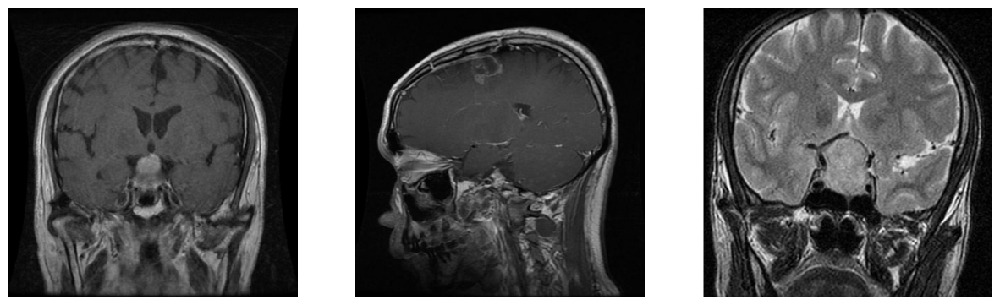

In [62]:
#I have all of the images stored with their labels in a dictionary, but for batch processing and viewing I will create 
# a volume.

folder_path = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/test/images"

# Load all images in the folder as a volume
volume = []

for filename in sorted(os.listdir(folder_path)):  # Sort to maintain order
    if filename.endswith(('.jpg', '.jpeg', '.png', '.bmp')):
        filepath = os.path.join(folder_path, filename)
        try:
            # Open the image with Pillow
            img = Image.open(filepath)
            # Convert to a NumPy array and append to the volume
            volume.append(np.array(img))
        except Exception as e:
            print(f"Error loading image {filepath}: {e}")

# Convert the volume list to a 3D NumPy array
volume = np.stack(volume)

print(f"Loaded volume shape: {volume.shape}")  # (Number of images, height, width)

# Display a few slices from the volume
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
axes[0].imshow(volume[0], cmap='gray')
axes[1].imshow(volume[len(volume) // 2], cmap='gray')
axes[2].imshow(volume[-1], cmap='gray')
for ax in axes:
    ax.axis('off')
plt.show()

Loaded polygons for Tr-piTr_0004_jpg.rf.44dee87c8693e404a864ae4f4ee60595.txt: [[(0.436448315625, 0.60546875), (0.455979565625, 0.625), (0.5048076921875, 0.640625), (0.5477764421875, 0.607421875), (0.5106670671875, 0.505859375), (0.491135815625, 0.505859375), (0.450120190625, 0.5234375), (0.438401440625, 0.55859375), (0.436448315625, 0.60546875)]]
Drawing polygon: [(279, 387), (291, 400), (323, 410), (350, 388), (326, 323), (314, 323), (288, 335), (280, 357), (279, 387)]


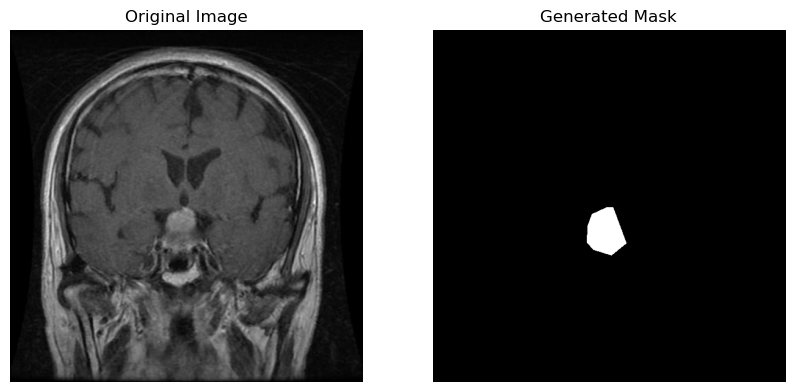

Loaded polygons for Tr-pi_1444_jpg.rf.29369c8b378bfbdba901805c7f670dd1.txt: [[(0.52734375, 0.537109375), (0.5390625, 0.603515625), (0.58984375, 0.619140625), (0.625, 0.595703125), (0.63671875, 0.5625), (0.63671875, 0.537109375), (0.625, 0.49609375), (0.61328125, 0.482421875), (0.572265625, 0.474609375), (0.537109375, 0.490234375), (0.52734375, 0.51171875), (0.52734375, 0.537109375)]]
Drawing polygon: [(337, 343), (345, 386), (377, 396), (400, 381), (407, 360), (407, 343), (400, 317), (392, 308), (366, 303), (343, 313), (337, 327), (337, 343)]


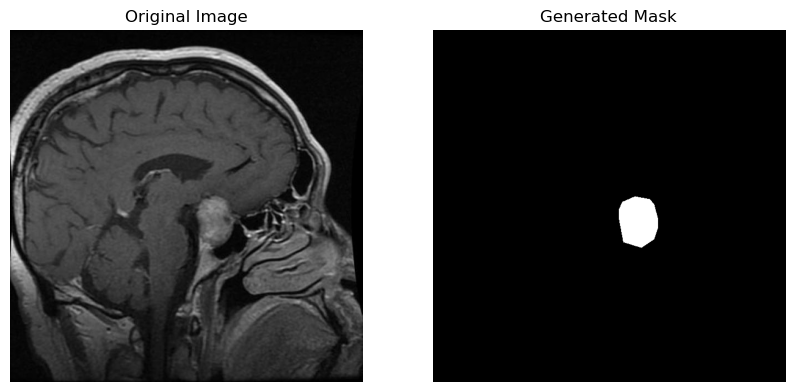

Loaded polygons for Tr-pi_1450_jpg.rf.9f38c63beab032ac62d81304e081b55e.txt: [[(0.435546875, 0.494140625), (0.44140625, 0.548828125), (0.494140625, 0.548828125), (0.52734375, 0.5625), (0.544921875, 0.560546875), (0.556640625, 0.53515625), (0.552734375, 0.515625), (0.513671875, 0.48046875), (0.5078125, 0.466796875), (0.490234375, 0.46484375), (0.478515625, 0.474609375), (0.455078125, 0.4765625), (0.435546875, 0.494140625)]]
Drawing polygon: [(278, 316), (282, 351), (316, 351), (337, 360), (348, 358), (356, 342), (353, 330), (328, 307), (325, 298), (313, 297), (306, 303), (291, 305), (278, 316)]


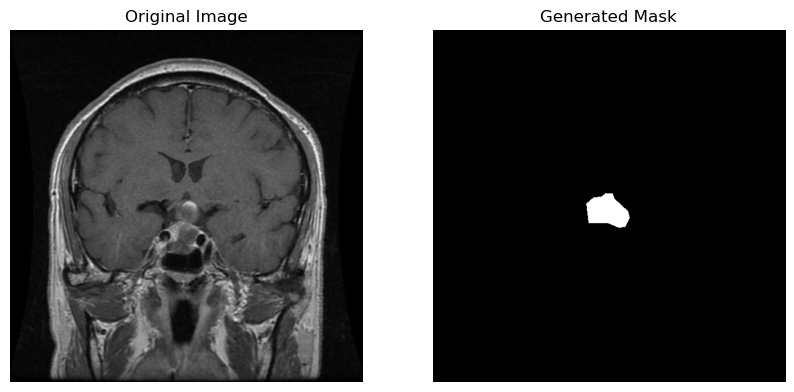

Loaded polygons for Tr-pi_1451_jpg.rf.bdbaeef9450ef6f04472750a4b0475e6.txt: [[(0.458984375, 0.5234375), (0.48046875, 0.541015625), (0.53125, 0.51953125), (0.5703125, 0.51953125), (0.58203125, 0.498046875), (0.572265625, 0.44140625), (0.5546875, 0.427734375), (0.51171875, 0.421875), (0.490234375, 0.42578125), (0.4609375, 0.4453125), (0.458984375, 0.5234375)]]
Drawing polygon: [(293, 335), (307, 346), (340, 332), (365, 332), (372, 318), (366, 282), (355, 273), (327, 270), (313, 272), (295, 285), (293, 335)]


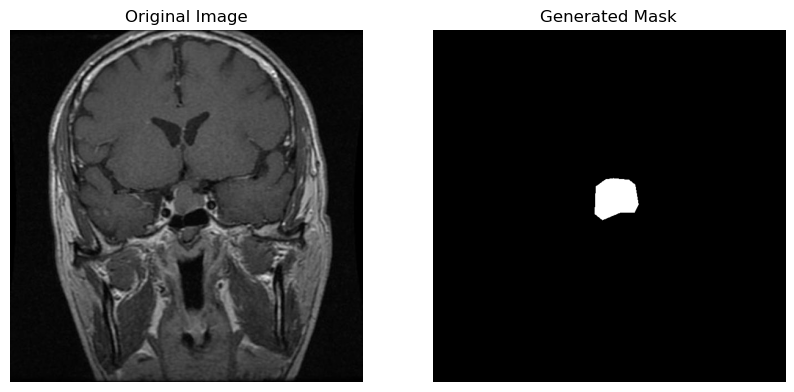

Loaded polygons for glioma23_jpg.rf.78dd5fa0343bf949a2595c8c81b71d34.txt: [[(0.611328125, 0.4833984375), (0.5947265625, 0.46875), (0.5615234375, 0.45703125), (0.5341796875, 0.46484375), (0.51953125, 0.4990234375), (0.521484375, 0.5419921875), (0.54296875, 0.5869140625), (0.5546875, 0.5927734375), (0.5908203125, 0.583984375), (0.62109375, 0.5380859375), (0.62109375, 0.5048828125), (0.611328125, 0.4833984375)]]
Drawing polygon: [(391, 309), (380, 300), (359, 292), (341, 297), (332, 319), (333, 346), (347, 375), (355, 379), (378, 373), (397, 344), (397, 323), (391, 309)]


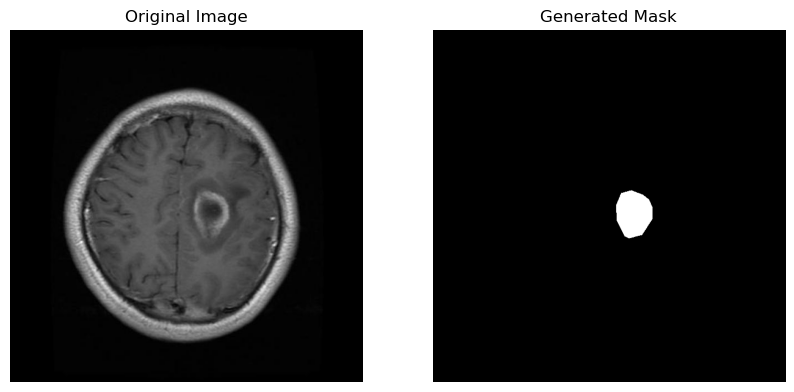

Loaded polygons for glioma31_jpg.rf.fac420ecfbee938333cdf42e3d907fef.txt: [[(0.5576171875, 0.388671875), (0.6005859375, 0.3984375), (0.60546875, 0.3701171875), (0.5908203125, 0.3515625), (0.5693359375, 0.341796875), (0.4892578125, 0.33984375), (0.4404296875, 0.36328125), (0.3994140625, 0.373046875), (0.365234375, 0.3974609375), (0.3681640625, 0.404296875), (0.435546875, 0.4072265625), (0.4580078125, 0.400390625), (0.4892578125, 0.375), (0.5166015625, 0.3671875), (0.5576171875, 0.388671875)]]
Drawing polygon: [(356, 248), (384, 255), (387, 236), (378, 225), (364, 218), (313, 217), (281, 232), (255, 238), (233, 254), (235, 258), (278, 260), (293, 256), (313, 240), (330, 235), (356, 248)]


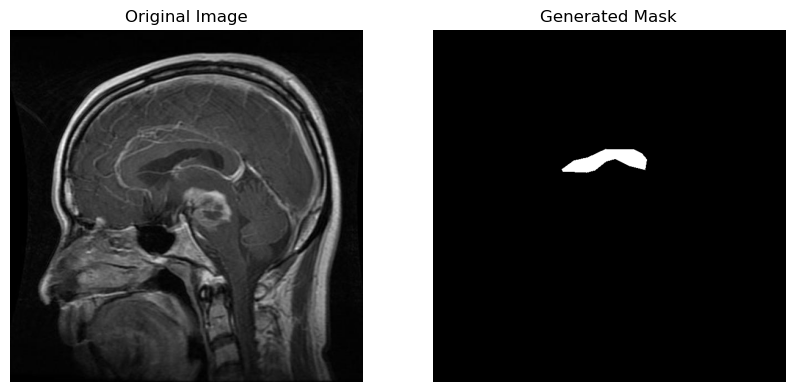

Loaded polygons for glioma32_jpg.rf.dba8c0edb6222e40f23539e0a9d6c589.txt: [[(0.5419921875, 0.529296875), (0.4736328125, 0.515625), (0.451171875, 0.5302734375), (0.43359375, 0.5888671875), (0.435546875, 0.6123046875), (0.4482421875, 0.62890625), (0.474609375, 0.6337890625), (0.5419921875, 0.59765625), (0.552734375, 0.5849609375), (0.5546875, 0.5517578125), (0.5419921875, 0.529296875)]]
Drawing polygon: [(346, 338), (303, 330), (288, 339), (277, 376), (278, 391), (286, 402), (303, 405), (346, 382), (353, 374), (355, 353), (346, 338)]


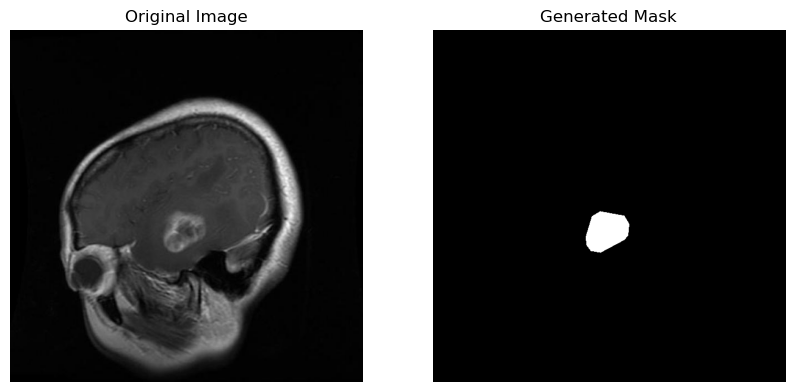

Loaded polygons for glioma43_jpg.rf.0986aceb46d2e4a06604e7de2bf3c711.txt: [[(0.5556640625, 0.330078125), (0.544921875, 0.3388671875), (0.544921875, 0.3583984375), (0.5712890625, 0.390625), (0.58203125, 0.3896484375), (0.6015625, 0.3818359375), (0.607421875, 0.3427734375), (0.5927734375, 0.333984375), (0.5556640625, 0.330078125)]]
Drawing polygon: [(355, 211), (348, 216), (348, 229), (365, 250), (372, 249), (385, 244), (388, 219), (379, 213), (355, 211)]


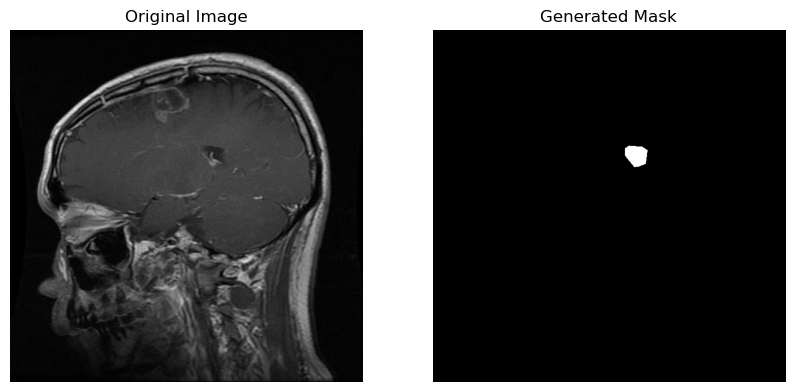

Loaded polygons for glioma7_jpg.rf.7a5656b6d095ce5846385f11f6b94046.txt: [[(0.6318359375, 0.630859375), (0.623046875, 0.6318359375), (0.62890625, 0.6435546875), (0.6201171875, 0.65234375), (0.6005859375, 0.65234375), (0.587890625, 0.6689453125), (0.59375, 0.7021484375), (0.5859375, 0.7333984375), (0.6083984375, 0.748046875), (0.626953125, 0.7490234375), (0.6904296875, 0.712890625), (0.697265625, 0.7001953125), (0.681640625, 0.6591796875), (0.6318359375, 0.630859375)]]
Drawing polygon: [(404, 403), (398, 404), (402, 411), (396, 417), (384, 417), (376, 428), (380, 449), (375, 469), (389, 478), (401, 479), (441, 456), (446, 448), (436, 421), (404, 403)]


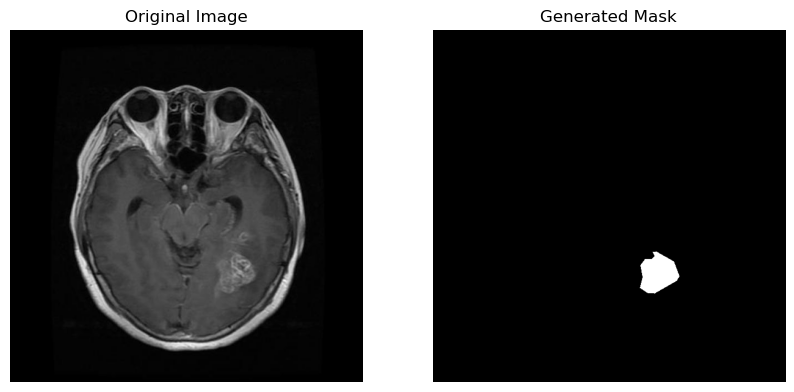

Loaded polygons for meningioma1_jpg.rf.78a67cc6008a8b1fcd33dc5593cb4961.txt: [[(0.684792784375, 0.3203124984375), (0.6389405734375, 0.3378906265625), (0.61402089375, 0.3740234375), (0.5940851515625, 0.4423828109375), (0.596078725, 0.4853515625), (0.6100337453125, 0.5107421890625), (0.65488916875, 0.544921875), (0.7356289296875, 0.5634765625), (0.7924457984375, 0.5410156265625), (0.7934425859375, 0.5263671890625), (0.7396160765625, 0.3271484375), (0.684792784375, 0.3203124984375)]]
Drawing polygon: [(438, 204), (408, 216), (392, 239), (380, 283), (381, 310), (390, 326), (419, 348), (470, 360), (507, 346), (507, 336), (473, 209), (438, 204)]


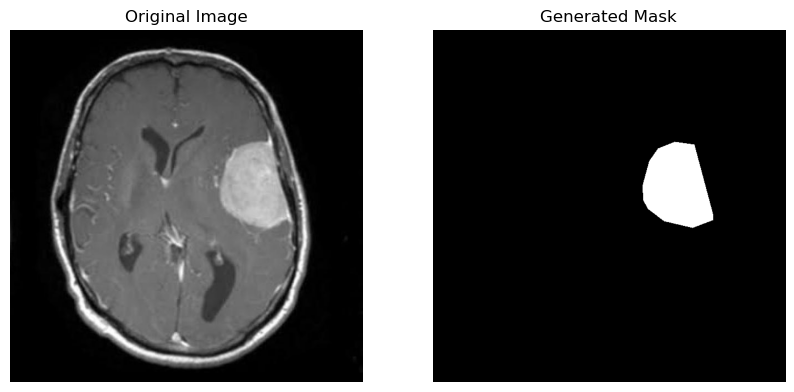

Loaded polygons for meningioma30_jpg.rf.a6d3c265ffd88a6714273ebedf11f28e.txt: [[(0.5221318875, 0.5725247171875), (0.5672990046875, 0.43677143437500004), (0.574525746875, 0.29216467343749997), (0.5004516734375, 0.3187251), (0.44986449687499996, 0.277408884375), (0.398165965625, 0.275390625), (0.3312071265625, 0.2382812515625), (0.29294493125, 0.2636718765625), (0.27142244843749996, 0.25), (0.2642482828125, 0.2636718765625), (0.24272580000000002, 0.2539062515625), (0.237943025, 0.2695312515625), (0.24028906874999997, 0.2700309875), (0.24028906874999997, 0.355614578125), (0.1291349078125, 0.4130859359375), (0.23196455624999998, 0.4638671875), (0.261856896875, 0.5585937484375), (0.3909918046875, 0.578125), (0.3974706390625, 0.6241699875), (0.40294874218750004, 0.578125), (0.4459937125, 0.587890625), (0.477081746875, 0.5449218765625), (0.5221318875, 0.5725247171875)]]
Drawing polygon: [(334, 366), (363, 279), (367, 186), (320, 203), (287, 177), (254, 176), (211, 152), (187, 168), (173, 160)

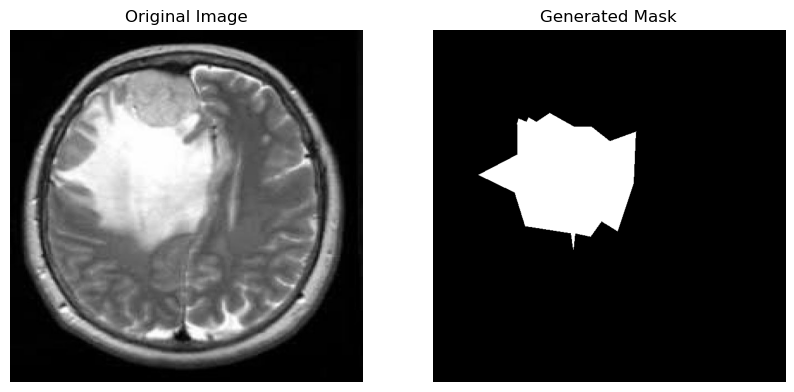

Loaded polygons for meningioma36_jpg.rf.acadc0b55106ed4d4e9f17c075e496d4.txt: [[(0.66015625, 0.17175632968750001), (0.673828125, 0.1409018984375), (0.6650390625, 0.12547468281250002), (0.6279296875, 0.1151898734375), (0.4638671875, 0.12136075937499999), (0.376953125, 0.15941455625), (0.4306640625, 0.232436709375), (0.4912109375, 0.27151898750000003), (0.5390625, 0.27254746875), (0.5810546875, 0.257120253125), (0.599609375, 0.231408228125), (0.607421875, 0.1964398734375), (0.66015625, 0.17175632968750001)]]
Drawing polygon: [(422, 109), (431, 90), (425, 80), (401, 73), (296, 77), (241, 102), (275, 148), (314, 173), (345, 174), (371, 164), (383, 148), (388, 125), (422, 109)]


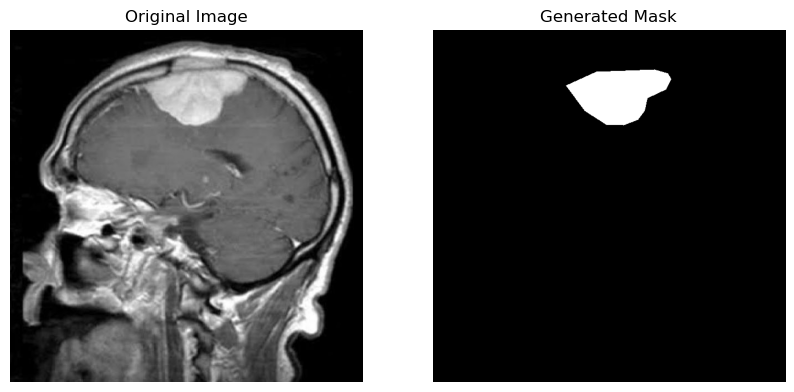

Loaded polygons for meningioma49_jpg.rf.2613e5acc1302d33552bb11db41f103d.txt: [[(0.666870115625, 0.10742187343750001), (0.58776855625, 0.10742187343750001), (0.509765625, 0.1728515625), (0.5009765609375, 0.2119140609375), (0.5504150390625, 0.2949218734375), (0.6635742203125, 0.3193359390625), (0.7778320296875, 0.2412109390625), (0.7646484390625, 0.1865234375), (0.719604490625, 0.1328124984375), (0.666870115625, 0.10742187343750001)]]
Drawing polygon: [(426, 68), (376, 68), (326, 110), (320, 135), (352, 188), (424, 204), (497, 154), (489, 119), (460, 84), (426, 68)]


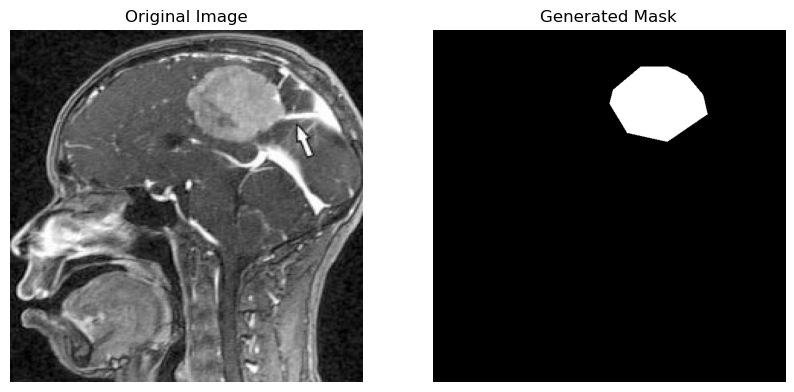

Loaded polygons for meningioma8_jpg.rf.2b857d06b934098cdea86fbb41242fd2.txt: [[(0.6229638234375, 0.5234375015625), (0.6348400843750001, 0.4990234375), (0.6369994046875, 0.4228515625), (0.60352994375, 0.39453125), (0.5387503437500001, 0.38671875), (0.534431703125, 0.37890625), (0.4815283640625, 0.4052734375), (0.45993516406249996, 0.4853515625), (0.47936904374999995, 0.6064453125), (0.5052808828125, 0.6416015625), (0.5581842234375001, 0.63671875), (0.5743791234375, 0.6240234375), (0.6002909640625, 0.5244140640625), (0.6229638234375, 0.5234375015625)]]
Drawing polygon: [(398, 335), (406, 319), (407, 270), (386, 252), (344, 247), (342, 242), (308, 259), (294, 310), (306, 388), (323, 410), (357, 407), (367, 399), (384, 335), (398, 335)]


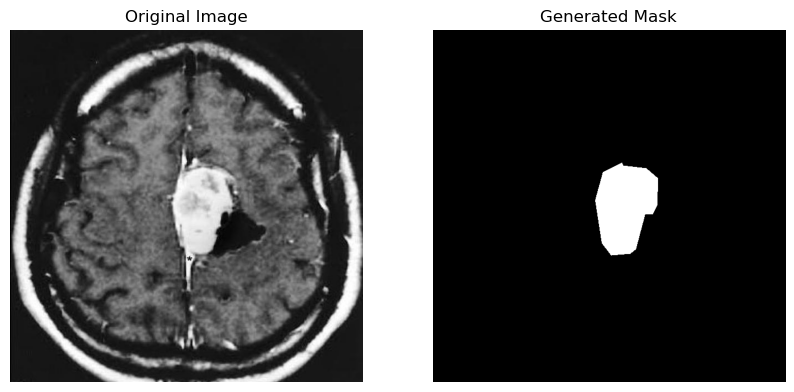

Loaded polygons for pituitary40_jpg.rf.edcd1f95576f4980c7b5f4dc7350355b.txt: [[(0.41031390156249997, 0.496932515625), (0.40881913281250004, 0.5084355828125), (0.4200298953125, 0.5276073625000001), (0.425261584375, 0.5521472390625), (0.41704035937499995, 0.5927914109375), (0.4200298953125, 0.61119631875), (0.4312406578125, 0.6273006140625), (0.4947683109375, 0.6618098156250001), (0.5074738421875, 0.6633435578125), (0.5605381171875, 0.6510736203125), (0.5687593421875, 0.6449386500000001), (0.5702541109375, 0.621932515625), (0.57698056875, 0.6065950921875001), (0.57698056875, 0.5835889578125), (0.5672645734375, 0.5598159515625001), (0.5747384156249999, 0.5145705515625), (0.5724962625, 0.4946319015625), (0.55156950625, 0.470092025), (0.5306427499999999, 0.45858895781250003), (0.5142002984375, 0.45475460156249997), (0.4820627796875, 0.4539877296875), (0.45964125625, 0.45858895781250003), (0.4439461890625, 0.465490796875), (0.41031390156249997, 0.496932515625)]]
Drawing polygon: [(262, 318),

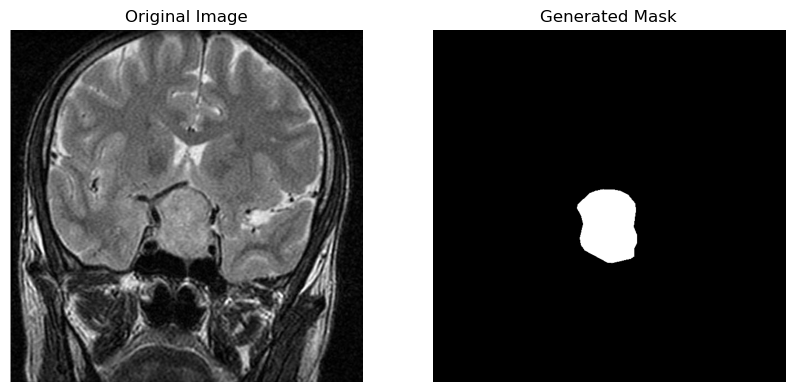

Image test volume shape: (15, 640, 640, 3)
Mask test volume shape: (15, 640, 640)
Test dataset prepared.


In [64]:
# Paths
labels_folder = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/test/labels"
images_folder = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/test/images"

# Initialize arrays for images and masks
volume_test_images = []
volume_test_masks = []

def create_mask_from_polygons(polygons, img_width, img_height):
    """Create a binary mask from normalized polygon coordinates."""
    # Create a blank black image
    mask = Image.new('L', (img_width, img_height), 0)  
    draw = ImageDraw.Draw(mask)
    
    for polygon in polygons:
        if not polygon:
            print("Empty polygon detected, skipping.")
            continue
        
        # Scale the normalized coordinates to image dimensions
        scaled_polygon = [(int(x * img_width), int(y * img_height)) for x, y in polygon]
        print(f"Drawing polygon: {scaled_polygon}")  # Debug scaled polygon coordinates
        draw.polygon(scaled_polygon, outline=1, fill=1)  # Draw precise polygons
    
    # Convert to a binary NumPy array
    return np.array(mask, dtype=np.uint8)

# Iterate through label files
for label_file in sorted(os.listdir(labels_folder)):
    if label_file.endswith('.txt'):  # Check for label files
        # Load polygons and labels
        label_path = os.path.join(labels_folder, label_file)
        polygons, _ = load_polygon_from_file(label_path)  # Ensure this function is correct
        
        # Debug polygons
        print(f"Loaded polygons for {label_file}: {polygons}")
        
        # Find the corresponding image file
        image_file = label_file.replace('.txt', '.jpg')  # Adjust extension as needed
        image_path = os.path.join(images_folder, image_file)
        
        if os.path.exists(image_path):
            # Load the image
            img = Image.open(image_path)
            img_width, img_height = img.size
            img_array = np.array(img)
            
            # Create a precise mask from the polygons
            mask_array = create_mask_from_polygons(polygons, img_width, img_height)
            
            # Add image and mask to volumes
            volume_test_images.append(img_array)
            volume_test_masks.append(mask_array)
            
            # Visualize the image and mask in the notebook
            plt.figure(figsize=(10, 5))
            
            plt.subplot(1, 2, 1)
            plt.imshow(img_array)
            plt.title("Original Image")
            plt.axis("off")
            
            plt.subplot(1, 2, 2)
            plt.imshow(mask_array, cmap="gray")
            plt.title("Generated Mask")
            plt.axis("off")
            
            plt.show()
        else:
            print(f"Image not found for label file: {label_file}")

# Convert to NumPy arrays
if volume_test_images and volume_test_masks:
    volume_test_images = np.stack(volume_test_images)  # Shape: (num_images, height, width, channels)
    volume_test_masks = np.stack(volume_test_masks)    # Shape: (num_images, height, width)

    # Normalize images and masks
    volume_test_images = volume_test_images / 255.0  # Scale images to [0, 1]
    volume_test_masks = volume_test_masks.astype('float32')  # Ensure masks are float32

    print(f"Image test volume shape: {volume_test_images.shape}")
    print(f"Mask test volume shape: {volume_test_masks.shape}")
else:
    print("No valid images or masks were created.")

print("Test dataset prepared.")

Shape of test_data: (15, 640, 640, 3)
Shape of test_masks: (15, 640, 640)
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
Shape of predictions: (15, 640, 640, 1)
Shape of predicted masks: (15, 640, 640)


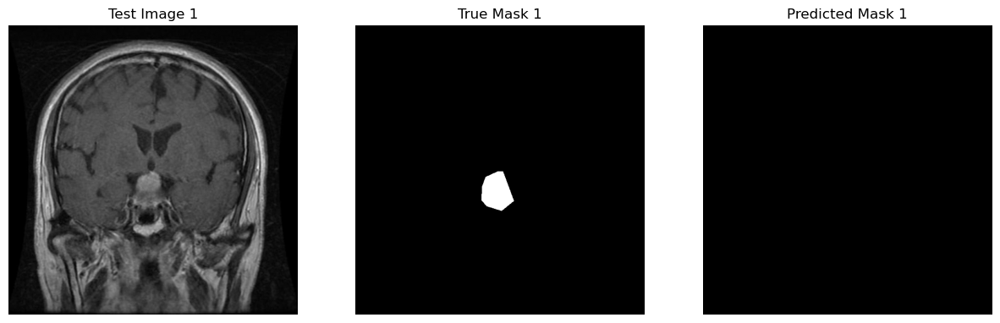

In [66]:
# Renaming the volumes
test_data = volume_test_images  # The images to predict on
test_masks = volume_test_masks  # The true masks for comparison

# Check the shape of both
print(f"Shape of test_data: {test_data.shape}")
print(f"Shape of test_masks: {test_masks.shape}")

# Predict the output for test data (segmentation)
predictions = model.predict(test_data)

# Check the shape of the predictions
print(f"Shape of predictions: {predictions.shape}")

# Predictions will have shape (num_samples, height, width, num_classes)
# Convert predictions to the class with the highest probability for each pixel
predicted_masks = np.argmax(predictions, axis=-1)  # Choose the class with the highest probability per pixel

# Check the shape of predicted masks
print(f"Shape of predicted masks: {predicted_masks.shape}")

# Now, predicted_masks will be the predicted class labels for each pixel in each image
# The shape will be (num_samples, height, width), with each pixel in the mask showing the class id

# Example of how to compare a few predicted masks to the ground truth
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Display the first image and its true mask and predicted mask
axes[0].imshow(test_data[0])
axes[0].set_title('Test Image 1')
axes[1].imshow(test_masks[0], cmap='gray')
axes[1].set_title('True Mask 1')
axes[2].imshow(predicted_masks[0], cmap='gray')
axes[2].set_title('Predicted Mask 1')

for ax in axes:
    ax.axis('off')

plt.show()

In [67]:
#Alright, the predicted mask is still entirely incorrect, so I'll look at the range of values in the mask. 

predicted_masks = model.predict(test_data)  # Shape: (batch_size, height, width, 1)
print("Predicted mask stats:")
print(f"Min: {predicted_masks.min()}, Max: {predicted_masks.max()}, Mean: {predicted_masks.mean()}")


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
Predicted mask stats:
Min: 9.629219199780437e-09, Max: 0.3734051585197449, Mean: 0.04768632352352142


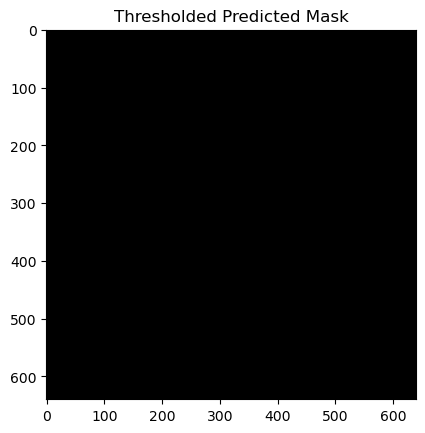

In [68]:
#Here I try to adjust the threshold from the typical 0.5 to lower than the mean to see whether I can pick up any gray
#areas in the gray matter rather than an all black or all white output mask.
threshold = 0.485  
binary_predicted_masks = (predicted_masks > threshold).astype(np.uint8)

# Visualize the thresholded mask
import matplotlib.pyplot as plt
plt.imshow(binary_predicted_masks[0, :, :, 0], cmap="gray")
plt.title("Thresholded Predicted Mask")
plt.show()


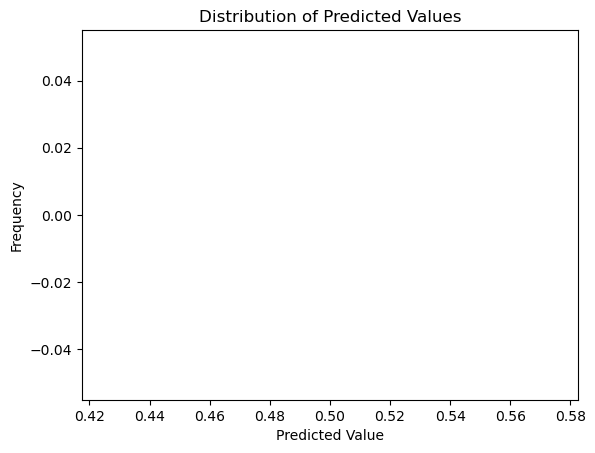

In [72]:
#I might not have a good enough range of values for confident predictions from machine learning. I'll take a look at the 
#histogram.

plt.hist(predicted_masks.flatten(), bins=50, range=(0.425, 0.575))
plt.title("Distribution of Predicted Values")
plt.xlabel("Predicted Value")
plt.ylabel("Frequency")
plt.show()


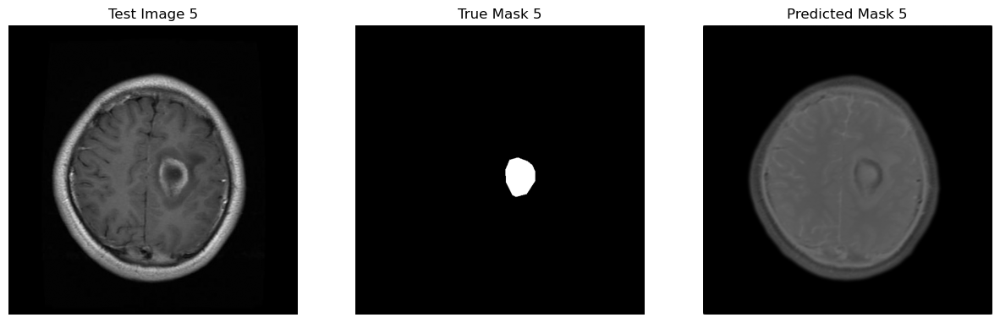

In [74]:
# Example of how to compare a few predicted masks to the ground truth
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Display the first image and its true mask and predicted mask
axes[0].imshow(test_data[4])
axes[0].set_title('Test Image 5')
axes[1].imshow(test_masks[4], cmap='gray')
axes[1].set_title('True Mask 5')
axes[2].imshow(predicted_masks[4], cmap='gray')
axes[2].set_title('Predicted Mask 5')

for ax in axes:
    ax.axis('off')

plt.show()

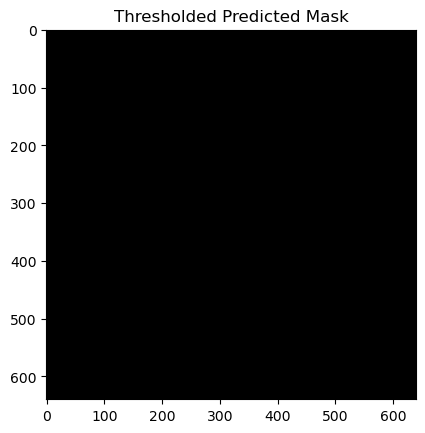

In [76]:
#Here I try to adjust the threshold from the typical 0.5 to lower than the mean to see whether I can pick up any gray
#areas in the gray matter rather than an all black or all white output mask.
threshold = 0.491  
binary_predicted_masks = (predicted_masks > threshold).astype(np.uint8)

# Visualize the thresholded mask
import matplotlib.pyplot as plt
plt.imshow(binary_predicted_masks[0, :, :, 0], cmap="gray")
plt.title("Thresholded Predicted Mask")
plt.show()


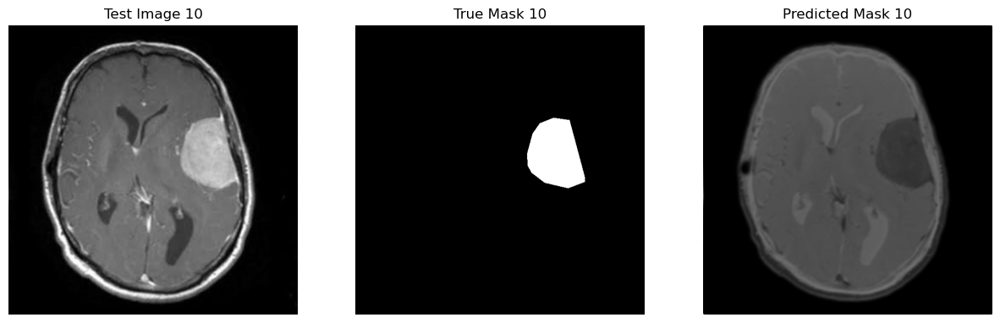

In [78]:
# Example of how to compare a few predicted masks to the ground truth
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Display the first image and its true mask and predicted mask
axes[0].imshow(test_data[9])
axes[0].set_title('Test Image 10')
axes[1].imshow(test_masks[9], cmap='gray')
axes[1].set_title('True Mask 10')
axes[2].imshow(predicted_masks[9], cmap='gray')
axes[2].set_title('Predicted Mask 10')

for ax in axes:
    ax.axis('off')

plt.show()

In [80]:
#Let me try to find the best threshold.
def evaluate_threshold(threshold, true_masks, pred_probs):
    # Apply threshold and binarize predictions
    pred_bin = (pred_probs > threshold).astype(np.uint8)
    
    # Compute pixel-wise accuracy
    correct_pixels = np.sum(pred_bin == true_masks)
    total_pixels = np.prod(true_masks.shape)
    pixel_acc = correct_pixels / total_pixels
    
    # Compute IoU for binary segmentation
    intersection = np.sum((pred_bin == 1) & (true_masks == 1))
    union = np.sum((pred_bin == 1) | (true_masks == 1))
    iou = intersection / union if union != 0 else 0
    return pixel_acc, iou

# Assume test_masks_resized are your true masks (with values 0 and 1) 
# and predictions are your raw model outputs (before thresholding)
thresholds = np.linspace(0.45, 0.55, 11)  # Example thresholds between 0.45 and 0.55
results = {}

for th in thresholds:
    acc, iou = evaluate_threshold(th, test_masks, predictions[..., 0])
    results[th] = (acc, iou)
    print(f"Threshold: {th:.3f} -> Pixel Accuracy: {acc:.3f}, IoU: {iou:.3f}")

# Pick the threshold that yields the best IoU or accuracy, e.g.,:
optimal_threshold = max(results.items(), key=lambda x: x[1][1])[0]
print("Optimal threshold:", optimal_threshold)


Threshold: 0.450 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.460 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.470 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.480 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.490 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.500 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.510 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.520 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.530 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.540 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.550 -> Pixel Accuracy: 0.976, IoU: 0.000
Optimal threshold: 0.45


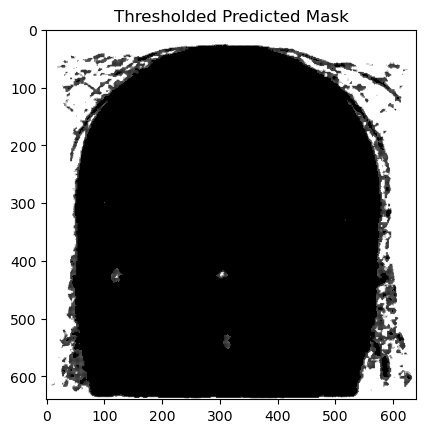

In [58]:
#I'll try the optimal threshold and see how things change.
threshold = 0.45  
binary_predicted_masks = (predicted_masks > threshold).astype(np.uint8)

# Visualize the thresholded mask
import matplotlib.pyplot as plt
plt.imshow(binary_predicted_masks[0, :, :, 0], cmap="gray")
plt.title("Thresholded Predicted Mask")
plt.show()


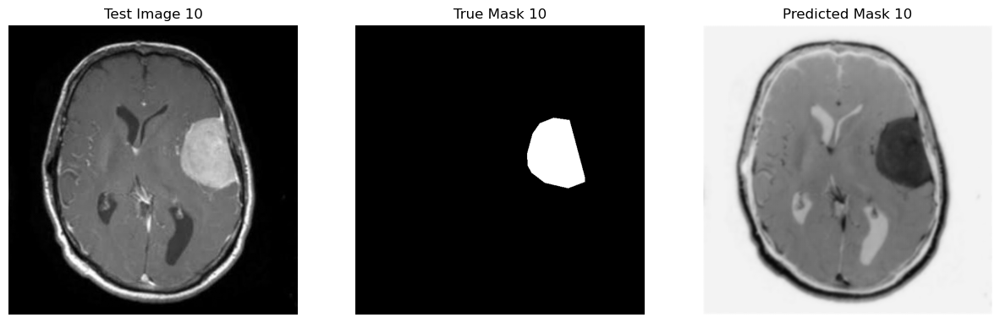

In [60]:
# Example of how to compare a few predicted masks to the ground truth
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Display the first image and its true mask and predicted mask
axes[0].imshow(test_data[9])
axes[0].set_title('Test Image 10')
axes[1].imshow(test_masks[9], cmap='gray')
axes[1].set_title('True Mask 10')
axes[2].imshow(predicted_masks[9], cmap='gray')
axes[2].set_title('Predicted Mask 10')

for ax in axes:
    ax.axis('off')

plt.show()

In [62]:
# Squeeze the predicted masks to remove the last dimension
predicted_masks_squeezed = np.squeeze(predicted_masks, axis=-1)  # Now shape will be (15, 640, 640)

# Compute pixel-wise accuracy
correct_pixels = np.sum(predicted_masks_squeezed == test_masks)  # Compare pixel-wise
total_pixels = np.prod(test_masks.shape)  # Total number of pixels

pixel_accuracy = correct_pixels / total_pixels * 100
print(f"Pixel-wise accuracy: {pixel_accuracy:.2f}%")


Pixel-wise accuracy: 0.00%


In [64]:
#Jacqard Index

def calculate_iou(pred_mask, true_mask, num_classes=4):
    ious = []
    
    # Calculate IoU for each class (assuming class labels range from 0 to num_classes-1)
    for i in range(num_classes):
        intersection = np.sum((pred_mask == i) & (true_mask == i))  # Pixels that match
        union = np.sum((pred_mask == i) | (true_mask == i))  # All pixels in either mask
        iou = intersection / union if union != 0 else 0  # Avoid division by zero
        ious.append(iou)
    
    return ious

# Example: Calculate IoU for all test samples
ious = [calculate_iou(pred_mask, true_mask) for pred_mask, true_mask in zip(predicted_masks, test_masks)]

# Calculate average IoU
mean_iou = np.mean(ious)
print(f"Mean IoU: {mean_iou:.2f}")


Mean IoU: 0.00


In [66]:
#F1 score

def calculate_dice(pred_mask, true_mask, num_classes=4):
    dices = []
    
    # Calculate Dice for each class
    for i in range(num_classes):
        intersection = np.sum((pred_mask == i) & (true_mask == i))
        dice = 2 * intersection / (np.sum(pred_mask == i) + np.sum(true_mask == i)) if (np.sum(pred_mask == i) + np.sum(true_mask == i)) != 0 else 0
        dices.append(dice)
    
    return dices

# Example: Calculate Dice coefficient for all test samples
dices = [calculate_dice(pred_mask, true_mask) for pred_mask, true_mask in zip(predicted_masks, test_masks)]

# Calculate average Dice score
mean_dice = np.mean(dices)
print(f"Mean Dice coefficient: {mean_dice:.2f}")


Mean Dice coefficient: 0.00


In [68]:
#I have a model that isn't performing well. I'll try to improve the model performance by transforming some of the images
#to augment the dataset. 

In [16]:
#Imports
import cv2
import numpy as np
import os
from PIL import Image, ImageEnhance

from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array
import random
from skimage.transform import resize, rotate 
from skimage.exposure import equalize_adapthist

#!pip install -U albumentations 
import albumentations as A
from albumentations.augmentations.geometric.transforms import Affine
from albumentations.core.composition import Compose
from albumentations.core.transforms_interface import ImageOnlyTransform
from albumentations.augmentations.geometric.resize import Resize
from tqdm import tqdm

/opt/anaconda3/lib/python3.12/site-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.3' (you have '2.0.2'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


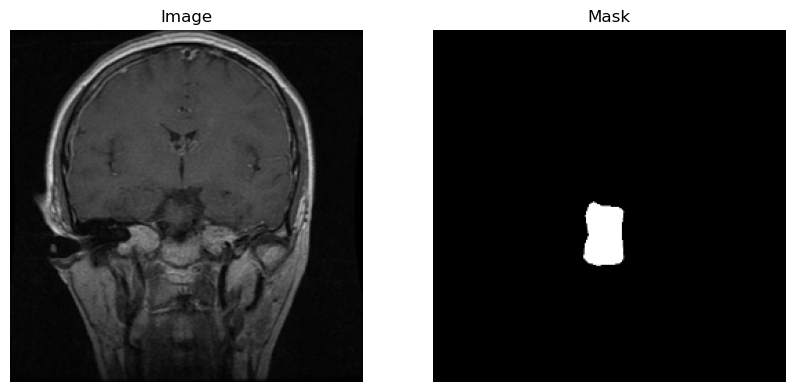

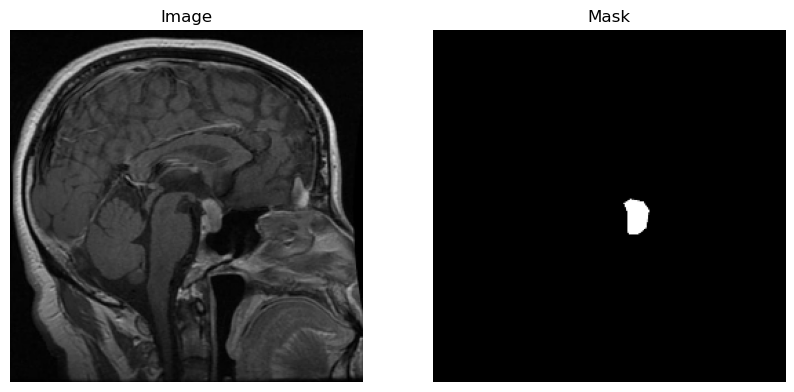

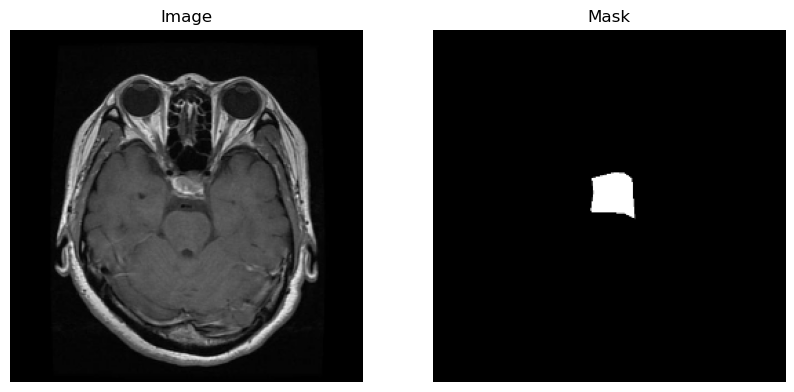

Image volume shape: (612, 256, 256, 3)
Mask volume shape: (612, 256, 256)
Training dataset prepared.


In [82]:
import os
import numpy as np
import cv2
import albumentations as A
import matplotlib.pyplot as plt
from PIL import Image

# Paths
labels_folder = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/train/labels"
images_folder = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/train/images"

# Initialize lists
volume_images = []
volume_masks = []

# Define the augmentation pipeline
transform = A.Compose([
    A.Resize(256, 256),            
    A.RandomRotate90(),
    A.HorizontalFlip(),
    A.Affine(rotate=(-30, 30)),
])

# Function to create a binary mask from polygons
def create_mask_from_polygons(polygons, img_width, img_height):
    mask = np.zeros((img_height, img_width), dtype=np.uint8)
    for poly in polygons:
        points = np.array([(int(x * img_width), int(y * img_height)) for x, y in poly], np.int32)
        cv2.fillPoly(mask, [points], 255)
    return mask

# Function to apply augmentation multiple times
def process_with_augmentation(polygons, image_path, augmentations=5):
    img = np.array(Image.open(image_path).convert("RGB"))  # Ensure 3-channel RGB
    img_height, img_width = img.shape[:2]
    
    # Create binary mask
    mask = create_mask_from_polygons(polygons, img_width, img_height)
    
    # Store original image and mask
    images, masks = [cv2.resize(img, (256, 256))], [cv2.resize(mask, (256, 256))]
    
    # Augment the image multiple times
    for _ in range(augmentations):
        augmented = transform(image=img, mask=mask)
        images.append(augmented["image"])
        masks.append(augmented["mask"])
    
    return images, masks

# Iterate through label files
count = 0
for label_file in sorted(os.listdir(labels_folder)):
    if label_file.endswith(".txt"):
        label_path = os.path.join(labels_folder, label_file)
        image_file = label_file.replace(".txt", ".jpg")
        image_path = os.path.join(images_folder, image_file)

        if os.path.exists(image_path):
            polygons, _ = load_polygon_from_file(label_path)
            images, masks = process_with_augmentation(polygons, image_path, augmentations=5)
            
            # Convert to NumPy arrays and normalize
            images = np.array(images, dtype=np.float32) / 255.0
            masks = np.array(masks, dtype=np.float32)

            volume_images.extend(images)
            volume_masks.extend(masks)
            
            # Show only up to 3 image-mask pairs
            if count < 3:
                plt.figure(figsize=(10, 5))
                plt.subplot(1, 2, 1)
                plt.imshow(images[0])  # Show original image
                plt.title("Image")
                plt.axis("off")
                
                plt.subplot(1, 2, 2)
                plt.imshow(masks[0], cmap="gray")  # Show mask
                plt.title("Mask")
                plt.axis("off")
                
                plt.show()
                count += 1
        else:
            print(f"Image not found for label file: {label_file}")

# Convert lists to NumPy arrays for TensorFlow
if volume_images and volume_masks:
    volume_images = np.array(volume_images, dtype=np.float32)  # (num_images, 256, 256, 3)
    volume_masks = np.array(volume_masks, dtype=np.float32)  # (num_images, 256, 256)

    print(f"Image volume shape: {volume_images.shape}")
    print(f"Mask volume shape: {volume_masks.shape}")
else:
    print("No valid images or masks were created.")

print("Training dataset prepared.")


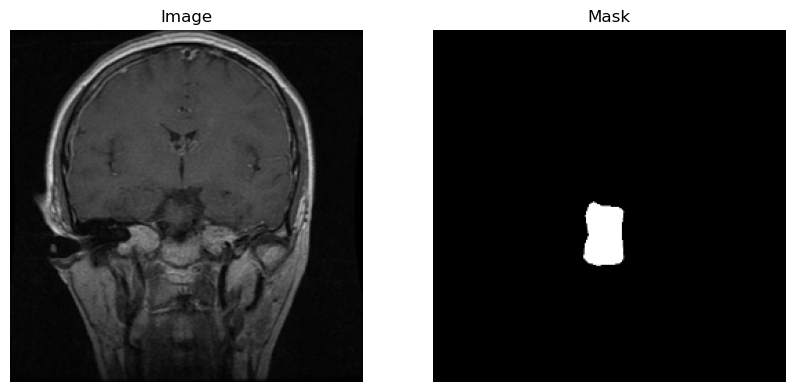

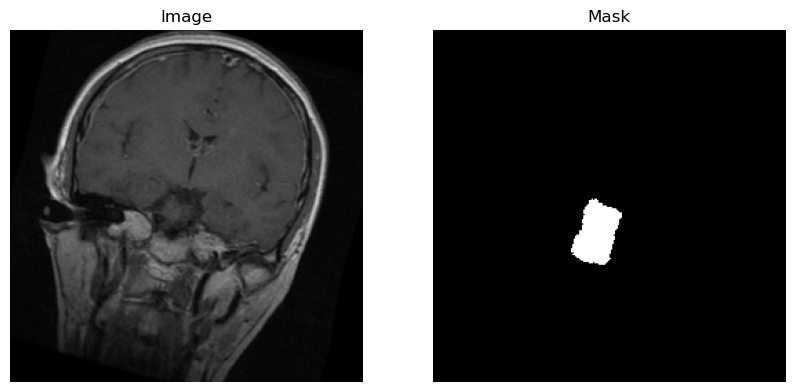

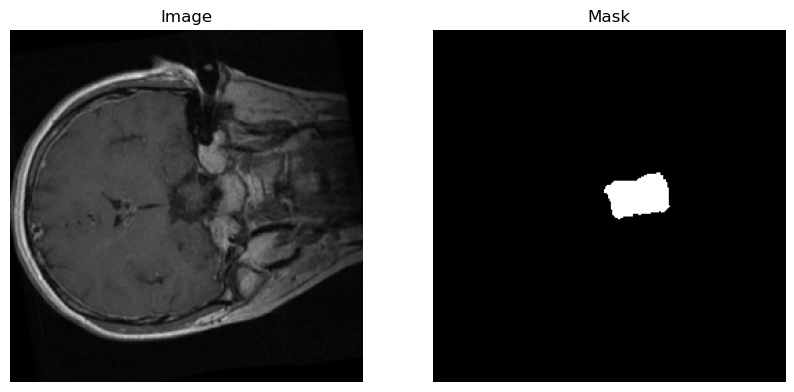

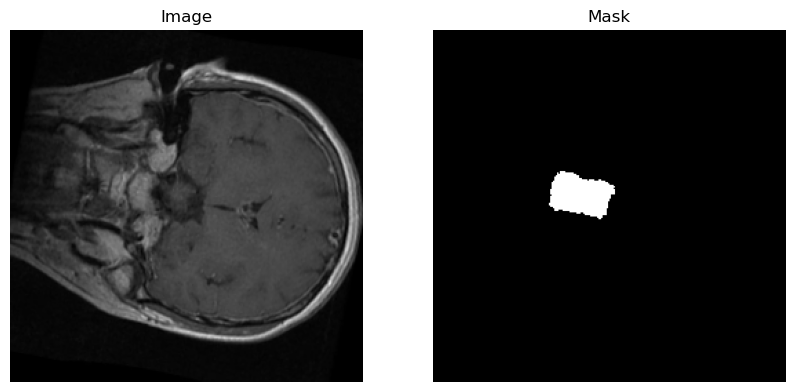

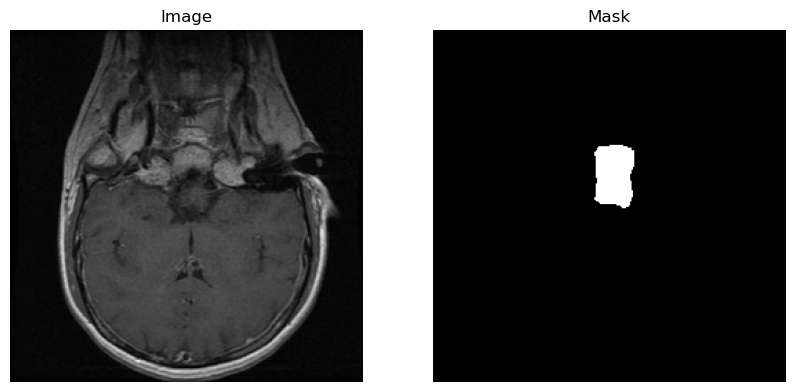

In [83]:
import matplotlib.pyplot as plt

# Visualize an image and its corresponding mask
def visualize_image_and_mask(image, mask):
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.title("Image")
    plt.axis("off")
    plt.subplot(1, 2, 2)
    plt.imshow(mask, cmap="gray")
    plt.title("Mask")
    plt.axis("off")
    plt.show()

# Example usage
for img, msk in zip(volume_images[:5], volume_masks[:5]):
    visualize_image_and_mask(img, msk)


In [84]:
#modelling

from tensorflow.keras.layers import Conv2D, MaxPooling2D, Conv2DTranspose, concatenate, Input
from tensorflow.keras.models import Model

from tensorflow.keras.losses import BinaryCrossentropy

bce = BinaryCrossentropy(label_smoothing=0.1)  # Apply slight smoothing

def unet_model(input_shape=(256, 256, 3), num_classes=2):
    inputs = Input(input_shape)
    
    # Encoder
    c1 = Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    c1 = Conv2D(32, (3, 3), activation='relu', padding='same')(c1)
    p1 = MaxPooling2D((2, 2))(c1)
    
    c2 = Conv2D(64, (3, 3), activation='relu', padding='same')(p1)
    c2 = Conv2D(64, (3, 3), activation='relu', padding='same')(c2)
    p2 = MaxPooling2D((2, 2))(c2)
    
    # Bottleneck
    c3 = Conv2D(128, (3, 3), activation='relu', padding='same')(p2)
    c3 = Conv2D(128, (3, 3), activation='relu', padding='same')(c3)
    
    # Decoder
    u1 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c3)
    u1 = concatenate([u1, c2])
    c4 = Conv2D(64, (3, 3), activation='relu', padding='same')(u1)
    c4 = Conv2D(64, (3, 3), activation='relu', padding='same')(c4)
    
    u2 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c4)
    u2 = concatenate([u2, c1])
    c5 = Conv2D(32, (3, 3), activation='relu', padding='same')(u2)
    c5 = Conv2D(32, (3, 3), activation='relu', padding='same')(c5)
    
    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c5)
    
    model = Model(inputs, outputs)
    return model

# Create the model
model = unet_model(input_shape=(256, 256, 3), num_classes=2)
model.compile(optimizer='adam', loss='bce', metrics=['accuracy'])

model.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_22 (Conv2D)  │ (None, 256, 256,  │        896 │ input_layer_2[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_23 (Conv2D)  │ (None, 256, 256,  │      9,248 │ conv2d_22[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_4     │ (None, 128, 128,  │          0 │ conv2d_23[0][0]   │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_24 (Conv2D)  │ (None, 128, 128,  │     18,496 │ max_pooling2d_4[… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_25 (Conv2D)  │ (None, 128, 128,  │     36,928 │ conv2d_24[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_5     │ (None, 64, 64,    │          0 │ conv2d_25[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_26 (Conv2D)  │ (None, 64, 64,    │     73,856 │ max_pooling2d_5[… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_27 (Conv2D)  │ (None, 64, 64,    │    147,584 │ conv2d_26[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_4  │ (None, 128, 128,  │     32,832 │ conv2d_27[0][0]   │
│ (Conv2DTranspose)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_4       │ (None, 128, 128,  │          0 │ conv2d_transpose… │
│ (Concatenate)       │ 128)              │            │ conv2d_25[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_28 (Conv2D)  │ (None, 128, 128,  │     73,792 │ concatenate_4[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_29 (Conv2D)  │ (None, 128, 128,  │     36,928 │ conv2d_28[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_5  │ (None, 256, 256,  │      8,224 │ conv2d_29[0][0]   │
│ (Conv2DTranspose)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_5       │ (None, 256, 256,  │          0 │ conv2d_transpose… │
│ (Concatenate)       │ 64)               │            │ conv2d_23[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_30 (Conv2D)  │ (None, 256, 256,  │     18,464 │ concatenate_5[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_31 (Conv2D)  │ (None, 256, 256,  │      9,248 │ conv2d_30[0][0] 

 Total params: 466,529 (1.78 MB)

 Trainable params: 466,529 (1.78 MB)

 Non-trainable params: 0 (0.00 B)

In [88]:
# Ensure the mask values are in the correct range
volume_masks[volume_masks == 255] = 0  # Fix any out-of-bounds label values

# Compile and train the model again
model.compile(optimizer='adam', 
              loss='bce', 
              metrics=['accuracy'])

training = model.fit(volume_images, volume_masks, epochs=1, validation_split=0.2)

16/16 ━━━━━━━━━━━━━━━━━━━━ 114s 7s/step - accuracy: 0.8082 - loss: 0.5601 - val_accuracy: 0.9998 - val_loss: 0.1496


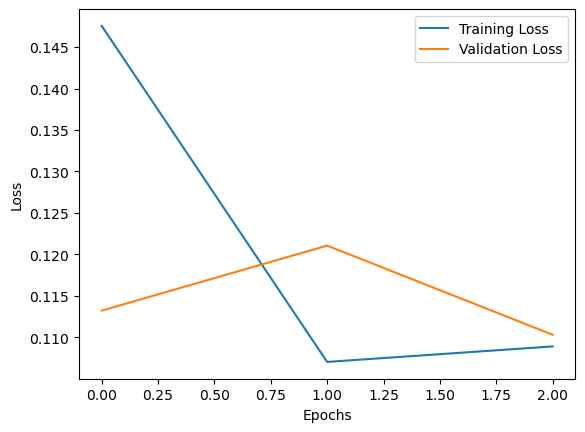

In [41]:
#Generating a checkpoint and saving the node weights
checkpoint = ModelCheckpoint('weights.keras', monitor='val_loss', save_best_only=True)
callbacks = [checkpoint]
print(callbacks)

# Plot the loss and validation loss
plt.plot(training.history['loss'], label='Training Loss')
plt.plot(training.history['val_loss'], label='Validation Loss')

# Add axis labels
plt.xlabel('Epochs')
plt.ylabel('Loss')

# Add a legend to distinguish the lines
plt.legend()

# Display the plot
plt.show()


In [42]:
import csv

# Define the CSV file name
csv_filename = "callbacks.csv"

# Extract callback details
callback_details = [
    {"name": type(cb).__name__, "filepath": getattr(cb, "filepath", None)}
    for cb in callbacks
]

# Write to a CSV file
with open(csv_filename, mode="w", newline="") as file:
    writer = csv.DictWriter(file, fieldnames=["name", "filepath"])
    writer.writeheader()
    writer.writerows(callback_details)

print(f"Callbacks saved to {csv_filename}")


Callbacks saved to callbacks.csv


Loaded polygons for Tr-piTr_0004_jpg.rf.44dee87c8693e404a864ae4f4ee60595.txt: [[(0.436448315625, 0.60546875), (0.455979565625, 0.625), (0.5048076921875, 0.640625), (0.5477764421875, 0.607421875), (0.5106670671875, 0.505859375), (0.491135815625, 0.505859375), (0.450120190625, 0.5234375), (0.438401440625, 0.55859375), (0.436448315625, 0.60546875)]]
Drawing polygon: [(279, 387), (291, 400), (323, 410), (350, 388), (326, 323), (314, 323), (288, 335), (280, 357), (279, 387)]


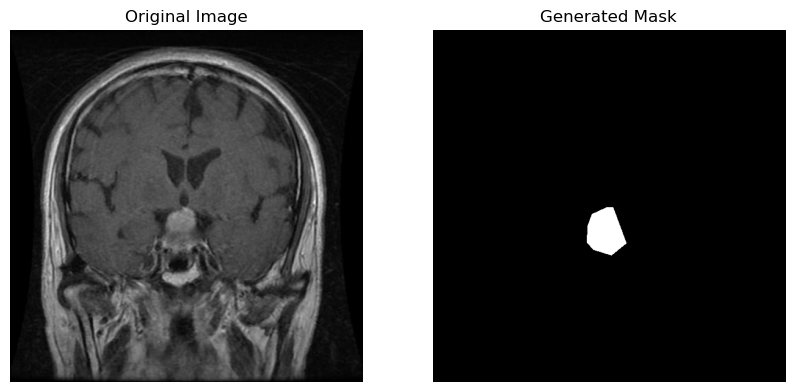

Loaded polygons for Tr-pi_1444_jpg.rf.29369c8b378bfbdba901805c7f670dd1.txt: [[(0.52734375, 0.537109375), (0.5390625, 0.603515625), (0.58984375, 0.619140625), (0.625, 0.595703125), (0.63671875, 0.5625), (0.63671875, 0.537109375), (0.625, 0.49609375), (0.61328125, 0.482421875), (0.572265625, 0.474609375), (0.537109375, 0.490234375), (0.52734375, 0.51171875), (0.52734375, 0.537109375)]]
Drawing polygon: [(337, 343), (345, 386), (377, 396), (400, 381), (407, 360), (407, 343), (400, 317), (392, 308), (366, 303), (343, 313), (337, 327), (337, 343)]


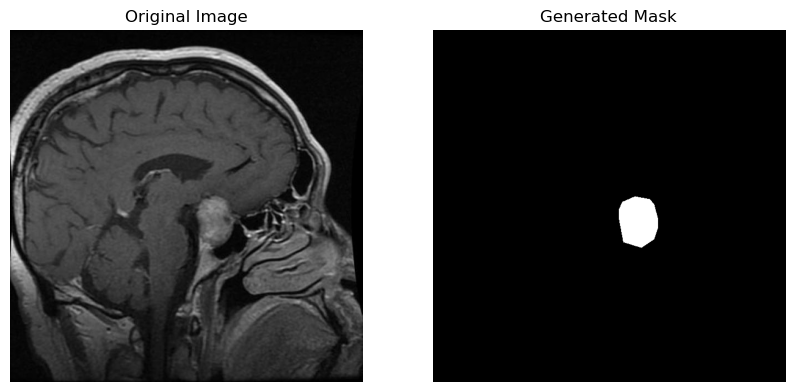

Loaded polygons for Tr-pi_1450_jpg.rf.9f38c63beab032ac62d81304e081b55e.txt: [[(0.435546875, 0.494140625), (0.44140625, 0.548828125), (0.494140625, 0.548828125), (0.52734375, 0.5625), (0.544921875, 0.560546875), (0.556640625, 0.53515625), (0.552734375, 0.515625), (0.513671875, 0.48046875), (0.5078125, 0.466796875), (0.490234375, 0.46484375), (0.478515625, 0.474609375), (0.455078125, 0.4765625), (0.435546875, 0.494140625)]]
Drawing polygon: [(278, 316), (282, 351), (316, 351), (337, 360), (348, 358), (356, 342), (353, 330), (328, 307), (325, 298), (313, 297), (306, 303), (291, 305), (278, 316)]


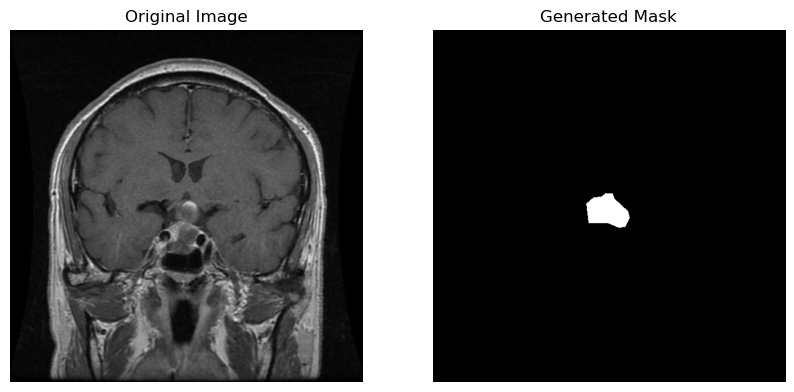

Loaded polygons for Tr-pi_1451_jpg.rf.bdbaeef9450ef6f04472750a4b0475e6.txt: [[(0.458984375, 0.5234375), (0.48046875, 0.541015625), (0.53125, 0.51953125), (0.5703125, 0.51953125), (0.58203125, 0.498046875), (0.572265625, 0.44140625), (0.5546875, 0.427734375), (0.51171875, 0.421875), (0.490234375, 0.42578125), (0.4609375, 0.4453125), (0.458984375, 0.5234375)]]
Drawing polygon: [(293, 335), (307, 346), (340, 332), (365, 332), (372, 318), (366, 282), (355, 273), (327, 270), (313, 272), (295, 285), (293, 335)]


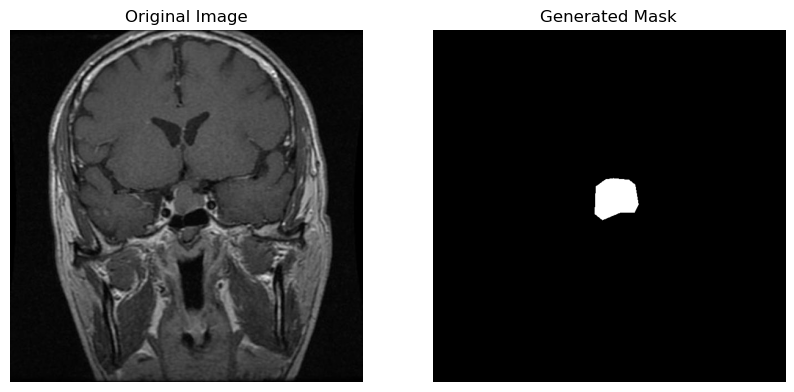

Loaded polygons for glioma23_jpg.rf.78dd5fa0343bf949a2595c8c81b71d34.txt: [[(0.611328125, 0.4833984375), (0.5947265625, 0.46875), (0.5615234375, 0.45703125), (0.5341796875, 0.46484375), (0.51953125, 0.4990234375), (0.521484375, 0.5419921875), (0.54296875, 0.5869140625), (0.5546875, 0.5927734375), (0.5908203125, 0.583984375), (0.62109375, 0.5380859375), (0.62109375, 0.5048828125), (0.611328125, 0.4833984375)]]
Drawing polygon: [(391, 309), (380, 300), (359, 292), (341, 297), (332, 319), (333, 346), (347, 375), (355, 379), (378, 373), (397, 344), (397, 323), (391, 309)]


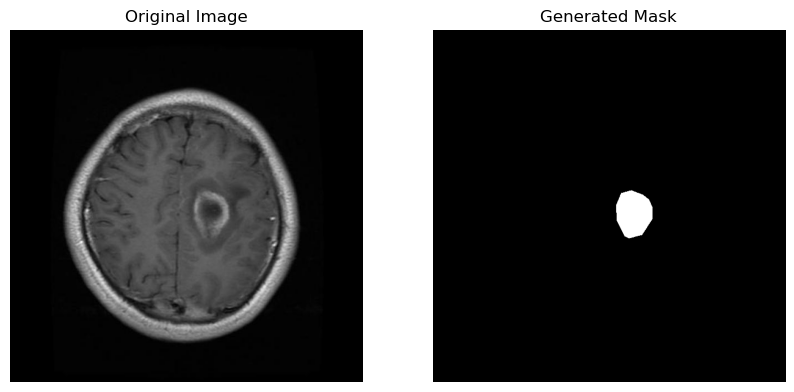

Loaded polygons for glioma31_jpg.rf.fac420ecfbee938333cdf42e3d907fef.txt: [[(0.5576171875, 0.388671875), (0.6005859375, 0.3984375), (0.60546875, 0.3701171875), (0.5908203125, 0.3515625), (0.5693359375, 0.341796875), (0.4892578125, 0.33984375), (0.4404296875, 0.36328125), (0.3994140625, 0.373046875), (0.365234375, 0.3974609375), (0.3681640625, 0.404296875), (0.435546875, 0.4072265625), (0.4580078125, 0.400390625), (0.4892578125, 0.375), (0.5166015625, 0.3671875), (0.5576171875, 0.388671875)]]
Drawing polygon: [(356, 248), (384, 255), (387, 236), (378, 225), (364, 218), (313, 217), (281, 232), (255, 238), (233, 254), (235, 258), (278, 260), (293, 256), (313, 240), (330, 235), (356, 248)]


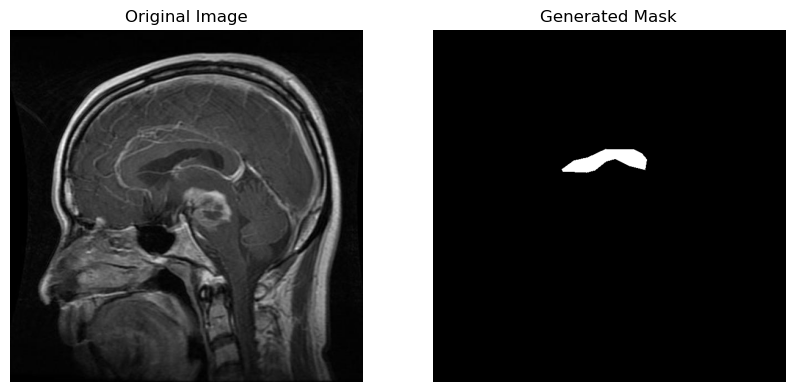

Loaded polygons for glioma32_jpg.rf.dba8c0edb6222e40f23539e0a9d6c589.txt: [[(0.5419921875, 0.529296875), (0.4736328125, 0.515625), (0.451171875, 0.5302734375), (0.43359375, 0.5888671875), (0.435546875, 0.6123046875), (0.4482421875, 0.62890625), (0.474609375, 0.6337890625), (0.5419921875, 0.59765625), (0.552734375, 0.5849609375), (0.5546875, 0.5517578125), (0.5419921875, 0.529296875)]]
Drawing polygon: [(346, 338), (303, 330), (288, 339), (277, 376), (278, 391), (286, 402), (303, 405), (346, 382), (353, 374), (355, 353), (346, 338)]


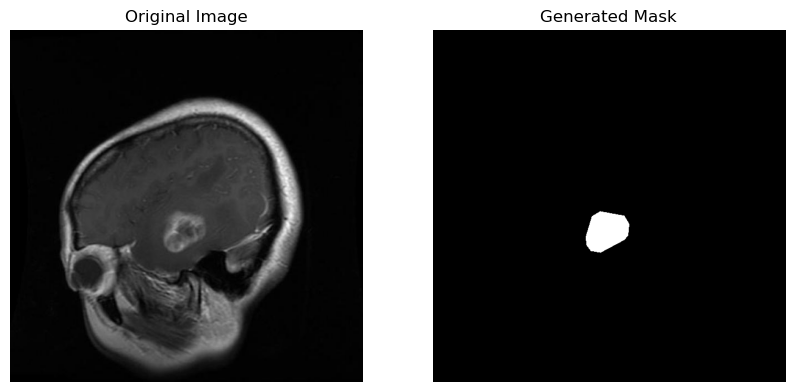

Loaded polygons for glioma43_jpg.rf.0986aceb46d2e4a06604e7de2bf3c711.txt: [[(0.5556640625, 0.330078125), (0.544921875, 0.3388671875), (0.544921875, 0.3583984375), (0.5712890625, 0.390625), (0.58203125, 0.3896484375), (0.6015625, 0.3818359375), (0.607421875, 0.3427734375), (0.5927734375, 0.333984375), (0.5556640625, 0.330078125)]]
Drawing polygon: [(355, 211), (348, 216), (348, 229), (365, 250), (372, 249), (385, 244), (388, 219), (379, 213), (355, 211)]


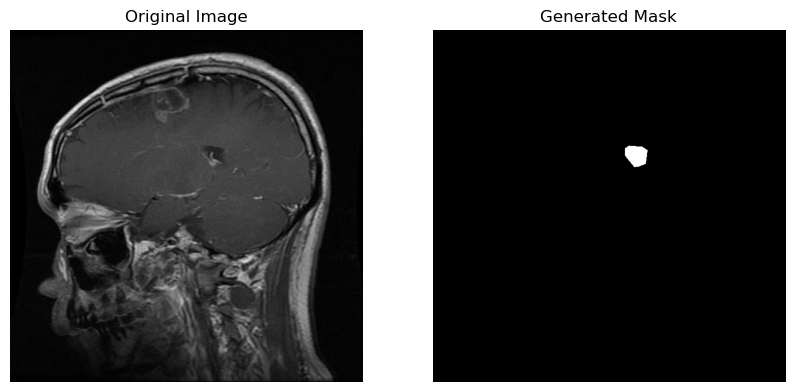

Loaded polygons for glioma7_jpg.rf.7a5656b6d095ce5846385f11f6b94046.txt: [[(0.6318359375, 0.630859375), (0.623046875, 0.6318359375), (0.62890625, 0.6435546875), (0.6201171875, 0.65234375), (0.6005859375, 0.65234375), (0.587890625, 0.6689453125), (0.59375, 0.7021484375), (0.5859375, 0.7333984375), (0.6083984375, 0.748046875), (0.626953125, 0.7490234375), (0.6904296875, 0.712890625), (0.697265625, 0.7001953125), (0.681640625, 0.6591796875), (0.6318359375, 0.630859375)]]
Drawing polygon: [(404, 403), (398, 404), (402, 411), (396, 417), (384, 417), (376, 428), (380, 449), (375, 469), (389, 478), (401, 479), (441, 456), (446, 448), (436, 421), (404, 403)]


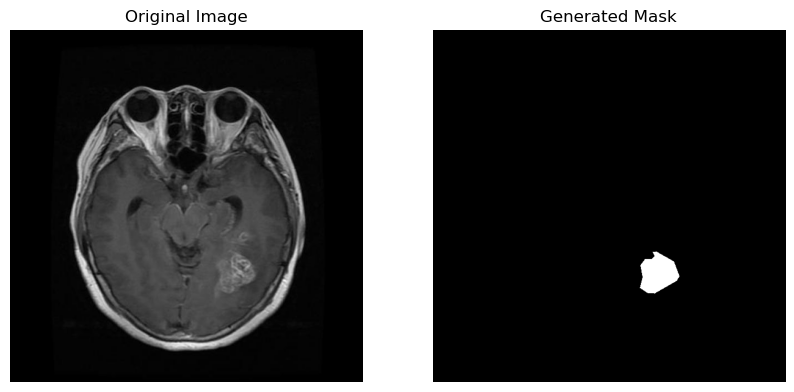

Loaded polygons for meningioma1_jpg.rf.78a67cc6008a8b1fcd33dc5593cb4961.txt: [[(0.684792784375, 0.3203124984375), (0.6389405734375, 0.3378906265625), (0.61402089375, 0.3740234375), (0.5940851515625, 0.4423828109375), (0.596078725, 0.4853515625), (0.6100337453125, 0.5107421890625), (0.65488916875, 0.544921875), (0.7356289296875, 0.5634765625), (0.7924457984375, 0.5410156265625), (0.7934425859375, 0.5263671890625), (0.7396160765625, 0.3271484375), (0.684792784375, 0.3203124984375)]]
Drawing polygon: [(438, 204), (408, 216), (392, 239), (380, 283), (381, 310), (390, 326), (419, 348), (470, 360), (507, 346), (507, 336), (473, 209), (438, 204)]


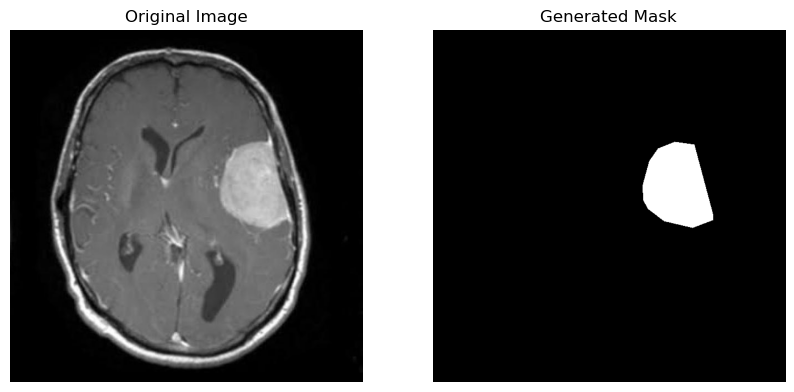

Loaded polygons for meningioma30_jpg.rf.a6d3c265ffd88a6714273ebedf11f28e.txt: [[(0.5221318875, 0.5725247171875), (0.5672990046875, 0.43677143437500004), (0.574525746875, 0.29216467343749997), (0.5004516734375, 0.3187251), (0.44986449687499996, 0.277408884375), (0.398165965625, 0.275390625), (0.3312071265625, 0.2382812515625), (0.29294493125, 0.2636718765625), (0.27142244843749996, 0.25), (0.2642482828125, 0.2636718765625), (0.24272580000000002, 0.2539062515625), (0.237943025, 0.2695312515625), (0.24028906874999997, 0.2700309875), (0.24028906874999997, 0.355614578125), (0.1291349078125, 0.4130859359375), (0.23196455624999998, 0.4638671875), (0.261856896875, 0.5585937484375), (0.3909918046875, 0.578125), (0.3974706390625, 0.6241699875), (0.40294874218750004, 0.578125), (0.4459937125, 0.587890625), (0.477081746875, 0.5449218765625), (0.5221318875, 0.5725247171875)]]
Drawing polygon: [(334, 366), (363, 279), (367, 186), (320, 203), (287, 177), (254, 176), (211, 152), (187, 168), (173, 160)

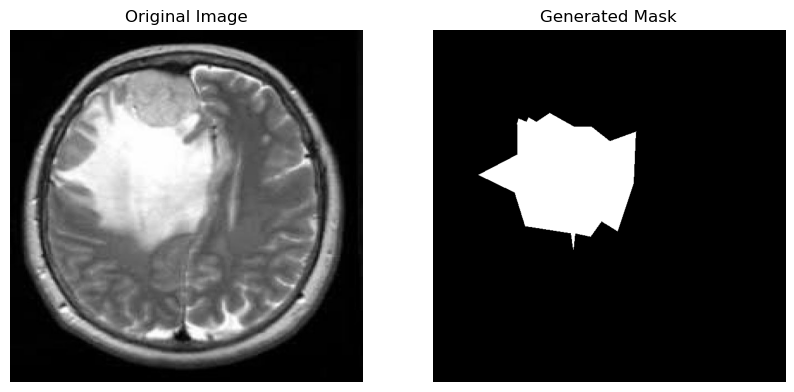

Loaded polygons for meningioma36_jpg.rf.acadc0b55106ed4d4e9f17c075e496d4.txt: [[(0.66015625, 0.17175632968750001), (0.673828125, 0.1409018984375), (0.6650390625, 0.12547468281250002), (0.6279296875, 0.1151898734375), (0.4638671875, 0.12136075937499999), (0.376953125, 0.15941455625), (0.4306640625, 0.232436709375), (0.4912109375, 0.27151898750000003), (0.5390625, 0.27254746875), (0.5810546875, 0.257120253125), (0.599609375, 0.231408228125), (0.607421875, 0.1964398734375), (0.66015625, 0.17175632968750001)]]
Drawing polygon: [(422, 109), (431, 90), (425, 80), (401, 73), (296, 77), (241, 102), (275, 148), (314, 173), (345, 174), (371, 164), (383, 148), (388, 125), (422, 109)]


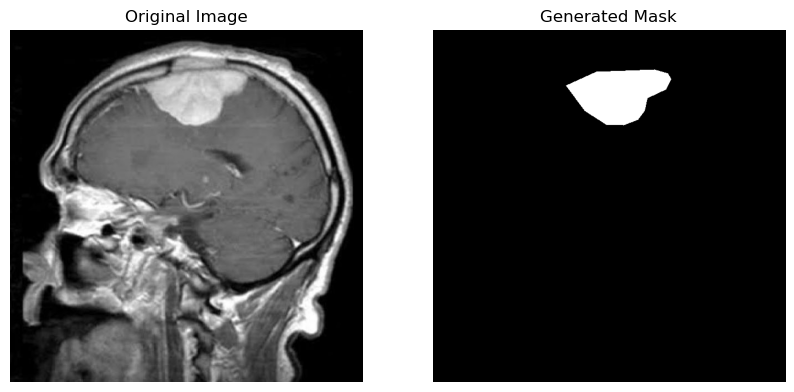

Loaded polygons for meningioma49_jpg.rf.2613e5acc1302d33552bb11db41f103d.txt: [[(0.666870115625, 0.10742187343750001), (0.58776855625, 0.10742187343750001), (0.509765625, 0.1728515625), (0.5009765609375, 0.2119140609375), (0.5504150390625, 0.2949218734375), (0.6635742203125, 0.3193359390625), (0.7778320296875, 0.2412109390625), (0.7646484390625, 0.1865234375), (0.719604490625, 0.1328124984375), (0.666870115625, 0.10742187343750001)]]
Drawing polygon: [(426, 68), (376, 68), (326, 110), (320, 135), (352, 188), (424, 204), (497, 154), (489, 119), (460, 84), (426, 68)]


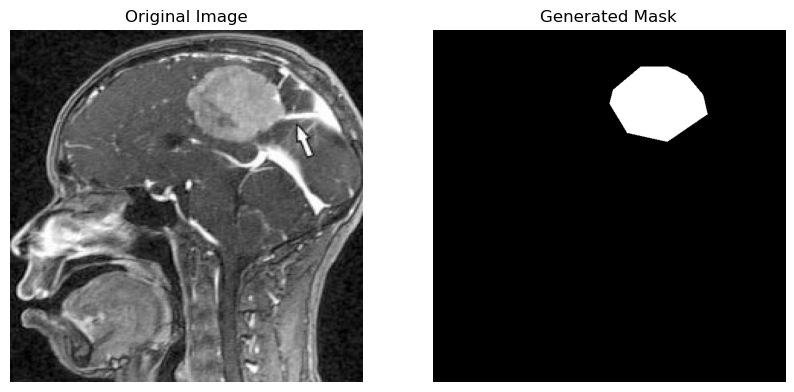

Loaded polygons for meningioma8_jpg.rf.2b857d06b934098cdea86fbb41242fd2.txt: [[(0.6229638234375, 0.5234375015625), (0.6348400843750001, 0.4990234375), (0.6369994046875, 0.4228515625), (0.60352994375, 0.39453125), (0.5387503437500001, 0.38671875), (0.534431703125, 0.37890625), (0.4815283640625, 0.4052734375), (0.45993516406249996, 0.4853515625), (0.47936904374999995, 0.6064453125), (0.5052808828125, 0.6416015625), (0.5581842234375001, 0.63671875), (0.5743791234375, 0.6240234375), (0.6002909640625, 0.5244140640625), (0.6229638234375, 0.5234375015625)]]
Drawing polygon: [(398, 335), (406, 319), (407, 270), (386, 252), (344, 247), (342, 242), (308, 259), (294, 310), (306, 388), (323, 410), (357, 407), (367, 399), (384, 335), (398, 335)]


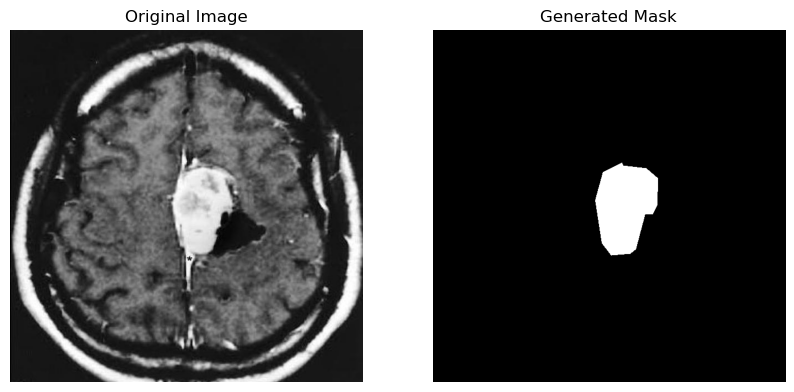

Loaded polygons for pituitary40_jpg.rf.edcd1f95576f4980c7b5f4dc7350355b.txt: [[(0.41031390156249997, 0.496932515625), (0.40881913281250004, 0.5084355828125), (0.4200298953125, 0.5276073625000001), (0.425261584375, 0.5521472390625), (0.41704035937499995, 0.5927914109375), (0.4200298953125, 0.61119631875), (0.4312406578125, 0.6273006140625), (0.4947683109375, 0.6618098156250001), (0.5074738421875, 0.6633435578125), (0.5605381171875, 0.6510736203125), (0.5687593421875, 0.6449386500000001), (0.5702541109375, 0.621932515625), (0.57698056875, 0.6065950921875001), (0.57698056875, 0.5835889578125), (0.5672645734375, 0.5598159515625001), (0.5747384156249999, 0.5145705515625), (0.5724962625, 0.4946319015625), (0.55156950625, 0.470092025), (0.5306427499999999, 0.45858895781250003), (0.5142002984375, 0.45475460156249997), (0.4820627796875, 0.4539877296875), (0.45964125625, 0.45858895781250003), (0.4439461890625, 0.465490796875), (0.41031390156249997, 0.496932515625)]]
Drawing polygon: [(262, 318),

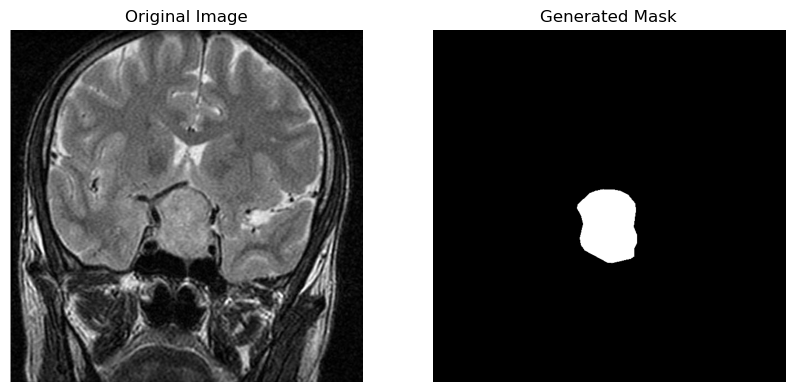

Image test volume shape: (15, 640, 640, 3)
Mask test volume shape: (15, 640, 640)
Test dataset prepared.


In [90]:
#Here I'm loading the test data. 

# Paths
labels_folder = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/test/labels"
images_folder = "/Users/ofrioren/GIT/Capstone III/brain_tumor_dataset/brain_tumor_segmentation/test/images"

# Initialize arrays for images and masks
volume_test_images = []
volume_test_masks = []

def create_mask_from_polygons(polygons, img_width, img_height):
    """Create a binary mask from normalized polygon coordinates."""
    # Create a blank black image
    mask = Image.new('L', (img_width, img_height), 0)  
    draw = ImageDraw.Draw(mask)
    
    for polygon in polygons:
        if not polygon:
            print("Empty polygon detected, skipping.")
            continue
        
        # Scale the normalized coordinates to image dimensions
        scaled_polygon = [(int(x * img_width), int(y * img_height)) for x, y in polygon]
        print(f"Drawing polygon: {scaled_polygon}")  # Debug scaled polygon coordinates
        draw.polygon(scaled_polygon, outline=1, fill=1)  # Draw precise polygons
    
    # Convert to a binary NumPy array
    return np.array(mask, dtype=np.uint8)

# Iterate through label files
for label_file in sorted(os.listdir(labels_folder)):
    if label_file.endswith('.txt'):  # Check for label files
        # Load polygons and labels
        label_path = os.path.join(labels_folder, label_file)
        polygons, _ = load_polygon_from_file(label_path)  # Ensure this function is correct
        
        # Debug polygons
        print(f"Loaded polygons for {label_file}: {polygons}")
        
        # Find the corresponding image file
        image_file = label_file.replace('.txt', '.jpg')  # Adjust extension as needed
        image_path = os.path.join(images_folder, image_file)
        
        if os.path.exists(image_path):
            # Load the image
            img = Image.open(image_path)
            img_width, img_height = img.size
            img_array = np.array(img)
            
            # Create a precise mask from the polygons
            mask_array = create_mask_from_polygons(polygons, img_width, img_height)
            
            # Add image and mask to volumes
            volume_test_images.append(img_array)
            volume_test_masks.append(mask_array)
            
            # Visualize the image and mask in the notebook
            plt.figure(figsize=(10, 5))
            
            plt.subplot(1, 2, 1)
            plt.imshow(img_array)
            plt.title("Original Image")
            plt.axis("off")
            
            plt.subplot(1, 2, 2)
            plt.imshow(mask_array, cmap="gray")
            plt.title("Generated Mask")
            plt.axis("off")
            
            plt.show()
        else:
            print(f"Image not found for label file: {label_file}")

# Convert to NumPy arrays
if volume_test_images and volume_test_masks:
    volume_test_images = np.stack(volume_test_images)  # Shape: (num_images, height, width, channels)
    volume_test_masks = np.stack(volume_test_masks)    # Shape: (num_images, height, width)

    # Normalize images and masks
    volume_test_images = volume_test_images / 255.0  # Scale images to [0, 1]
    volume_test_masks = volume_test_masks.astype('float32')  # Ensure masks are float32

    print(f"Image test volume shape: {volume_test_images.shape}")
    print(f"Mask test volume shape: {volume_test_masks.shape}")
else:
    print("No valid images or masks were created.")

print("Test dataset prepared.")

In [92]:
# Function to resize images and masks
def resize_images_and_masks(volume_test_images, volume_test_masks, target_size=(256, 256)):
    resized_images = []
    resized_masks = []
    
    for i, (img, mask) in enumerate(zip(volume_test_images, volume_test_masks)):
        # Check if the mask is empty (all zeros)
        if np.all(mask == 0):
            print(f"Warning: Mask {i} is empty (all zeros). This may lead to a black output after resizing.")
        
        # Resize the image
        img_resized = cv2.resize(img, target_size)
        resized_images.append(img_resized)
        
        # Resize the mask (use nearest neighbor for segmentation masks to preserve label values)
        mask_resized = cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)
        resized_masks.append(mask_resized)
    
    return np.array(resized_images), np.array(resized_masks)

# Example usage for resizing test data and masks
test_data_resized, test_masks_resized = resize_images_and_masks(volume_test_images, volume_test_masks, target_size=(256, 256))

# Check the shape after resizing
print(f"Shape of resized test_data: {test_data_resized.shape}")
print(f"Shape of resized test_masks: {test_masks_resized.shape}")


Shape of resized test_data: (15, 256, 256, 3)
Shape of resized test_masks: (15, 256, 256)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 780ms/step
Shape of predictions: (15, 256, 256, 1)
Shape of predicted masks: (15, 256, 256)


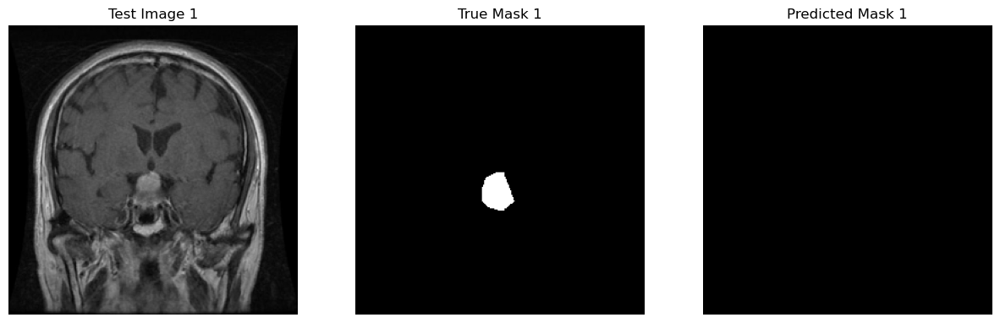

In [94]:
#I'm going to predict masks based on the test set.

# Predict the output for resized test data (segmentation)
predictions = model.predict(test_data_resized)  # Use resized test data here

# Check the shape of the predictions
print(f"Shape of predictions: {predictions.shape}")

#Reduce noise with post-processing
# Ensure predicted masks are in the correct format
predicted_masks = np.squeeze(predictions, axis=-1)  # Remove last dimension if it's (num_samples, H, W, 1)

# Reduce noise with post-processing
kernel = np.ones((3, 3), np.uint8)

# Apply post-processing per image
processed_masks = np.array([cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel) for mask in predicted_masks])
processed_masks = np.array([cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel) for mask in processed_masks])

# Now, use processed_masks instead of predicted_masks
predicted_masks = processed_masks


# Predictions will have shape (num_samples, height, width, num_classes)
# Convert predictions to the class with the highest probability for each pixel
predicted_masks = np.argmax(predictions, axis=-1)  # Choose the class with the highest probability per pixel
processed_masks = (processed_masks > 0.45).astype(np.uint8)  #OPTIMAL THRESHOLD

# Check the shape of predicted masks
print(f"Shape of predicted masks: {processed_masks.shape}")

# Now, predicted_masks will be the predicted class labels for each pixel in each image
# The shape will be (num_samples, height, width), with each pixel in the mask showing the class id

# Example of how to compare a few predicted masks to the ground truth
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Display the first image and its true mask and predicted mask
axes[0].imshow(test_data_resized[0])
axes[0].set_title('Test Image 1')
axes[1].imshow(test_masks_resized[0], cmap='gray')
axes[1].set_title('True Mask 1')
axes[2].imshow(processed_masks[0], cmap='gray')
axes[2].set_title('Predicted Mask 1')

for ax in axes:
    ax.axis('off')

plt.show()


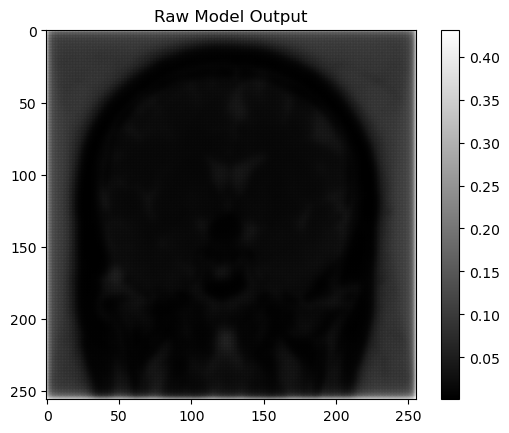

In [96]:
plt.imshow(predictions[0, :, :, 0], cmap="gray")
plt.title("Raw Model Output")
plt.colorbar()
plt.show()


In [98]:
# Predict using the resized test data (256x256)
predictions = model.predict(test_data_resized)  # Expect shape: (15, 256, 256, 1)
print(f"Shape of predictions: {predictions.shape}")

# Remove the extra channel if needed
predictions = np.squeeze(predictions, axis=-1)
# Apply threshold
threshold = 0.45  # Optimal threshold
binary_predicted_masks = (predictions > threshold).astype(np.uint8)

# Convert ground truth masks to binary: values 0 and 1 (assuming 128 as cutoff)
binary_test_masks = (test_masks_resized > 128).astype(np.uint8)
print(f"Shape of binary_test_masks: {binary_test_masks.shape}")

# Compute pixel-wise accuracy
correct_pixels = np.sum(binary_predicted_masks == binary_test_masks)
total_pixels = np.prod(binary_test_masks.shape)
pixel_accuracy = correct_pixels / total_pixels * 100
print(f"Pixel-wise accuracy: {pixel_accuracy:.2f}%")


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 751ms/step
Shape of predictions: (15, 256, 256, 1)
Shape of binary_test_masks: (15, 256, 256)
Pixel-wise accuracy: 100.00%


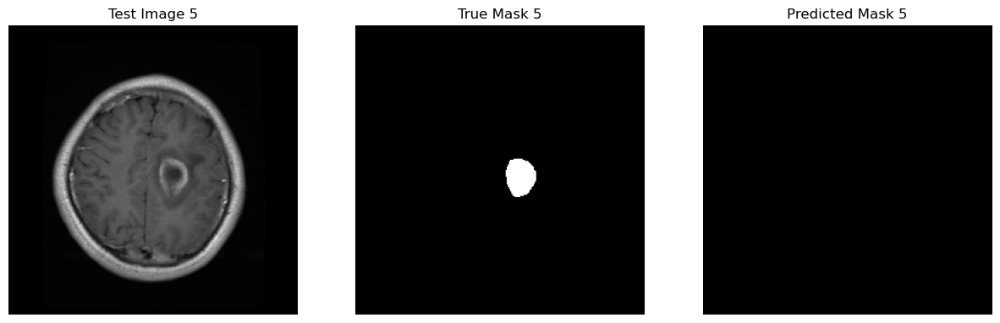

In [100]:
# Now, predicted_masks will be the predicted class labels for each pixel in each image
# The shape will be (num_samples, height, width), with each pixel in the mask showing the class id

# Example of how to compare a few predicted masks to the ground truth
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Display the first image and its true mask and predicted mask
axes[0].imshow(test_data_resized[4])
axes[0].set_title('Test Image 5')
axes[1].imshow(test_masks_resized[4], cmap='gray')
axes[1].set_title('True Mask 5')
axes[2].imshow(processed_masks[4], cmap='gray')
axes[2].set_title('Predicted Mask 5')

for ax in axes:
    ax.axis('off')

plt.show()

In [106]:

# Ensure true_mask is single-channel
def preprocess_mask(mask):
    if mask.ndim == 3:  # If mask has 3 channels (RGB), convert to grayscale
        mask = (mask * 255).astype(np.uint8) if mask.dtype == np.float64 else mask.astype(np.uint8)
        mask = cv2.cvtColor(mask, cv2.COLOR_RGB2GRAY)
    return mask.astype(np.uint8)  # Ensure the final mask is uint8

# Modified IoU calculation function
def calculate_iou(pred_mask, true_mask, num_classes=4):
    pred_mask = preprocess_mask(pred_mask)
    true_mask = preprocess_mask(true_mask)

    ious = []
    for i in range(num_classes):
        intersection = np.sum((pred_mask == i) & (true_mask == i))
        union = np.sum((pred_mask == i) | (true_mask == i))
        iou = intersection / union if union != 0 else 0
        ious.append(iou)

    return ious

# Ensure test_data_resized masks are also single-channel before computing IoU
test_data_resized = [preprocess_mask(mask) for mask in test_data_resized]

# Example: Calculate IoU for all test samples
ious = [calculate_iou(pred_mask, true_mask) for pred_mask, true_mask in zip(predicted_masks, test_data_resized)]

# Calculate average IoU
mean_iou = np.mean(ious)
print(f"Mean IoU: {mean_iou:.2f}")


Mean IoU: 0.03


In [110]:
import cv2

def evaluate_threshold(threshold, true_masks, pred_probs):
    # Resize predictions if necessary
    if true_masks.shape != pred_probs.shape:
        pred_probs = cv2.resize(pred_probs, (true_masks.shape[2], true_masks.shape[1]), interpolation=cv2.INTER_NEAREST)

    # Apply threshold and binarize predictions
    pred_bin = (pred_probs > threshold).astype(np.uint8)

    # Compute pixel-wise accuracy
    correct_pixels = np.sum(pred_bin == true_masks)
    total_pixels = np.prod(true_masks.shape)
    pixel_acc = correct_pixels / total_pixels

    # Compute IoU for binary segmentation
    intersection = np.sum((pred_bin == 1) & (true_masks == 1))
    union = np.sum((pred_bin == 1) | (true_masks == 1))
    iou = intersection / union if union != 0 else 0
    return pixel_acc, iou


# Assume test_masks_resized are your true masks (with values 0 and 1) 
# and predictions are your raw model outputs (before thresholding)
thresholds = np.linspace(0.45, 0.55, 11)  # Example thresholds between 0.45 and 0.55
results = []

for th in thresholds:
    acc, iou = evaluate_threshold(th, test_masks, predictions[..., 0])
    results.append({"Threshold": th, "Pixel Accuracy": acc, "IoU": iou})
    print(f"Threshold: {th:.3f} -> Pixel Accuracy: {acc:.3f}, IoU: {iou:.3f}")

# Pick the threshold that yields the best IoU
optimal_threshold = max(results, key=lambda x: x["IoU"])["Threshold"]
print("Optimal threshold:", optimal_threshold)

# Save results to CSV
csv_filename = "threshold_results.csv"

with open(csv_filename, mode="w", newline="") as file:
    writer = csv.DictWriter(file, fieldnames=["Threshold", "Pixel Accuracy", "IoU"])
    writer.writeheader()
    writer.writerows(results)

print(f"Threshold evaluation results saved to {csv_filename}")


Threshold: 0.450 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.460 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.470 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.480 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.490 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.500 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.510 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.520 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.530 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.540 -> Pixel Accuracy: 0.976, IoU: 0.000
Threshold: 0.550 -> Pixel Accuracy: 0.976, IoU: 0.000
Optimal threshold: 0.45
Threshold evaluation results saved to threshold_results.csv


In [112]:
#I'm going to try overfitting the model on a subset

import tensorflow.keras.backend as K

def focal_loss(y_true, y_pred, gamma=2, alpha=0.25):
    y_true = K.cast(y_true, tf.float32)
    y_pred = K.clip(y_pred, K.epsilon(), 1 - K.epsilon())
    loss = -alpha * (1 - y_pred)**gamma * y_true * K.log(y_pred) \
           - (1 - alpha) * y_pred**gamma * (1 - y_true) * K.log(1 - y_pred)
    return K.mean(loss)

model.compile(optimizer='adam', loss=focal_loss, metrics=['accuracy'])

# Ensure the mask values are in the correct range
volume_masks[volume_masks == 255] = 0  # Fix any out-of-bounds label values

training = model.fit(volume_images, volume_masks, epochs=1, validation_split=0.2)


16/16 ━━━━━━━━━━━━━━━━━━━━ 112s 7s/step - accuracy: 0.9998 - loss: 0.0245 - val_accuracy: 0.9998 - val_loss: 0.0116


In [114]:
# Function to resize images and masks
def resize_images_and_masks(volume_test_images, volume_test_masks, target_size=(256, 256)):
    resized_images = []
    resized_masks = []
    
    for i, (img, mask) in enumerate(zip(volume_test_images, volume_test_masks)):
        # Check if the mask is empty (all zeros)
        if np.all(mask == 0):
            print(f"Warning: Mask {i} is empty (all zeros). This may lead to a black output after resizing.")
        
        # Resize the image
        img_resized = cv2.resize(img, target_size)
        resized_images.append(img_resized)
        
        # Resize the mask (use nearest neighbor for segmentation masks to preserve label values)
        mask_resized = cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)
        resized_masks.append(mask_resized)
    
    return np.array(resized_images), np.array(resized_masks)

# Example usage for resizing test data and masks
test_data_resized, test_masks_resized = resize_images_and_masks(volume_test_images, volume_test_masks, target_size=(256, 256))

# Check the shape after resizing
print(f"Shape of resized test_data: {test_data_resized.shape}")
print(f"Shape of resized test_masks: {test_masks_resized.shape}")


Shape of resized test_data: (15, 256, 256, 3)
Shape of resized test_masks: (15, 256, 256)


New predictions shape: (15, 256, 256, 1)


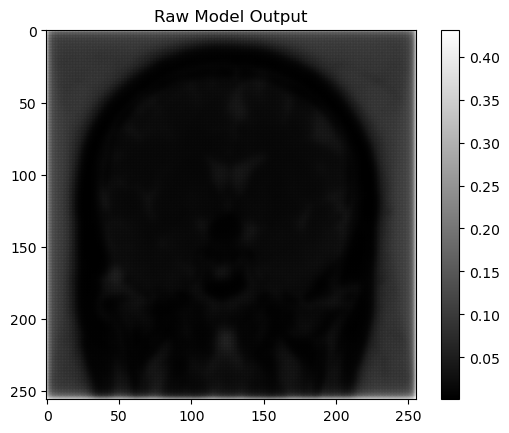

In [116]:
# If needed, add an extra dimension to the predictions
predictions = np.expand_dims(predictions, axis=-1)
print("New predictions shape:", predictions.shape)
plt.imshow(predictions[0, :, :, 0], cmap="gray")
plt.title("Raw Model Output")
plt.colorbar()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 767ms/step
Shape of predictions: (15, 256, 256, 1)
Shape of predicted masks: (15, 256, 256)


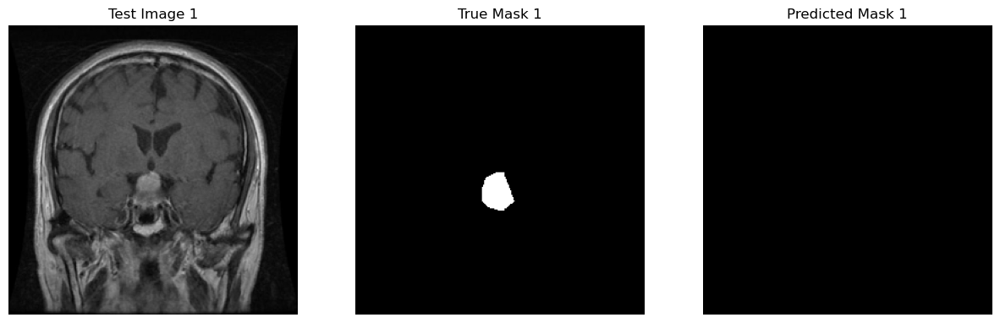

In [118]:
#post processing

#I'm going to predict masks based on the test set.

# Predict the output for resized test data (segmentation)
predictions = model.predict(test_data_resized)  # Use resized test data here

# Check the shape of the predictions
print(f"Shape of predictions: {predictions.shape}")

#Reduce noise with post-processing
# Ensure predicted masks are in the correct format
predicted_masks = np.squeeze(predictions, axis=-1)  # Remove last dimension if it's (num_samples, H, W, 1)

# Reduce noise with post-processing
kernel = np.ones((3, 3), np.uint8)

# Apply post-processing per image
processed_masks = np.array([cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel) for mask in predicted_masks])
processed_masks = np.array([cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel) for mask in processed_masks])

# Now, use processed_masks instead of predicted_masks
predicted_masks = processed_masks


# Predictions will have shape (num_samples, height, width, num_classes)
# Convert predictions to the class with the highest probability for each pixel
#predicted_masks = np.argmax(predictions, axis=-1)  # Choose the class with the highest probability per pixel
processed_masks = (processed_masks > 0.45).astype(np.uint8)

# Check the shape of predicted masks
print(f"Shape of predicted masks: {processed_masks.shape}")

# Now, predicted_masks will be the predicted class labels for each pixel in each image
# The shape will be (num_samples, height, width), with each pixel in the mask showing the class id

# Example of how to compare a few predicted masks to the ground truth
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Display the first image and its true mask and predicted mask
axes[0].imshow(test_data_resized[0])
axes[0].set_title('Test Image 1')
axes[1].imshow(test_masks_resized[0], cmap='gray')
axes[1].set_title('True Mask 1')
axes[2].imshow(processed_masks[0], cmap='gray')
axes[2].set_title('Predicted Mask 1')

for ax in axes:
    ax.axis('off')

plt.show()


In [120]:
# Predict using the resized test data (256x256)
predictions = model.predict(test_data_resized)  # Expect shape: (15, 256, 256, 1)
print(f"Shape of predictions: {predictions.shape}")

# Remove the extra channel if needed
predictions = np.squeeze(predictions, axis=-1)
# Apply threshold
threshold = 0.45  # Optimal threshold
binary_predicted_masks = (predictions > threshold).astype(np.uint8)

# Convert ground truth masks to binary: values 0 and 1 (assuming 128 as cutoff)
binary_test_masks = (test_masks_resized > 128).astype(np.uint8)
print(f"Shape of binary_test_masks: {binary_test_masks.shape}")

#Normalize test masks and print range of values
binary_test_masks = (test_masks_resized / 255).astype(np.uint8)  # Normalize if needed
print(f"Prediction range: min={predictions.min()}, max={predictions.max()}")

# Compute pixel-wise accuracy
correct_pixels = np.sum(binary_predicted_masks == binary_test_masks)
total_pixels = np.prod(binary_test_masks.shape)
pixel_accuracy = correct_pixels / total_pixels * 100
print(f"Pixel-wise accuracy: {pixel_accuracy:.2f}%")


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 715ms/step
Shape of predictions: (15, 256, 256, 1)
Shape of binary_test_masks: (15, 256, 256)
Prediction range: min=0.05852169543504715, max=0.4114344120025635
Pixel-wise accuracy: 100.00%


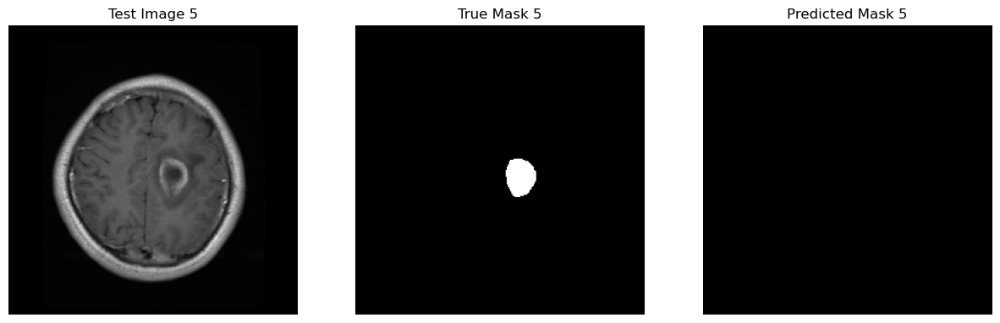

In [122]:
# Now, predicted_masks will be the predicted class labels for each pixel in each image
# The shape will be (num_samples, height, width), with each pixel in the mask showing the class id

# Example of how to compare a few predicted masks to the ground truth
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Display the first image and its true mask and predicted mask
axes[0].imshow(test_data_resized[4])
axes[0].set_title('Test Image 5')
axes[1].imshow(test_masks_resized[4], cmap='gray')
axes[1].set_title('True Mask 5')
axes[2].imshow(processed_masks[4], cmap='gray')
axes[2].set_title('Predicted Mask 5')

for ax in axes:
    ax.axis('off')

plt.show()

In [124]:
idx = np.random.randint(0, len(test_data_resized))
single_image = test_data_resized[idx:idx+1]
single_mask = test_masks_resized[idx:idx+1]

model.fit(single_image, single_mask, epochs=50)



Epoch 1/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 275ms/step - accuracy: 0.9892 - loss: 0.0058
Epoch 2/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step - accuracy: 0.9892 - loss: 0.0054
Epoch 3/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step - accuracy: 0.9892 - loss: 0.0050
Epoch 4/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step - accuracy: 0.9892 - loss: 0.0047
Epoch 5/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step - accuracy: 0.9892 - loss: 0.0046
Epoch 6/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - accuracy: 0.9892 - loss: 0.0047
Epoch 7/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step - accuracy: 0.9892 - loss: 0.0049
Epoch 8/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - accuracy: 0.9892 - loss: 0.0049
Epoch 9/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - accuracy: 0.9892 - loss: 0.0049
Epoch 10/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - accuracy: 0.9892 - loss: 0.0048
Epoch 11/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step - accuracy: 0.9892 - loss: 0.0046
Epoch 12/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step - accuracy: 0.9892 - lo

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step


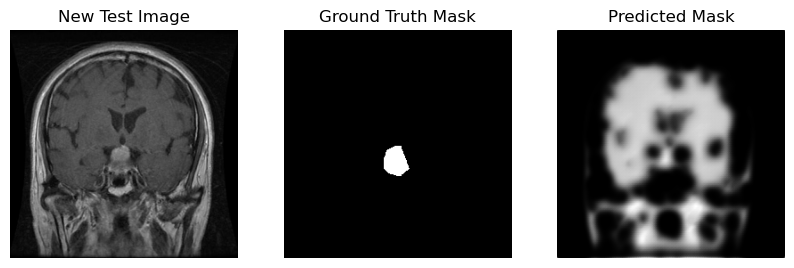

In [126]:
new_image = test_data_resized[0:1]  # Pick a test image
new_mask = test_masks_resized[0:1]  # Ground truth for comparison

predicted_new_mask = model.predict(new_image)

plt.figure(figsize=(10, 5))

plt.subplot(1, 3, 1)
plt.imshow(new_image[0])
plt.title("New Test Image")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(new_mask[0], cmap="gray")
plt.title("Ground Truth Mask")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(predicted_new_mask[0, :, :, 0], cmap="gray")
plt.title("Predicted Mask")
plt.axis("off")

plt.show()


In [134]:
history = model.fit(test_data_resized, test_masks_resized, epochs=50, batch_size=16)


Epoch 1/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step - accuracy: 0.9836 - loss: 0.0055
Epoch 2/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9827 - loss: 0.0056
Epoch 3/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9846 - loss: 0.0057
Epoch 4/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9831 - loss: 0.0056
Epoch 5/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9838 - loss: 0.0054
Epoch 6/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9846 - loss: 0.0056
Epoch 7/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9823 - loss: 0.0055
Epoch 8/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9845 - loss: 0.0053
Epoch 9/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9846 - loss: 0.0054
Epoch 10/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9837 - loss: 0.0053
Epoch 11/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9837 - loss: 0.0052
Epoch 12/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9841 - loss: 0.0053
Epoch 13/50
1/1 ━━━━━━━━━

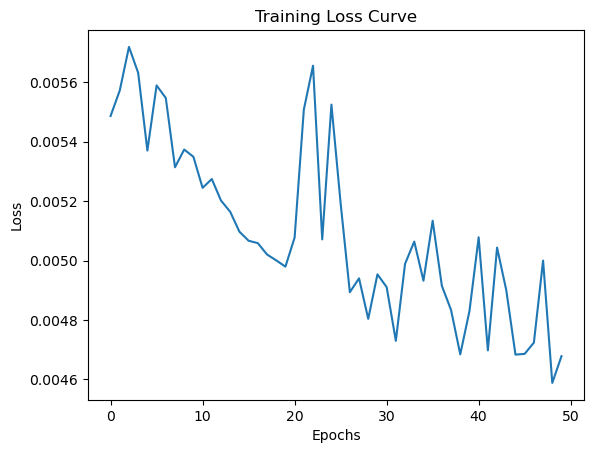

In [136]:
plt.plot(history.history['loss'])
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss Curve')
plt.show()

In [33]:
#I have a model, but it isn't very good. I'll try to see what I can do with more images. 

In [209]:
#!pip install --upgrade kagglehub
import kagglehub

# Download latest version
path = kagglehub.dataset_download("jakeshbohaju/brain-tumor")

print("Path to dataset files:", path)

Path to dataset files: /Users/ofrioren/.cache/kagglehub/datasets/jakeshbohaju/brain-tumor/versions/3


Loaded image volume shape: (3762, 240, 240, 3)


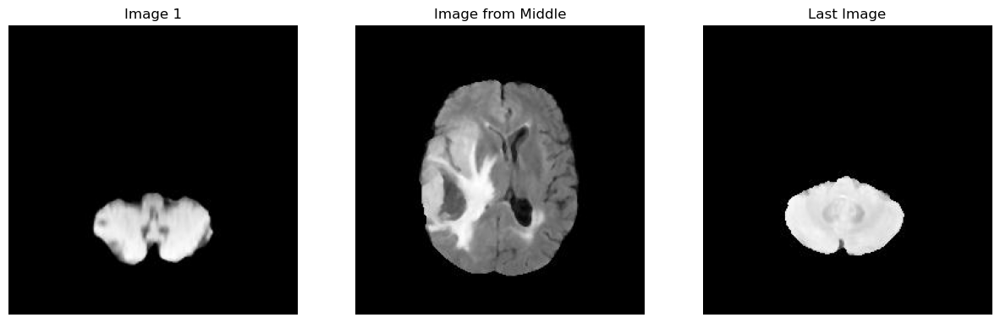

In [211]:
# Path to the folder containing the images
folder_path_images = "/Users/ofrioren/.cache/kagglehub/datasets/jakeshbohaju/brain-tumor/versions/3/Brain Tumor/Brain Tumor"

# Initialize a list to store image data
new_volume_train_images = []

# Iterate through the files in the folder
for filename in sorted(os.listdir(folder_path_images)):  # Sort to maintain order
    if filename.endswith(('.jpg', '.jpeg', '.png', '.bmp')):  # Check for valid image files
        filepath_image = os.path.join(folder_path_images, filename)
        try:

            # Open the image using PIL
            img = Image.open(filepath_image).convert('RGB')  # Ensure all images are RGB
            img_array = np.array(img)  # Convert the image to a NumPy array
            new_volume_train_images.append(img_array)  # Append the image to the list
        except Exception as e:
            print(f"Error loading image {filepath_image}: {e}")

# Check if any images were loaded
if new_volume_train_images:
    # Convert the list of images into a NumPy array (volume)
    try:
        new_volume_train_images = np.stack(new_volume_train_images)
        print(f"Loaded image volume shape: {new_volume_train_images.shape}")  # Expected shape: (number_of_images, height, width, channels)
    except ValueError as e:
        print(f"Error stacking images into volume: {e}")

    # Display a few images to confirm successful loading
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    if len(new_volume_train_images) >= 3:
        axes[0].imshow(new_volume_train_images[0])
        axes[0].set_title('Image 1')
        axes[1].imshow(new_volume_train_images[len(new_volume_train_images) // 2])
        axes[1].set_title('Image from Middle')
        axes[2].imshow(new_volume_train_images[-1])
        axes[2].set_title('Last Image')
        for ax in axes:
            ax.axis('off')
        plt.show()
    else:
        print("Not enough images to display.")
else:
    print("No images were loaded. Please check the file path and extensions.")

In [213]:
#Great! I now have 3762 more images to use but unfortunately they do not have masks to identify the location of the tumor
#only a separate csv file that identifies them as having or not having a tumor. I will try to do semi-supervised learning.

In [43]:
import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Conv2DTranspose
from sklearn.metrics import accuracy_score
import random

model = Sequential([
    # Encoding layers
    Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),

    # Bottleneck layer
    Conv2D(256, (3, 3), activation='relu'),

    # Decoding layers (up-sampling)
    Conv2DTranspose(128, (3, 3), strides=(2, 2), activation='relu'),
    Conv2DTranspose(64, (3, 3), strides=(2, 2), activation='relu'),
    Conv2DTranspose(32, (3, 3), strides=(2, 2), activation='relu'),

    # Output layer (1 class for binary segmentation, or more for multi-class)
    Conv2D(1, (1, 1), activation='sigmoid')  # Use 'softmax' for multi-class

])

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

model.summary()

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_11 (Conv2D)              │ (None, 254, 254, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 127, 127, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_12 (Conv2D)              │ (None, 125, 125, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 62, 62, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_13 (Conv2D)              │ (None, 60, 60, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 30, 30, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_14 (Conv2D)              │ (None, 28, 28, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 57, 57, 128)    │       295,040 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_3              │ (None, 115, 115, 64)   │        73,792 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_4              │ (None, 231, 231, 32)   │        18,464 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_15 (Conv2D)              │ (None, 231, 231, 1)    │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 775,745 (2.96 MB)

 Trainable params: 775,745 (2.96 MB)

 Non-trainable params: 0 (0.00 B)

In [217]:
from cv2 import resize
import numpy as np

# Step 1: Define your unlabeled data (replace this with your actual unlabeled data)
unlabeled_data_filtered = np.random.rand(100, 256, 256, 3)  # Example placeholder, use your real data

# Step 2: Predict pseudo-labels from the model
pseudo_labels = model.predict(unlabeled_data_filtered)  # Model prediction on unlabeled data
print(f"Pseudo labels shape: {pseudo_labels.shape}")  # Debugging info

# Step 3: Filter predictions based on confidence threshold
confident_mask = np.max(pseudo_labels, axis=-1) > 0.9  # Confidence thresholding (e.g., 90%)
print(f"Confidence mask sum: {np.sum(confident_mask)}")  # How many masks passed the threshold?

pseudo_labels_filtered = pseudo_labels[confident_mask]
print(f"Filtered pseudo labels shape: {pseudo_labels_filtered.shape}")  # Debugging info

# Step 4: Convert pseudo_labels_filtered to class indices (assuming it is one-hot encoded)
pseudo_labels_filtered_class = np.argmax(pseudo_labels_filtered, axis=-1)  # Convert to class indices

# Step 5: Resize all pseudo labels to match the target size
valid_masks = []

for i, mask in enumerate(pseudo_labels_filtered_class):
    if mask is not None:
        print(f"Mask {i} shape: {mask.shape}, ndim: {mask.ndim}")  # Debugging info
        if mask.ndim == 2:  # Ensure mask is 2D
            # Ensure the mask is in the correct dtype (uint8) for resizing
            if mask.dtype != np.uint8:
                mask = mask.astype(np.uint8)
            
            # Resize to match target size (256, 256)
            resized_mask = resize(mask, (256, 256))  # Resize using OpenCV
            valid_masks.append(resized_mask)
        else:
            print(f"Skipping mask {i} with incorrect ndim: {mask.ndim}")
    else:
        print(f"Skipping mask {i} because it's None")

# Step 6: Convert the list of resized masks to a NumPy array
if valid_masks:
    pseudo_labels_filtered_class_resized = np.array(valid_masks)
else:
    print("No valid masks found in pseudo_labels_filtered_class.")

# Step 7: Ensure that pseudo_labels_filtered_class_resized has the same shape as train_masks
if 'pseudo_labels_filtered_class_resized' in locals():  # Check if the variable is defined
    if pseudo_labels_filtered_class_resized.shape[1:] != train_masks.shape[1:]:
        # Resize pseudo_labels_filtered_class_resized to match train_masks dimensions
        pseudo_labels_filtered_class_resized = np.array([resize(mask, (train_masks.shape[1], train_masks.shape[2])) for mask in pseudo_labels_filtered_class_resized])

    # Step 8: Now concatenate the labeled data (train_data, train_masks) with the new train data
    new_train_data = np.concatenate([train_data, unlabeled_data_filtered])  # Concatenate images

    # Step 9: Concatenate the corresponding labels (train_masks and pseudo_labels_filtered_class_resized)
    new_train_labels = np.concatenate([train_masks, pseudo_labels_filtered_class_resized])  # Concatenate labels (as class indices)

    # Check the shape of the new combined dataset
    print(f"Shape of new_train_data: {new_train_data.shape}")
    print(f"Shape of new_train_labels: {new_train_labels.shape}")

    # Step 10: Retrain the model with the new dataset
    model.fit(new_train_data, new_train_labels, epochs=10)
else:
    print("Skipping model retraining as no valid pseudo labels were found.")


4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 1s/step
Pseudo labels shape: (100, 256, 256, 1)
Confidence mask sum: 0
Filtered pseudo labels shape: (0, 1)
No valid masks found in pseudo_labels_filtered_class.
Skipping model retraining as no valid pseudo labels were found.
